In [6]:
# import the necessary libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import textwrap

# import warnings module
import warnings
warnings.filterwarnings("ignore")

# **BUSINESS BACKGROUND**

A consumer finance company provides various types of loans to customers. The company needs to analyse the pattern in the application data & credit history of loan applicants to evaluate the loan approval and minimize the financial risks, including loss of not approving the loan to capable applicants and loss of approving the loan to highly default applicants.

The company's made decisions on each application classified into 4 types: Approved/ Cancelled / Refused / Unused offer, as well as defined the current applicants with the target variable: with/ without payment difficulties.

**PROBLEM STATEMENT I (Business Objectives)**

*  Identify driving factors behind the loan default and non-default. The pattern will help the company to understand and build appropriate models on the loan processing.

**PROBLEM STATEMENT II (Analysis Objectives)**

*   Identify the missing data and use appropriate method to deal with it.
*   Identify outliers to detect abnormalities
*   Identify data imbalance and find the ratio of data imbalance.
*   Explain the analysis results of univariate, segmented univariate, bivariate analysis, etc. in business terms.
*   Find the top 10 correlation for the Client with payment difficulties and all other cases (Target variable)
*   Visualisations and summarise the most important results

# **UNDERSTANDING THE DATA**

1. 'application_data.csv'  client information of the current application, including the client personal profile, loan application and importantly the "Target variable" indicating whether a client has payment difficulties.

2. 'previous_application.csv' client historical data of loan applications, including details of previous loan information. Each client may have many previous applications with different contracts types and status (Approved, Cancelled, Refused or Unused offer)

3. 'columns_description.csv' is dictionary of the column variables.

## **Loading the dataset**

In [8]:
#Read the application dataset in pandas from Google Drive
df_app = pd.read_csv('/Users/macbook/Desktop/SUVC/POST-GRAD/Assignment/application_data.csv')

In [22]:
#Read the previous dataset in pandas from Google Drive
df_prev_org = pd.read_csv('/Users/macbook/Desktop/SUVC/POST-GRAD/Assignment/previous_application.csv')

In [6]:
# Solve the decoding problem of columns_description file
# Detect the encoding of a CSV file with Chardet library
!pip install chardet
import chardet
with open('/Users/macbook/Desktop/SUVC/POST-GRAD/Assignment/columns_description.csv', 'rb') as f:
  encoding_result = chardet.detect(f.read())
# Read the columns_description file with the proper encoding type
columns_description = pd.read_csv('/Users/macbook/Desktop/SUVC/POST-GRAD/Assignment/columns_description.csv', encoding=encoding_result['encoding'])

## **Understanding the variable description**

In [ ]:
# Reading the columns_description dataset
columns_description.head()

In [ ]:
# Understanding the data of Table columns
columns_description.Table.value_counts()

In [ ]:
# Understanding the data of Special columns
columns_description.Special.value_counts()

In [ ]:
# Read description for the current application_data
!pip install tabulate
application_description=columns_description[columns_description.Table=='application_data'].drop(columns=['Unnamed: 0','Table'])
application_description.to_markdown(index=False)

In [ ]:
# Read description for the previous application dataset
previous_application_description=columns_description[columns_description.Table=='previous_application.csv'].drop(columns=['Unnamed: 0','Table'])
previous_application_description.to_markdown(index=False)

# **DATA QUALITY**
*   Checking the structure of the data
*   Identify the missing data and use appropriate method to deal with it.
*   Identify outliers and approaches to deal with them
*   Identify data imbalance and find the ratio of data imbalance



## **CURRENT APPLICATION DATASET**

### **Check data structure**

In [9]:
# How many current applicants in the application_data dataset?
df_app.shape

(307511, 122)

In [10]:
# There are 307511 applicants to evaluate with 122 data columns

In [11]:
# Reading the current application dataset by viewing the first 5 rows in full content
pd.set_option('display.max_columns', None) #Display all columns
pd.set_option('display.max_colwidth', None) #Display full content without truncating
df_app.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

### **Check Missing Values**

In [13]:
# Check the data columns of the application dataset
df_app.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 122 columns):
 #    Column                        Non-Null Count   Dtype  
---   ------                        --------------   -----  
 0    SK_ID_CURR                    307511 non-null  int64  
 1    TARGET                        307511 non-null  int64  
 2    NAME_CONTRACT_TYPE            307511 non-null  object 
 3    CODE_GENDER                   307511 non-null  object 
 4    FLAG_OWN_CAR                  307511 non-null  object 
 5    FLAG_OWN_REALTY               307511 non-null  object 
 6    CNT_CHILDREN                  307511 non-null  int64  
 7    AMT_INCOME_TOTAL              307511 non-null  float64
 8    AMT_CREDIT                    307511 non-null  float64
 9    AMT_ANNUITY                   307499 non-null  float64
 10   AMT_GOODS_PRICE               307233 non-null  float64
 11   NAME_TYPE_SUITE               306219 non-null  object 
 12   NAME_INCOME_TYPE            

In [14]:
# 122 columns, of which, many have missing values

In [15]:
# Calculate the percentage of missing values in columns of application data
pd.set_option('display.max_rows', None)
df_app_percent=df_app.isna().sum()/df_app.shape[0]*100
df_app_percent

SK_ID_CURR                       0.000000
TARGET                           0.000000
NAME_CONTRACT_TYPE               0.000000
CODE_GENDER                      0.000000
FLAG_OWN_CAR                     0.000000
FLAG_OWN_REALTY                  0.000000
CNT_CHILDREN                     0.000000
AMT_INCOME_TOTAL                 0.000000
AMT_CREDIT                       0.000000
AMT_ANNUITY                      0.003902
AMT_GOODS_PRICE                  0.090403
NAME_TYPE_SUITE                  0.420148
NAME_INCOME_TYPE                 0.000000
NAME_EDUCATION_TYPE              0.000000
NAME_FAMILY_STATUS               0.000000
NAME_HOUSING_TYPE                0.000000
REGION_POPULATION_RELATIVE       0.000000
DAYS_BIRTH                       0.000000
DAYS_EMPLOYED                    0.000000
DAYS_REGISTRATION                0.000000
DAYS_ID_PUBLISH                  0.000000
OWN_CAR_AGE                     65.990810
FLAG_MOBIL                       0.000000
FLAG_EMP_PHONE                   0

### **Missing Value Approach - EXT_SOURCE**

In [21]:
# EXT_SOURCE: Normalized credit score from 3 sources. Very important information
# However, each applicants may not have datas from all 3 sources avaiable -> Comparison with mean score of 3 sources, whichever avaiable
df_app['N_CREDITSCORE']=df_app[['EXT_SOURCE_1','EXT_SOURCE_2','EXT_SOURCE_3']].mean(axis=1)

In [24]:
# EXT_SOURCE: Check the remaining null values
df_app.N_CREDITSCORE.isna().sum()

172

In [28]:
# EXT_SOURCE: Drop the remaining 172 records without any credit scores and drop columns: 'EXT_SOURCE_1','EXT_SOURCE_2','EXT_SOURCE_3'
df_app.drop(columns=['EXT_SOURCE_1','EXT_SOURCE_2','EXT_SOURCE_3'], inplace=True)
df_app.dropna(subset=['N_CREDITSCORE'], inplace=True)

In [30]:
df_app.N_CREDITSCORE.isna().sum()

0

### **Missing Value Approach - CREDIT BUREAU**

In [33]:
# CREDIT_BUREAU -> Identify the total of enquiries to Credeit Bureau and the enquiries within last 3 months for analysis
df_app['N_TOTAL_CREDIT_BUREAU']=df_app[['AMT_REQ_CREDIT_BUREAU_HOUR','AMT_REQ_CREDIT_BUREAU_DAY',
              'AMT_REQ_CREDIT_BUREAU_WEEK','AMT_REQ_CREDIT_BUREAU_MON','AMT_REQ_CREDIT_BUREAU_QRT','AMT_REQ_CREDIT_BUREAU_YEAR']].sum(axis=1).astype(int)
df_app['N_3M_CREDIT_BUREAU']=df_app[['AMT_REQ_CREDIT_BUREAU_HOUR','AMT_REQ_CREDIT_BUREAU_DAY',
              'AMT_REQ_CREDIT_BUREAU_WEEK','AMT_REQ_CREDIT_BUREAU_MON','AMT_REQ_CREDIT_BUREAU_QRT']].sum(axis=1).astype(int)

In [35]:
# CREDIT_BUREAU --> Drop detailed columns 
df_app.drop(columns=['AMT_REQ_CREDIT_BUREAU_HOUR','AMT_REQ_CREDIT_BUREAU_DAY',
              'AMT_REQ_CREDIT_BUREAU_WEEK','AMT_REQ_CREDIT_BUREAU_MON','AMT_REQ_CREDIT_BUREAU_QRT','AMT_REQ_CREDIT_BUREAU_YEAR'], inplace=True)

### **Missing Values Approach - Variable with small missing percentage**

In [38]:
# NAME_TYPE_SUITE: Fill na values with mode 
df_app.NAME_TYPE_SUITE.fillna(df_app.NAME_TYPE_SUITE.mode()[0], inplace=True)
df_app.NAME_TYPE_SUITE.isna().sum()

0

In [40]:
# CNT_FAM_MEMBERS: Fill na values with mode
df_app["CNT_FAM_MEMBERS"].fillna(df_app["CNT_FAM_MEMBERS"].mode()[0], inplace=True)
df_app["CNT_FAM_MEMBERS"].isna().sum()

0

### **Missing Value Approach - Variable with signigicant missing percentage**

In [43]:
# Dropping the columns with more than 20% missing values
df_app=df_app.loc[:,df_app.isna().mean()<=.19]

In [45]:
# Dropping the columns with irrelevant data for administrative purposes, which is not useful to evaluate the applicant credit
  # Documentation submission records as:
    ## ['FLAG_DOCUMENT_2','FLAG_DOCUMENT_3','FLAG_DOCUMENT_4','FLAG_DOCUMENT_5','FLAG_DOCUMENT_6','FLAG_DOCUMENT_7','FLAG_DOCUMENT_8',
    ##  'FLAG_DOCUMENT_9','FLAG_DOCUMENT_10','FLAG_DOCUMENT_11','FLAG_DOCUMENT_12','FLAG_DOCUMENT_13','FLAG_DOCUMENT_14','FLAG_DOCUMENT_15','FLAG_DOCUMENT_16',
    ## 'FLAG_DOCUMENT_17','FLAG_DOCUMENT_18','FLAG_DOCUMENT_19','FLAG_DOCUMENT_20','FLAG_DOCUMENT_21']
admin_list=['FLAG_DOCUMENT_2','FLAG_DOCUMENT_3','FLAG_DOCUMENT_4','FLAG_DOCUMENT_5','FLAG_DOCUMENT_6','FLAG_DOCUMENT_7','FLAG_DOCUMENT_8','FLAG_DOCUMENT_9',
            'FLAG_DOCUMENT_10','FLAG_DOCUMENT_11','FLAG_DOCUMENT_12','FLAG_DOCUMENT_13','FLAG_DOCUMENT_14','FLAG_DOCUMENT_15','FLAG_DOCUMENT_16',
            'FLAG_DOCUMENT_17','FLAG_DOCUMENT_18','FLAG_DOCUMENT_19','FLAG_DOCUMENT_20','FLAG_DOCUMENT_21',
           'FLAG_MOBIL','FLAG_EMP_PHONE','FLAG_WORK_PHONE','FLAG_CONT_MOBILE','FLAG_PHONE','FLAG_EMAIL',
           'REGION_POPULATION_RELATIVE','DAYS_REGISTRATION','DAYS_ID_PUBLISH','REGION_RATING_CLIENT','REGION_RATING_CLIENT_W_CITY',
            'WEEKDAY_APPR_PROCESS_START','HOUR_APPR_PROCESS_START','REG_REGION_NOT_LIVE_REGION','REG_REGION_NOT_WORK_REGION',
           'LIVE_REGION_NOT_WORK_REGION','REG_CITY_NOT_LIVE_CITY','REG_CITY_NOT_WORK_CITY','LIVE_CITY_NOT_WORK_CITY','DAYS_LAST_PHONE_CHANGE']
for col in admin_list:
  df_app.drop(columns=col, inplace=True)
df_app.shape

(307339, 27)

In [46]:
# The dataset has remaning 27 columns

### **Check Categorial Data**

In [48]:
# Function to read the values of categorial data columns
def read_columns(df):
    for col in df.columns:
        if df[col].dtype == 'object':
            print(f'{col}: {df[col].value_counts()}')
            print('---'*10)

In [49]:
# Read the values of categorial data columns in application dataset
read_columns(df_app)

NAME_CONTRACT_TYPE: NAME_CONTRACT_TYPE
Cash loans         278080
Revolving loans     29259
Name: count, dtype: int64
------------------------------
CODE_GENDER: CODE_GENDER
F      202305
M      105030
XNA         4
Name: count, dtype: int64
------------------------------
FLAG_OWN_CAR: FLAG_OWN_CAR
N    202796
Y    104543
Name: count, dtype: int64
------------------------------
FLAG_OWN_REALTY: FLAG_OWN_REALTY
Y    213200
N     94139
Name: count, dtype: int64
------------------------------
NAME_TYPE_SUITE: NAME_TYPE_SUITE
Unaccompanied      249685
Family              40126
Spouse, partner     11362
Children             3265
Other_B              1766
Other_A               865
Group of people       270
Name: count, dtype: int64
------------------------------
NAME_INCOME_TYPE: NAME_INCOME_TYPE
Working                 158697
Commercial associate     71564
Pensioner                55330
State servant            21693
Unemployed                  22
Student                     18
Businessman  

### **XNA Values Approach 1**

In [51]:
# Function to replace missing value "XNA" with mode -> Catergorial datas with few "XNA"
def xna2mode(df,cols):
    for col in cols:
        if col in df.columns:
            df[col].replace({'XNA':df[col].mode()[0]}, inplace=True)
        else:
            print(f'The {col} cannot be found in the {df}')

In [52]:
# CODE_GENDER: Few missing value "XNA" safe to replace this data with mode value
# df_app.CODE_GENDER.replace({'XNA':df_app.CODE_GENDER.mode()[0]}, inplace=True)
xna2mode(df_app,['CODE_GENDER'])

In [56]:
df_app.CODE_GENDER.value_counts()

CODE_GENDER
F    202309
M    105030
Name: count, dtype: int64

### **XNA Values Approach 2**

In [62]:
# Function to replace missing value "XNA" with "Not specified" label -> Catergorial datas with significant "XNA"
def xna2label(df,cols):
    for col in cols:
        if col in df.columns:
            df[col].replace({'XNA':'Not Specified'}, inplace=True)
        else:
            print(f'The {col} cannot be found in the {df}')

In [64]:
df_app.ORGANIZATION_TYPE.value_counts(normalize=True)*100

ORGANIZATION_TYPE
Business Entity Type 3    22.107835
XNA                       18.006826
Self-employed             12.490442
Other                      5.426256
Medicine                   3.640931
Business Entity Type 2     3.432041
Government                 3.382259
School                     2.892246
Trade: type 7              2.546374
Kindergarten               2.238570
Construction               2.186185
Business Entity Type 1     1.945734
Transport: type 4          1.756367
Trade: type 3              1.134252
Industry: type 9           1.095858
Industry: type 3           1.065924
Security                   1.055837
Housing                    0.962455
Industry: type 11          0.879485
Military                   0.856709
Bank                       0.814736
Agriculture                0.798141
Police                     0.761049
Transport: type 2          0.717123
Postal                     0.701831
Security Ministries        0.641962
Trade: type 2              0.617234
Restaurant

In [66]:
# ORGANIZATION_TYPE: An significant number of "XNA" should be kept as "Not specified" 
xna2label(df_app,['ORGANIZATION_TYPE'])
# ORGANIZATION_TYPE: Grouping similar categories to reduce the too detailed breakdowns into many organization types:
df_app.loc[df_app.ORGANIZATION_TYPE.str.contains('Transport', na=False),'ORGANIZATION_TYPE']='Transport'
df_app.loc[df_app.ORGANIZATION_TYPE.str.contains('Industry', na=False),'ORGANIZATION_TYPE']='Industry'
df_app.loc[df_app.ORGANIZATION_TYPE.str.contains('Trade', na=False),'ORGANIZATION_TYPE']='Trade'
df_app.loc[df_app.ORGANIZATION_TYPE.str.contains('Business Entity', na=False),'ORGANIZATION_TYPE']='Business Entity'
# ORGANIZATION_TYPE: Grouping small categories with percentage < 1% together into a new label "OTHERS" to reduce the data convolution
org_count=df_app.ORGANIZATION_TYPE.value_counts(normalize=True)*100
df_app.ORGANIZATION_TYPE=df_app.ORGANIZATION_TYPE.apply(lambda x:'Others' if org_count[x]<1 else x)

In [67]:
df_app.ORGANIZATION_TYPE.value_counts(normalize=True)*100

ORGANIZATION_TYPE
Business Entity    27.485610
Not Specified      18.006826
Self-employed      12.490442
Others              8.962091
Other               5.426256
Industry            4.655446
Trade               4.652517
Medicine            3.640931
Government          3.382259
Transport           2.924783
School              2.892246
Kindergarten        2.238570
Construction        2.186185
Security            1.055837
Name: proportion, dtype: float64

### **Check Numerical Data - identify outliers**

In [71]:
# Checking the outliers of numerical datas
df_app.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,DAYS_BIRTH,DAYS_EMPLOYED,CNT_FAM_MEMBERS,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,N_CREDITSCORE,N_TOTAL_CREDIT_BUREAU,N_3M_CREDIT_BUREAU
count,307339.000000,307339.000000,307339.000000,3.073390e+05,3.073390e+05,307327.000000,3.070610e+05,307339.000000,307339.000000,307339.000000,306320.000000,306320.000000,306320.000000,306320.000000,307339.000000,307339.000000,307339.000000
mean,278189.641035,0.080728,0.417048,1.688117e+05,5.990953e+05,27110.940542,5.384618e+05,-16037.459467,63813.519960,2.152669,1.422617,0.143471,1.405667,0.100088,0.509251,2.146288,0.502354
std,102788.814825,0.272418,0.722130,2.371820e+05,4.025182e+05,14494.686474,3.694744e+05,4363.661600,141274.884504,0.910685,2.401197,0.446779,2.380020,0.362366,0.149802,2.290929,1.164271
min,100002.000000,0.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,-25229.000000,-17912.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000006,0.000000,0.000000
25%,189158.500000,0.000000,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,-19681.000000,-2761.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.413648,0.000000,0.000000
50%,278207.000000,0.000000,0.000000,1.480500e+05,5.135310e+05,24907.500000,4.500000e+05,-15751.000000,-1214.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.524502,2.000000,0.000000
75%,367155.500000,0.000000,1.000000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,-12414.000000,-289.000000,3.000000,2.000000,0.000000,2.000000,0.000000,0.622819,3.000000,1.000000
max,456255.000000,1.000000,19.000000,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,-7489.000000,365243.000000,20.000000,348.000000,34.000000,344.000000,24.000000,0.878903,262.000000,262.000000


<Axes: >

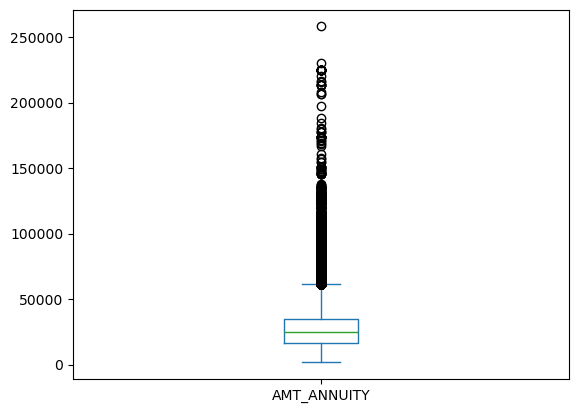

In [73]:
df_app["AMT_ANNUITY"].plot.box()

In [75]:
# AMT_ANNUITY -> Data with many outliers, so impute with NA values with median
df_app["AMT_ANNUITY"].fillna(df_app["AMT_ANNUITY"].median(),inplace=True)
df_app.AMT_ANNUITY.isna().sum()

0

In [77]:
# AMT_GOODS_PRICE -> NA data are those not applying for consumption loan, so impute with value 0 = not using loan to buy goods
df_app["AMT_GOODS_PRICE"].fillna(0, inplace=True)
df_app.AMT_GOODS_PRICE.isna().sum()

0

### **Standardize Boolean Data**

In [80]:
# Function to replace Y/N with numerical values: Convert into 1: Yes and 0: No for easier analysis and make it consistent
def convertyn(df,cols):
    for col in cols:
        if col in df.columns:
            df[col].replace({'Y':1, 'N':0}, inplace=True)
        else:
            print(f'The {col} cannot be found in the {df}')

In [82]:
# FLAG_OWN_CAR and FLAG_OWN_REALTY: 
convertyn(df_app,['FLAG_OWN_CAR','FLAG_OWN_REALTY'])

In [84]:
df_app.FLAG_OWN_CAR.value_counts()

FLAG_OWN_CAR
0    202796
1    104543
Name: count, dtype: int64

In [86]:
df_app.FLAG_OWN_REALTY.value_counts()

FLAG_OWN_REALTY
1    213200
0     94139
Name: count, dtype: int64

### **Standardize the Datatype**

In [89]:
# Fixing the mismatching datatype - they should be int value instead of float
def dtconvert (df, columns):
    for col in columns:
        if col in df.columns:
            df[col].fillna(0, inplace=True)
            df[col]=df[col].astype(int)
        else:
            print('column',col,'not found in dataframe')
    return df

list_convert=['CNT_FAM_MEMBERS','OBS_30_CNT_SOCIAL_CIRCLE','DEF_30_CNT_SOCIAL_CIRCLE',
              'OBS_60_CNT_SOCIAL_CIRCLE','DEF_60_CNT_SOCIAL_CIRCLE']
df_app=dtconvert (df_app,list_convert)

### **Final check current application data**

In [92]:
# Final checking the current application data
df_app.info()

<class 'pandas.core.frame.DataFrame'>
Index: 307339 entries, 0 to 307510
Data columns (total 27 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   SK_ID_CURR                307339 non-null  int64  
 1   TARGET                    307339 non-null  int64  
 2   NAME_CONTRACT_TYPE        307339 non-null  object 
 3   CODE_GENDER               307339 non-null  object 
 4   FLAG_OWN_CAR              307339 non-null  int64  
 5   FLAG_OWN_REALTY           307339 non-null  int64  
 6   CNT_CHILDREN              307339 non-null  int64  
 7   AMT_INCOME_TOTAL          307339 non-null  float64
 8   AMT_CREDIT                307339 non-null  float64
 9   AMT_ANNUITY               307339 non-null  float64
 10  AMT_GOODS_PRICE           307339 non-null  float64
 11  NAME_TYPE_SUITE           307339 non-null  object 
 12  NAME_INCOME_TYPE          307339 non-null  object 
 13  NAME_EDUCATION_TYPE       307339 non-null  object

## **PREVIOUS APPLICATION DATASET**

### **Check data structure**

In [96]:
# How many data and columns in the previsou application dataset?
df_prev_org.shape

(1670214, 37)

In [98]:
# More than 1,6m records with 28 columns. Much more than the current app dataset

In [100]:
# Each Current Application 'SK_ID_CURR' may have more than one Previous Application 'SK_ID_PREV' in this dataset
id_overlap=set(df_app.SK_ID_CURR).intersection(set(df_prev_org.SK_ID_CURR))

In [102]:
# However not all current ID present in the previous app, they are new first time applicants
new_clients=df_app.shape[0]-len(id_overlap)
new_clients

16386

In [104]:
# Reading the previous application dataset by viewing the first 5 rows 
df_prev_org.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


### **Duplication of data --> filtering data frame**

In [24]:
# Possibility of duplicated application records for one contract due to human mistakes - reflected by FLAG_LAST_APPL_PER_CONTRACT
# Filtering data to get only applications for one contracts which is the last processed one
df_prev=df_prev_org[(df_prev_org['FLAG_LAST_APPL_PER_CONTRACT'] == 'Y')]

### **Check Missing Values**

In [110]:
# Check the data columns of previous application data
df_prev.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1661739 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1661739 non-null  int64  
 1   SK_ID_CURR                   1661739 non-null  int64  
 2   NAME_CONTRACT_TYPE           1661739 non-null  object 
 3   AMT_ANNUITY                  1289508 non-null  float64
 4   AMT_APPLICATION              1661739 non-null  float64
 5   AMT_CREDIT                   1661738 non-null  float64
 6   AMT_DOWN_PAYMENT             774369 non-null   float64
 7   AMT_GOODS_PRICE              1281237 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1661739 non-null  object 
 9   HOUR_APPR_PROCESS_START      1661739 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1661739 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1661739 non-null  int64  
 12  RATE_DOWN_PAYMENT            774369 non-null   

In [111]:
# Check the percentage of missing data in previsous application data
df_prev_percent=df_prev.isna().sum()/df_prev.shape[0]*100
df_prev_percent

SK_ID_PREV                      0.000000
SK_ID_CURR                      0.000000
NAME_CONTRACT_TYPE              0.000000
AMT_ANNUITY                    22.400088
AMT_APPLICATION                 0.000000
AMT_CREDIT                      0.000060
AMT_DOWN_PAYMENT               53.400083
AMT_GOODS_PRICE                22.897820
WEEKDAY_APPR_PROCESS_START      0.000000
HOUR_APPR_PROCESS_START         0.000000
FLAG_LAST_APPL_PER_CONTRACT     0.000000
NFLAG_LAST_APPL_IN_DAY          0.000000
RATE_DOWN_PAYMENT              53.400083
RATE_INTEREST_PRIMARY          99.641881
RATE_INTEREST_PRIVILEGED       99.641881
NAME_CASH_LOAN_PURPOSE          0.000000
NAME_CONTRACT_STATUS            0.000000
DAYS_DECISION                   0.000000
NAME_PAYMENT_TYPE               0.000000
CODE_REJECT_REASON              0.000000
NAME_TYPE_SUITE                48.981880
NAME_CLIENT_TYPE                0.000000
NAME_GOODS_CATEGORY             0.000000
NAME_PORTFOLIO                  0.000000
NAME_PRODUCT_TYP

In [112]:
## Missing values fall into some variable with significant percentage, we will see if we can deal with some
## Instead of dropping them all

### **Missing Values Approach - Variable with small missing percentage**

In [115]:
# PRODUCT_COMBINATION -> Small missing data can be imputed with mode
df_prev.PRODUCT_COMBINATION.fillna(df_prev["PRODUCT_COMBINATION"].mode()[0],inplace=True)
df_prev.PRODUCT_COMBINATION.isna().sum()

0

### **Check Categorial Data**

In [119]:
# Read the values of categorial data columns in application dataset
read_columns(df_prev)

NAME_CONTRACT_TYPE: NAME_CONTRACT_TYPE
Cash loans         747549
Consumer loans     729151
Revolving loans    184693
XNA                   346
Name: count, dtype: int64
------------------------------
WEEKDAY_APPR_PROCESS_START: WEEKDAY_APPR_PROCESS_START
TUESDAY      253699
WEDNESDAY    253578
MONDAY       252237
FRIDAY       250682
THURSDAY     247784
SATURDAY     239584
SUNDAY       164175
Name: count, dtype: int64
------------------------------
FLAG_LAST_APPL_PER_CONTRACT: FLAG_LAST_APPL_PER_CONTRACT
Y    1661739
Name: count, dtype: int64
------------------------------
NAME_CASH_LOAN_PURPOSE: NAME_CASH_LOAN_PURPOSE
XAP                                 914190
XNA                                 677914
Repairs                              23765
Other                                15608
Urgent needs                          8412
Buying a used car                     2888
Building a house or an annex          2693
Everyday expenses                     2416
Medicine                      

### **Grouping small datas into Others**

In [122]:
# NAME_GOODS_CATEGORY
goods_count=df_prev.NAME_GOODS_CATEGORY.value_counts(normalize=True)*100
df_prev.NAME_GOODS_CATEGORY=df_prev.NAME_GOODS_CATEGORY.apply(lambda x:'Others' if goods_count[x]<1 else x)

In [123]:
# NAME_CASH_LOAN_PURPOSE
purpose_count=df_prev.NAME_CASH_LOAN_PURPOSE.value_counts(normalize=True)*100
df_prev.NAME_CASH_LOAN_PURPOSE=df_prev.NAME_CASH_LOAN_PURPOSE.apply(lambda x:'Others' if purpose_count[x]<1 else x)

In [124]:
#### **Combining Subdata based on Labels**

In [125]:
# PRODUCT_COMBINATION -> Combine each category based on the first part of the label, removing sub-cat
df_prev.N_PRODUCT_COMBINATION=df_prev.PRODUCT_COMBINATION.str.split().str[0]
df_prev.N_PRODUCT_COMBINATION.value_counts(normalize=True)*100

PRODUCT_COMBINATION
Cash    45.006767
POS     43.878792
Card    11.114441
Name: proportion, dtype: float64

### **XNA Value Approach**

In [128]:
# CATEGORIES DATA with few XNA - replace with mode with function xna2mode()
list1=['NAME_CONTRACT_TYPE','CODE_REJECT_REASON','NAME_CLIENT_TYPE']
xna2mode(df_prev,list1)

# CATEGORIES DATA with significant XNA - keep and re-label with function xna2label()
list2=['NAME_CASH_LOAN_PURPOSE', 'NAME_PAYMENT_TYPE', 'NAME_GOODS_CATEGORY', 
       'NAME_PORTFOLIO', 'NAME_PRODUCT_TYPE', 'NAME_SELLER_INDUSTRY','NAME_YIELD_GROUP']
xna2label(df_prev,list2)

### **Check Numerical Data - identify outliers**

In [130]:
# Checking the outliers of numerical datas
df_prev.describe()

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
count,1.661739e+06,1.661739e+06,1.289508e+06,1.661739e+06,1.661738e+06,7.743690e+05,1.281237e+06,1.661739e+06,1.661739e+06,774369.000000,5951.000000,5951.000000,1.661739e+06,1.661739e+06,1.289513e+06,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000
mean,1.922886e+06,2.783522e+05,1.597907e+04,1.753872e+05,1.954724e+05,6.697411e+03,2.274737e+05,1.248598e+01,9.995270e-01,0.079637,0.188357,0.773503,-8.793741e+02,3.146343e+02,1.615936e+01,342209.855039,13826.269337,33767.774054,76582.403064,81992.343838,0.332570
std,5.326229e+05,1.028124e+05,1.480483e+04,2.930528e+05,3.188173e+05,2.092151e+04,3.154937e+05,3.334255e+00,2.174339e-02,0.107823,0.087671,0.100879,7.778460e+02,7.145402e+03,1.455646e+01,88916.115834,72444.869708,106857.034789,149647.415123,153303.516729,0.471134
min,1.000001e+06,1.000010e+05,0.000000e+00,0.000000e+00,0.000000e+00,-9.000000e-01,0.000000e+00,0.000000e+00,0.000000e+00,-0.000015,0.034781,0.373150,-2.922000e+03,-1.000000e+00,0.000000e+00,-2922.000000,-2892.000000,-2801.000000,-2889.000000,-2874.000000,0.000000
25%,1.461554e+06,1.893275e+05,6.330780e+03,1.918800e+04,2.389500e+04,0.000000e+00,5.072850e+04,1.000000e+01,1.000000e+00,0.000000,0.160716,0.715645,-1.298000e+03,-1.000000e+00,6.000000e+00,365243.000000,-1628.000000,-1242.000000,-1314.000000,-1270.000000,0.000000
50%,1.922765e+06,2.787060e+05,1.125000e+04,7.124400e+04,7.959150e+04,1.638000e+03,1.118070e+05,1.200000e+01,1.000000e+00,0.051606,0.189122,0.835095,-5.800000e+02,3.000000e+00,1.200000e+01,365243.000000,-831.000000,-361.000000,-537.000000,-499.000000,0.000000
75%,2.384152e+06,3.674915e+05,2.067594e+04,1.800000e+05,2.156400e+05,7.740000e+03,2.314890e+05,1.500000e+01,1.000000e+00,0.108909,0.193330,0.852537,-2.800000e+02,8.200000e+01,2.400000e+01,365243.000000,-411.000000,129.000000,-74.000000,-44.000000,1.000000
max,2.845382e+06,4.562550e+05,4.180581e+05,6.905160e+06,6.905160e+06,3.060045e+06,6.905160e+06,2.300000e+01,1.000000e+00,1.000000,1.000000,1.000000,-1.000000e+00,4.000000e+06,8.400000e+01,365243.000000,365243.000000,365243.000000,365243.000000,365243.000000,1.000000


<Axes: ylabel='AMT_ANNUITY'>

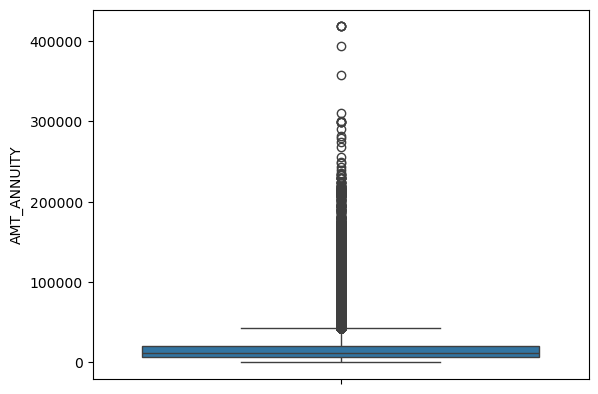

In [132]:
sns.boxplot(df_prev["AMT_ANNUITY"])

In [133]:
# AMT_ANNUITY -> Data with many outliers, so impute with NA values with median
df_prev["AMT_ANNUITY"].fillna(df_prev["AMT_ANNUITY"].median(),inplace=True)
df_prev.AMT_ANNUITY.isna().sum()

0

In [134]:
# AMT_GOODS_PRICE -> NA data are those not applying for consumption loan, so impute with value 0 = not using loan to buy goods
df_prev["AMT_GOODS_PRICE"].fillna(0, inplace=True)
df_prev.AMT_GOODS_PRICE.isna().sum()

0

### **Missing Value Approach - Binning**

In [136]:
# CNT_PAYMENT -> Loan term ranging from 3 months up 
df_prev["CNT_PAYMENT"].value_counts()

CNT_PAYMENT
12.0    323049
6.0     190461
10.0    141851
24.0    137764
0.0     136518
18.0     77430
36.0     72583
60.0     53596
48.0     47316
8.0      30349
4.0      26924
30.0     16924
14.0      8253
42.0      7136
16.0      5710
5.0       3957
54.0      2104
20.0      1805
7.0       1434
9.0       1236
3.0       1100
15.0       904
11.0       669
72.0       139
13.0        51
17.0        48
84.0        45
22.0        37
23.0        27
26.0        13
35.0        11
66.0        10
28.0         8
29.0         8
32.0         6
19.0         6
34.0         4
59.0         4
41.0         3
47.0         3
45.0         3
21.0         3
44.0         2
39.0         2
46.0         2
38.0         2
33.0         1
40.0         1
53.0         1
Name: count, dtype: int64

In [139]:
# Checkinging Loan term = 0 including approved application too, so this kind of missing values.
df_prev[df_prev["CNT_PAYMENT"]==0][['CNT_PAYMENT','NAME_CONTRACT_STATUS']].head()

,CNT_PAYMENT,NAME_CONTRACT_STATUS
17,0.0,Approved
34,0.0,Approved
45,0.0,Refused
49,0.0,Approved
80,0.0,Refused


In [140]:
# CNT_PAYMENT -> Convert to categorial data  with bins of value ranges and bin '0' into "Not specified" label for missing data
bins_cnt_payment = [0,1,12,24,36,48,60,99]
label_cnt_payment = ['Not specified','Under 12m','12-24m','24-36m','36-48m','48-60m', 'Above 60m']
df_prev["CNT_PAYMENT"]=pd.cut(df_prev["CNT_PAYMENT"],bins=bins_cnt_payment,labels=label_cnt_payment)
# CNT_PAYMENT -> fill in NA with "Not specified"
df_prev["CNT_PAYMENT"].fillna('Not specified', inplace=True)

In [141]:
df_prev["CNT_PAYMENT"].value_counts()

CNT_PAYMENT
Under 12m        721030
Not specified    508744
12-24m           232038
24-36m            89558
48-60m            55705
36-48m            54470
Above 60m           194
Name: count, dtype: int64

### **Missing Value Approach - Variable with signigicant missing percentage**

In [143]:
# Dropping the columns with more than 20% missing values
df_prev=df_prev.loc[:,df_prev.isna().mean()<=.19]

### **Standardize Boolean Data**

In [146]:
# CATERGORIES DATA with YN -> Convert to 1/0 with function convertyn()
convertyn(df_prev,['FLAG_LAST_APPL_PER_CONTRACT'])

### **Final check the previour application data**

In [148]:
# Final check the information of previous application data
df_prev.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1661739 entries, 0 to 1670213
Data columns (total 26 columns):
 #   Column                       Non-Null Count    Dtype   
---  ------                       --------------    -----   
 0   SK_ID_PREV                   1661739 non-null  int64   
 1   SK_ID_CURR                   1661739 non-null  int64   
 2   NAME_CONTRACT_TYPE           1661739 non-null  object  
 3   AMT_ANNUITY                  1661739 non-null  float64 
 4   AMT_APPLICATION              1661739 non-null  float64 
 5   AMT_CREDIT                   1661738 non-null  float64 
 6   AMT_GOODS_PRICE              1661739 non-null  float64 
 7   WEEKDAY_APPR_PROCESS_START   1661739 non-null  object  
 8   HOUR_APPR_PROCESS_START      1661739 non-null  int64   
 9   FLAG_LAST_APPL_PER_CONTRACT  1661739 non-null  int64   
 10  NFLAG_LAST_APPL_IN_DAY       1661739 non-null  int64   
 11  NAME_CASH_LOAN_PURPOSE       1661739 non-null  object  
 12  NAME_CONTRACT_STATUS         1661

# **DATA ANALYSIS**

*   Explain the analysis results of univariate, segmented univariate, bivariate analysis, etc. in business terms.
*   Find the top 10 correlation for the Client with payment difficulties and all other cases (Target variable)
*   Visualisations and summarise the most important results
*   Identify patterns of payment difficulty to take appropriate actions on the loan application/ Identify driving factors (strong indicators) behind the loan default.

## **MANIPULATION OF DATASET**

### **CREATE NEW CALCULATED COLUMNS**

In [156]:
df_app.NAME_FAMILY_STATUS.value_counts()

NAME_FAMILY_STATUS
Married                 196337
Single / not married     45415
Civil marriage           29746
Separated                19760
Widow                    16079
Unknown                      2
Name: count, dtype: int64

In [164]:
# Number of applicant's dependents: including children and spouse (if married) # Assumption: Spouse and children supposed to be financially dependant
df_app['N_MARRIED']=df_app.NAME_FAMILY_STATUS.apply(lambda x: 1 if (x=='Married' or x=='Civil marriage') else 0)
df_app['N_DEPENDENT']=df_app.CNT_CHILDREN + df_app.N_MARRIED

# Percentage of given Credit Amount of Goods-pricing
df_app['N_CREDIT_GOODS']=df_app.AMT_CREDIT/df_app.AMT_GOODS_PRICE*100
df_prev['N_CREDIT_GOODS']=df_prev.AMT_CREDIT/df_prev.AMT_GOODS_PRICE*100

# Percentage of given Credit Amount of Applied Amount
df_prev['N_CREDIT_APPLICATION']=df_prev.AMT_CREDIT/df_prev.AMT_APPLICATION*100

### **DATA FORMAT CONVERSION DAYS INTO MONTH OR YEAR**

<Axes: ylabel='DAYS_EMPLOYED'>

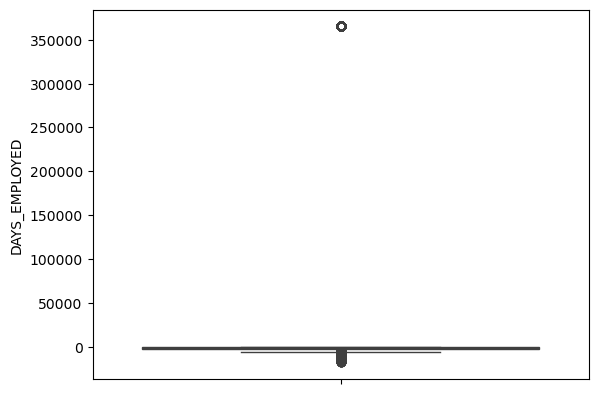

In [168]:
# Check Days_employed data 
sns.boxplot(df_app.DAYS_EMPLOYED)

In [170]:
# Days_employed data -> abnormal outliers > 900 years working -> Drop this data
df_app=df_app[(df_app.DAYS_EMPLOYED <50000)]

In [175]:
# DAYS data converted to meaningful formats
# Create age by years from DAYS_BIRTH
df_app['N_YEARS_BIRTH']=round(-df_app.DAYS_BIRTH/365,2)
# Create employment/ working experience by years from DAYS_EMPLOYED
df_app['N_YEARS_EMPLOYED']=round(-df_app.DAYS_EMPLOYED/365,2)
# Create month decision from DAYS_DECISION
df_prev['N_MONTH_DECISION']=round(-df_prev.DAYS_DECISION/30,2)

### **NUMERICAL DATA CONVERTED TO CATEGORIAL ORDERED RANGE**

In [178]:
# Function to create bin with label for a numberical data
def createbin(df, col, bin, label):
    binned_values=pd.cut(df[col], bins=bin, labels=label)
    return binned_values

In [180]:
# Create income range: AMT_INCOME_TOTAL
bin_income = [0,50000,100000,150000,200000,250000,200000000]
label_income = ['0-50K','50-100K', '100-150K','150-200K','200-250K','250K+']
df_app['N_INCOME_RANGE']=createbin(df_app,'AMT_INCOME_TOTAL',bin_income,label_income)

In [182]:
df_app['N_INCOME_RANGE'].value_counts()

N_INCOME_RANGE
100-150K    74619
150-200K    55162
200-250K    42458
50-100K     41658
250K+       36119
0-50K        1981
Name: count, dtype: int64

In [184]:
# Create credit range: AMT_CREDIT
bin_credit = [0,200000,400000,600000,800000,1000000,5000000]
label_credit = ['0-200K','200-400K', '400-600K','600-800K','800-1000K','1000K+']
df_app['N_CREDIT_RANGE']=createbin(df_app,'AMT_CREDIT',bin_credit,label_credit)
df_prev['N_CREDIT_RANGE']=createbin(df_prev,'AMT_CREDIT',bin_credit,label_credit)

In [186]:
df_app['N_CREDIT_RANGE'].value_counts()

N_CREDIT_RANGE
200-400K     64306
400-600K     54999
1000K+       43130
600-800K     35113
0-200K       28345
800-1000K    26104
Name: count, dtype: int64

In [188]:
df_prev['N_CREDIT_RANGE'].value_counts()

N_CREDIT_RANGE
0-200K       891340
200-400K     193067
400-600K      98613
1000K+        63488
600-800K      47760
800-1000K     30705
Name: count, dtype: int64

In [190]:
# Create annuity range: AMT_ANNUITY
bin_annuity = [0,5000,15000,25000,35000,45000,300000]
label_annuity = ['0-5k','5-15K', '15-25K','25-35K','35-45K','45K+']
df_app['N_ANNUITY_RANGE']=createbin(df_app,'AMT_ANNUITY',bin_annuity,label_annuity)
df_prev['N_ANNUITY_RANGE']=createbin(df_prev,'AMT_ANNUITY',bin_annuity,label_annuity)

In [192]:
df_app['N_ANNUITY_RANGE'].value_counts()

N_ANNUITY_RANGE
15-25K    71140
25-35K    66610
5-15K     48050
35-45K    36307
45K+      29182
0-5k        708
Name: count, dtype: int64

In [194]:
df_prev['N_ANNUITY_RANGE'].value_counts()

N_ANNUITY_RANGE
5-15K     964517
15-25K    237745
0-5k      220924
25-35K    110666
45K+       66593
35-45K     59650
Name: count, dtype: int64

In [196]:
# Create good-priced range: AMT_GOODS_PRICE -> 0: Not consumption loan
bin_goods = [-1,0,150000,300000,450000,600000,750000,5000000]
label_goods = ['No-consumption','Under 150K','150-300K', '300-450K','450-600K','600-750K','750K+']
df_app['N_GOOD_PRICE_RANGE']=createbin(df_app,'AMT_GOODS_PRICE',bin_goods,label_goods)
df_prev['N_GOOD_PRICE_RANGE']=createbin(df_prev,'AMT_GOODS_PRICE',bin_goods,label_goods)

In [198]:
df_app['N_GOOD_PRICE_RANGE'].value_counts()

N_GOOD_PRICE_RANGE
150-300K          63612
750K+             57713
300-450K          46350
600-750K          36317
450-600K          29283
Under 150K        18466
No-consumption      256
Name: count, dtype: int64

In [200]:
df_prev['N_GOOD_PRICE_RANGE'].value_counts()

N_GOOD_PRICE_RANGE
Under 150K        786396
No-consumption    387363
150-300K          221950
300-450K          102047
750K+              89758
450-600K           37415
600-750K           36806
Name: count, dtype: int64

In [202]:
# Creat application range: AMT_APPLICATION -> 0: Not specified
bin_application = [-1,0,30000,60000,90000,120000,150000,180000,7000000]
label_application = ['Not specified','Under 30K', '30-60K','60-90K','90-120K','120-150K','150-180K','180K+']
df_prev['N_APPLICATION_RANGE']=createbin(df_prev,'AMT_APPLICATION',bin_application,label_application)

In [204]:
df_prev['N_APPLICATION_RANGE'].value_counts()

N_APPLICATION_RANGE
180K+            415273
Not specified    387363
30-60K           251130
60-90K           190367
Under 30K        116855
90-120K          115169
120-150K         112875
150-180K          72707
Name: count, dtype: int64

In [206]:
# Create age range based on N_YEARS_BIRTH
bin_age = [0,21,30,40,50,60,100]
label_age = ['Under 21','21-30', '30-40','40-50','50-60','60+']
df_app['N_AGE_RANGE']=createbin(df_app,'N_YEARS_BIRTH',bin_age,label_age)

In [208]:
df_app['N_AGE_RANGE'].value_counts()

N_AGE_RANGE
30-40       81768
40-50       74673
21-30       44860
50-60       44703
60+          5992
Under 21        1
Name: count, dtype: int64

In [210]:
# Create employment range based on N_YEARS_EMPLOYED -> 0: Not employed recently
bin_employment = [-1,0,2,5,10,15,20,25,30,100]
label_employment = ['Not employed','Under 2 year', '2-5 year','5-10 year','10-15 year','15-20 year','20-25 year','25-30 year','30+ year']
df_app['N_EMPLOYMENT_RANGE']=createbin(df_app,'N_YEARS_EMPLOYED',bin_employment,label_employment)

In [212]:
df_app['N_EMPLOYMENT_RANGE'].value_counts()

N_EMPLOYMENT_RANGE
2-5 year        76407
5-10 year       64823
Under 2 year    59848
10-15 year      27531
15-20 year      10840
20-25 year       6235
25-30 year       3307
30+ year         3003
Not employed        3
Name: count, dtype: int64

In [214]:
# Create application decision range based on N_MONTH_DECISION -> 0: No decision yet
bin_decision = [0,1,3,6,9,12,24,36,48,60,999]
label_decision  = ['Under 1 month','1-3 month','3-6 month','6-9 month','9-12 month','1-2 year','2-3 year','3-4 year','4-5 year','5+ year']
df_prev['N_DECISION_RANGE']=createbin(df_prev,'N_MONTH_DECISION',bin_decision ,label_decision)

In [216]:
df_prev['N_DECISION_RANGE'].value_counts()

N_DECISION_RANGE
1-2 year         383261
5+ year          266400
2-3 year         214745
6-9 month        180607
9-12 month       165976
3-4 year         132026
3-6 month        127880
4-5 year         102629
1-3 month         51051
Under 1 month     37164
Name: count, dtype: int64

## **Merge dataframe**

In [223]:
# Merge current application data with previous data
df_merge=df_app.merge(df_prev, how='left', on='SK_ID_CURR')

In [227]:
df_merge.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE_x,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT_x,AMT_ANNUITY_x,AMT_GOODS_PRICE_x,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,CNT_FAM_MEMBERS,ORGANIZATION_TYPE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,N_CREDITSCORE,N_TOTAL_CREDIT_BUREAU,N_3M_CREDIT_BUREAU,N_MARRIED,N_DEPENDENT,N_CREDIT_GOODS_x,N_YEARS_BIRTH,N_YEARS_EMPLOYED,N_INCOME_RANGE,N_CREDIT_RANGE_x,N_ANNUITY_RANGE_x,N_GOOD_PRICE_RANGE_x,N_AGE_RANGE,N_EMPLOYMENT_RANGE,SK_ID_PREV,NAME_CONTRACT_TYPE_y,AMT_ANNUITY_y,AMT_APPLICATION,AMT_CREDIT_y,AMT_GOODS_PRICE_y,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,N_CREDIT_GOODS_y,N_CREDIT_APPLICATION,N_MONTH_DECISION,N_CREDIT_RANGE_y,N_ANNUITY_RANGE_y,N_GOOD_PRICE_RANGE_y,N_APPLICATION_RANGE,N_DECISION_RANGE
0,100002,1,Cash loans,M,0,1,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,-9461,-637,1,Business Entity,2,2,2,2,0.161787,1,0,0,0,115.839744,25.92,1.75,200-250K,400-600K,15-25K,300-450K,21-30,Under 2 year,1038818.0,Consumer loans,9251.775,179055.0,179055.0,179055.0,SATURDAY,9.0,1.0,1.0,XAP,Approved,-606.0,Not Specified,XAP,New,Others,POS,Not Specified,Stone,500.0,Auto technology,12-24m,low_normal,POS other with interest,100.000000,100.000000,20.20,0-200K,5-15K,150-300K,150-180K,1-2 year
1,100003,0,Cash loans,F,0,0,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,-16765,-1188,2,School,1,0,1,0,0.466757,0,0,1,1,114.519920,45.93,3.25,250K+,1000K+,35-45K,750K+,40-50,2-5 year,1810518.0,Cash loans,98356.995,900000.0,1035882.0,900000.0,FRIDAY,12.0,1.0,1.0,Not Specified,Approved,-746.0,Not Specified,XAP,Repeater,Not Specified,Cash,x-sell,Credit and cash offices,-1.0,Not Specified,Under 12m,low_normal,Cash X-Sell: low,115.098000,115.098000,24.87,1000K+,45K+,750K+,180K+,2-3 year
2,100003,0,Cash loans,F,0,0,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,-16765,-1188,2,School,1,0,1,0,0.466757,0,0,1,1,114.519920,45.93,3.25,250K+,1000K+,35-45K,750K+,40-50,2-5 year,2636178.0,Consumer loans,64567.665,337500.0,348637.5,337500.0,SUNDAY,17.0,1.0,1.0,XAP,Approved,-828.0,Cash through the bank,XAP,Refreshed,Furniture,POS,Not Specified,Stone,1400.0,Furniture,Under 12m,middle,POS industry with interest,103.300000,103.300000,27.60,200-400K,45K+,300-450K,180K+,2-3 year
3,100003,0,Cash loans,F,0,0,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,-16765,-1188,2,School,1,0,1,0,0.466757,0,0,1,1,114.519920,45.93,3.25,250K+,1000K+,35-45K,750K+,40-50,2-5 year,2396755.0,Consumer loans,6737.310,68809.5,68053.5,68809.5,SATURDAY,15.0,1.0,1.0,XAP,Approved,-2341.0,Cash through the bank,XAP,Refreshed,Consumer Electronics,POS,Not Specified,Country-wide,200.0,Consumer electronics,Under 12m,middle,POS household with interest,98.901314,98.901314,78.03,0-200K,5-15K,Under 150K,60-90K,5+ year
4,100004,0,Revolving loans,M,1,1,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,-19046,-225,1,Government,0,0,0,0,0.642739,0,0,0,0,100.000000,52.18,0.62,50-100K,0-200K,5-15K,Under 150K,50-60,Under 2 year,1564014.0,Consumer loans,5357.250,24282.0,20106.0,24282.0,FRIDAY,5.0,1.0,1.0,XAP,Approved,-815.0,Cash through the bank,XAP,New,Mobile,POS,Not Specified,Regional / Local,30.0,Connectivity,Under 12m,middle,POS mobile without interest,82.802076,82.802076,27

## **VISUALIZATION & ANALYSIS**

### **1. WHO ARE THE CURRENT LOAN APPLICANTS? (Univariable analysis)**

In [231]:
# What are their profiling? Age, gender, children, family members, family status, co-applicant, income, education, employment...(Applicant attributes)
# What are the popular loan? Loan types, credit ranges, ... (Loan attributes)
# Chart types: histogram, pie chart, line chart, boxplot 

#### **Prepare column data**

In [234]:
df_app.columns

Index(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'NAME_TYPE_SUITE',
       'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS',
       'NAME_HOUSING_TYPE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'CNT_FAM_MEMBERS',
       'ORGANIZATION_TYPE', 'OBS_30_CNT_SOCIAL_CIRCLE',
       'DEF_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE',
       'DEF_60_CNT_SOCIAL_CIRCLE', 'N_CREDITSCORE', 'N_TOTAL_CREDIT_BUREAU',
       'N_3M_CREDIT_BUREAU', 'N_MARRIED', 'N_DEPENDENT', 'N_CREDIT_GOODS',
       'N_YEARS_BIRTH', 'N_YEARS_EMPLOYED', 'N_INCOME_RANGE', 'N_CREDIT_RANGE',
       'N_ANNUITY_RANGE', 'N_GOOD_PRICE_RANGE', 'N_AGE_RANGE',
       'N_EMPLOYMENT_RANGE'],
      dtype='object')

In [18]:
# Create a list of columns with Categorial data types for analysis --> BAR / LINE CHART (COUNTPLOT)
df_app_cat=[{'key': 'NAME_CONTRACT_TYPE', 'value': 'Loan Type'},
                    {'key': 'CODE_GENDER', 'value': 'Applicant Gender'},
                    {'key': 'NAME_TYPE_SUITE', 'value': 'Co-applicants'},
                    {'key': 'NAME_INCOME_TYPE', 'value': 'Income Type'},
                    {'key': 'NAME_EDUCATION_TYPE', 'value': 'Education Type'},
                    {'key': 'NAME_FAMILY_STATUS', 'value': 'Marital Status'},
                    {'key': 'NAME_HOUSING_TYPE', 'value': 'Housing Type'},
                    {'key': 'ORGANIZATION_TYPE', 'value': 'Working Organization'},
                    {'key': 'N_INCOME_RANGE', 'value': 'Applicant Income'},
                    {'key': 'N_CREDIT_RANGE', 'value': 'Range of Mean Credit Score from External Sources'},
                    {'key': 'N_ANNUITY_RANGE', 'value': 'Range of Applicant Annuity (Debt)'},
                    {'key': 'N_GOOD_PRICE_RANGE', 'value': 'Range of Good Pricing for Consumer Loans'}, 
                    {'key': 'N_AGE_RANGE', 'value': 'Range Applicant Age'},
                    {'key': 'N_EMPLOYMENT_RANGE', 'value': 'Applicant Employment Period'},
                    {'key': 'TARGET', 'value': 'Defaulter vs. Non-defaulters'},
                    {'key': 'FLAG_OWN_CAR', 'value': 'Car Ownership'}, 
                    {'key': 'FLAG_OWN_REALTY', 'value': 'House Ownership'},
                    {'key': 'N_MARRIED', 'value': 'Married vs. Single'}]

In [14]:
# Create a list of columns with Numerical data types for analysis --> HISTPLOT or BOXPLOT 
## Numerical data without significant outliers
df_app_cat_num_not=[{'key': 'AMT_CREDIT', 'value': 'Amount of Loan Credit Given to Applicants'}, 
                {'key': 'AMT_ANNUITY', 'value': 'Amount of Applicant Annuity (Debt)'}, 
                {'key': 'AMT_GOODS_PRICE', 'value': 'Amount of Good Pricing for Consumer Loans'}, 
                {'key': 'N_CREDITSCORE', 'value': 'Mean Credit Score from External Sources'},
                {'key': 'N_YEARS_BIRTH', 'value': 'Applicant Age'}, 
                {'key': 'N_YEARS_EMPLOYED', 'value': 'Years of Employments'}]
## Numerical data with significant outliers
df_app_cat_num_out=[{'key': 'AMT_INCOME_TOTAL', 'value': 'Amount of Applicant Income'},
                   {'key': 'CNT_CHILDREN', 'value': 'Number of Applicant Children'},
                    {'key': 'CNT_FAM_MEMBERS', 'value': 'Number of Applicant Family Members'},
                    {'key': 'N_TOTAL_CREDIT_BUREAU', 'value': 'Total Number of Enquiries to Credit Bureau in One Year'},
                    {'key': 'N_3M_CREDIT_BUREAU', 'value': 'Total Number of Enquiries to Credit Bureau Last 3 Month'},
                    {'key': 'N_DEPENDENT', 'value': 'Number of Applicant Dependents'},
                    {'key': 'OBS_30_CNT_SOCIAL_CIRCLE', 'value': 'Number of Observable 30 DPD Default in Applicant Social Surrounding'}, 
                    {'key': 'DEF_30_CNT_SOCIAL_CIRCLE', 'value': 'Number of 30 DPD Defaulters in Applicant Social Surrounding'},
                    {'key': 'OBS_60_CNT_SOCIAL_CIRCLE', 'value': 'Number of Observable 60 DPD Default in Applicant Social Surrounding'}, 
                    {'key': 'DEF_60_CNT_SOCIAL_CIRCLE', 'value': 'Number of 60 DPD Defaulters in Applicant Social Surrounding'},
                    {'key': 'N_CREDIT_GOODS', 'value': 'Ratio of Given Credit vs. Good Pricing'}]

In [16]:
# List of Numberical Columns
df_app_num=df_app_cat_num_not+df_app_cat_num_out

#### **Functions to plot multiple chart**

In [297]:
# COUNTPLOT - Function to loop plotting countplot
def fcount(df,df_list):    
    for i in range(len(df_list)):
        # Create a figure size
        num_categories = df[df_list[i]['key']].nunique()
        fig_height=max(3,num_categories)
        fig = plt.figure(figsize=[15, fig_height])
        # Creating countplot 
        ax = sns.countplot(y=df_list[i]['key'],data=df, stat='count', legend='full', 
                           order=df[df_list[i]['key']].value_counts().index,color=sns.color_palette('pastel')[0])
        # Adding details to the chart
        plt.yticks(size=12)
        plt.xticks(size=12)
        plt.xlabel(xlabel='Counts', size=14)
        plt.ylabel(ylabel=df_list[i]['value'], size=14)
        plt.title(label=f'Counts of {df_list[i]['value']}', size=16)
        for container in ax.containers:
            ax.bar_label(container,)
        # Save fig
        plt.draw()
        plt.savefig(f'/Users/macbook/Desktop/SUVC/POST-GRAD/Assignment/{df_list[i]['key']}.png')
        plt.show()
        plt.close()

In [293]:
# HISTOGRAM - Function to loop plotting hist chart
def fhist(df,df_list):   
    for i in range(len(df_list)):
        # Create a figure size
        plt.figure(figsize=[15, 6])
        # Creating histplot
        sns.histplot(df[df_list[i]['key']],kde=True, color=sns.color_palette('pastel')[0])
        # Set x-axis limits to min and max values
        plt.xlim(df[df_list[i]['key']].min(), df[df_list[i]['key']].max())
        # Adding mean/median line
        plt.axvline(df[df_list[i]['key']].mean(), color='r', label='Mean')
        plt.axvline(df[df_list[i]['key']].median(), color='g', label='Median')
        # Adding details to the chart 
        plt.yticks(size=12)
        plt.xticks(size=12)
        plt.xlabel(xlabel=df_list[i]['value'], size=14)
        plt.ylabel(ylabel='Frequency', size=14)
        plt.title(label=f'Distribution of {df_list[i]['value']}', size=16)
        # Save fig
        plt.draw()
        plt.savefig(f'/Users/macbook/Desktop/SUVC/POST-GRAD/Assignment/{df_list[i]['key']}.png')
        plt.show()
        plt.close()

In [299]:
# BOXPLOT - Function to loop plotting boxplot
def fbox(df,df_list):   
    for i in range(len(df_list)):
        # Create a figure size
        plt.figure(figsize=[15, 6])
        # **Creating subplot to plot 2 boxplots with and without outliers** 
        
        # Plotting the one with outliers
        plt.subplot(1,2,1)
        sns.boxplot(df[df_list[i]['key']],color=sns.color_palette('pastel')[0])
        plt.title(textwrap.fill(f'WITH Outliers - Distribution of {df_list[i]['value']}', width=30), size=16)
        plt.ylabel(ylabel=df_list[i]['value'], size=10)
        
        # Plotting the one without outliers
        Q1 = df[df_list[i]['key']].quantile(0.25)
        Q3 = df[df_list[i]['key']].quantile(0.75)
        IQR = Q3 - Q1
        lower=Q1 - 1.5 * IQR
        upper=Q3 + 1.5 * IQR
        df_no_outliers = df[(df[df_list[i]['key']]>=lower)&(df[df_list[i]['key']]<=upper)]
        plt.subplot(1,2,2)
        sns.boxplot(df_no_outliers[df_list[i]['key']], color=sns.color_palette('pastel')[0])
        plt.title(textwrap.fill(f'WITHOUT Outliers - Distribution of {df_list[i]['value']}', width=30), size=16)
        plt.ylabel(ylabel=df_list[i]['value'], size=10)
        # Save fig
        plt.draw()
        plt.savefig(f'/Users/macbook/Desktop/SUVC/POST-GRAD/Assignment/{df_list[i]['key']}.png')
        plt.show()
        plt.close()

#### **Chart Plotting**

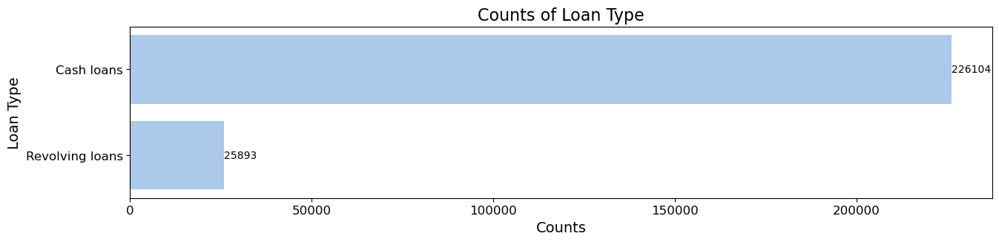

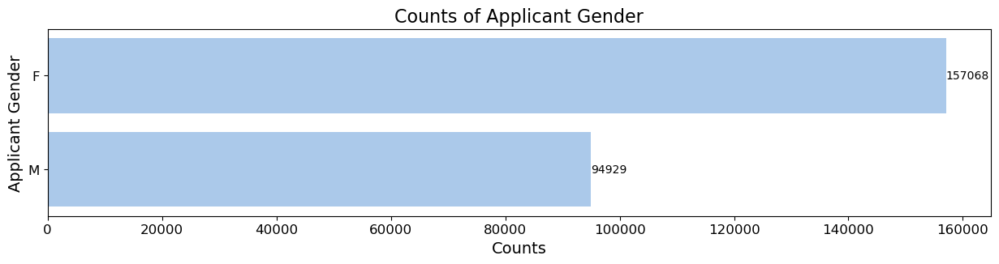

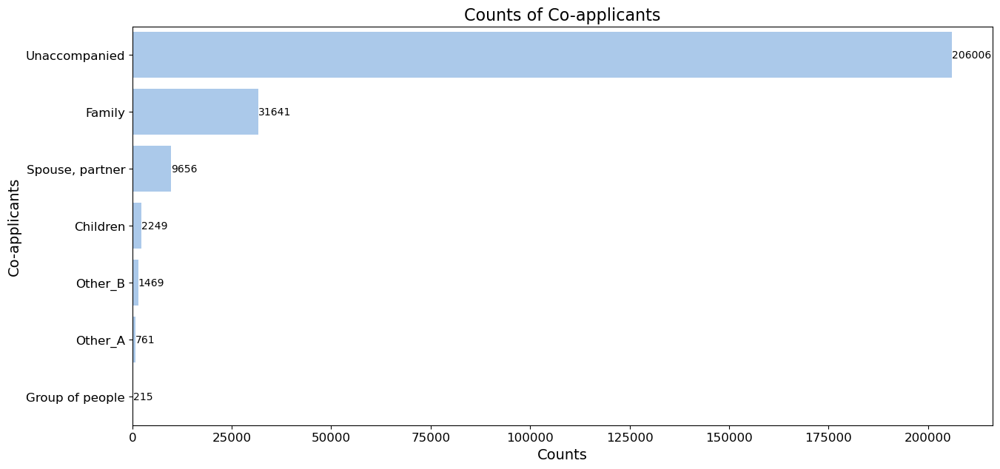

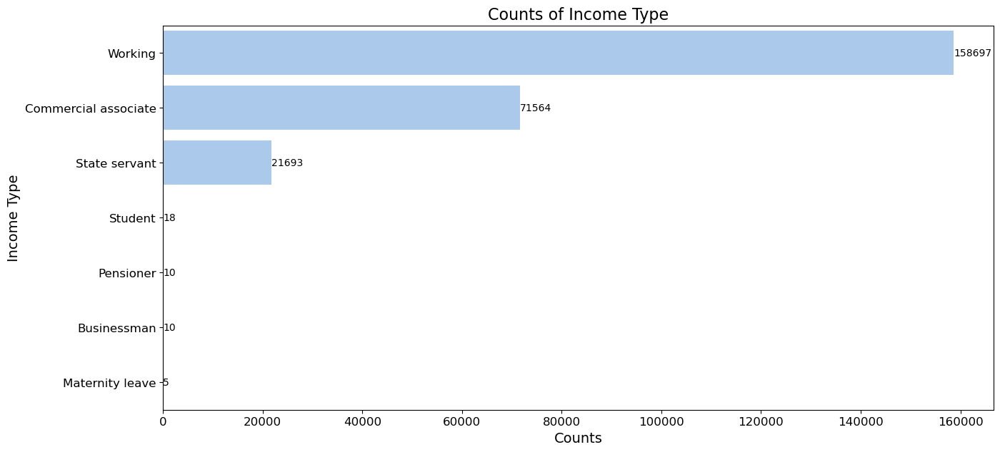

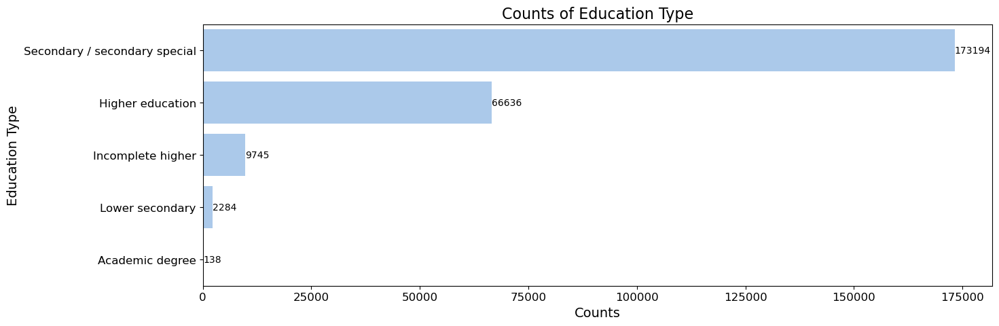

...

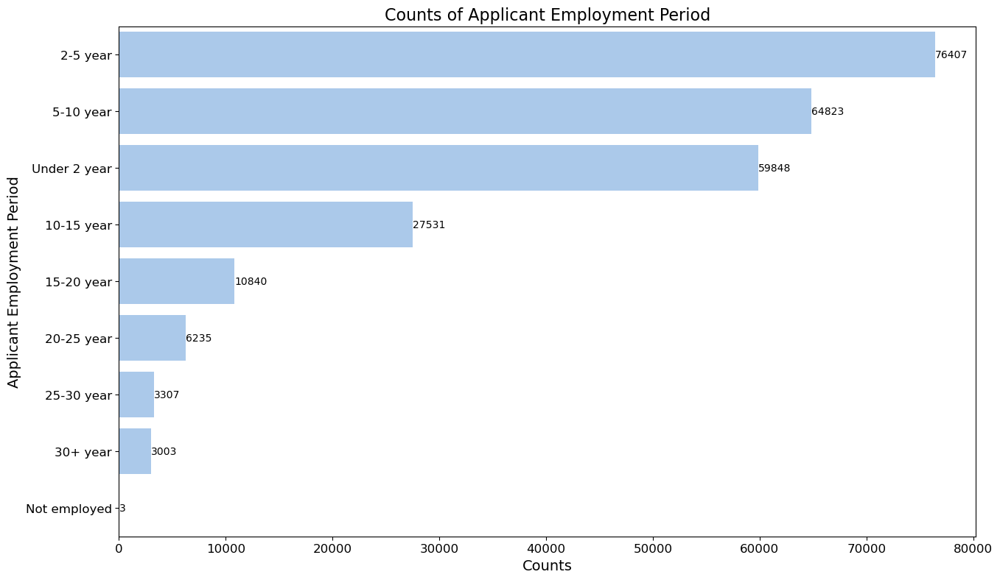

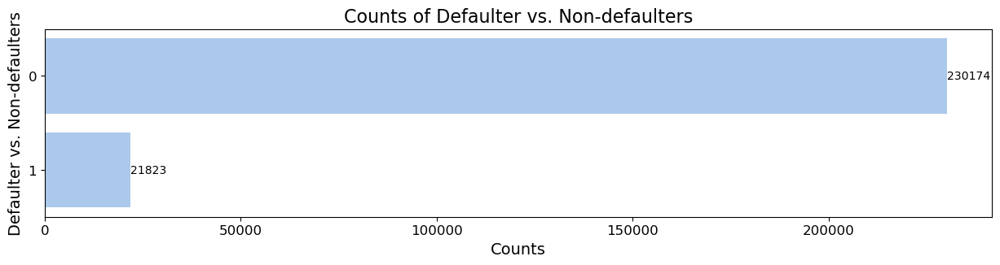

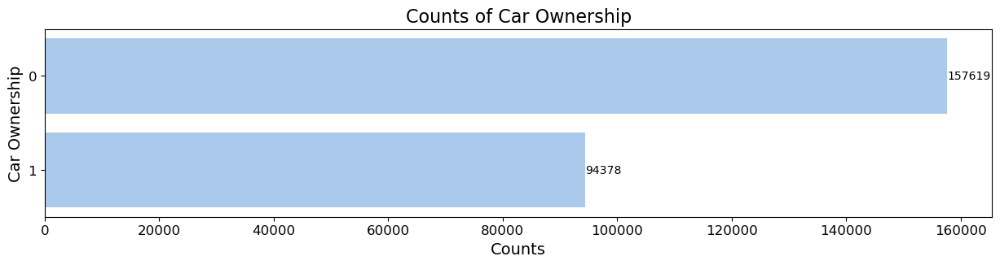

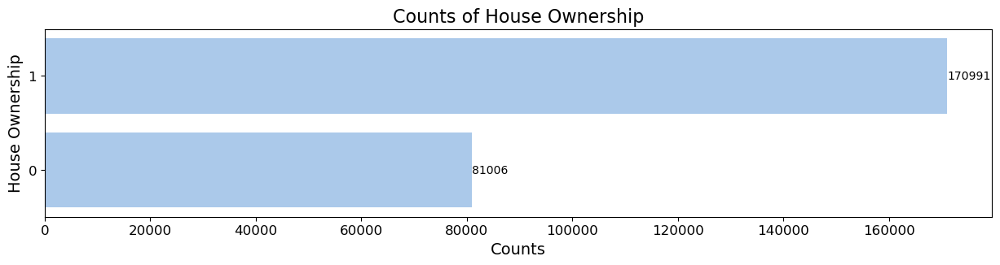

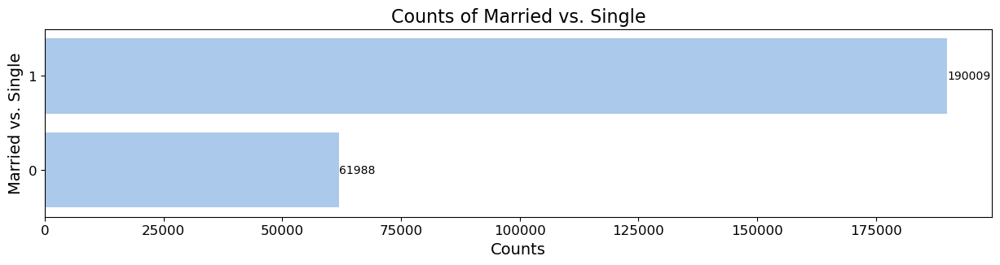

In [250]:
# CATEGORIAL DATA - UNIVARIABLE
fcount(df_app,df_app_cat)

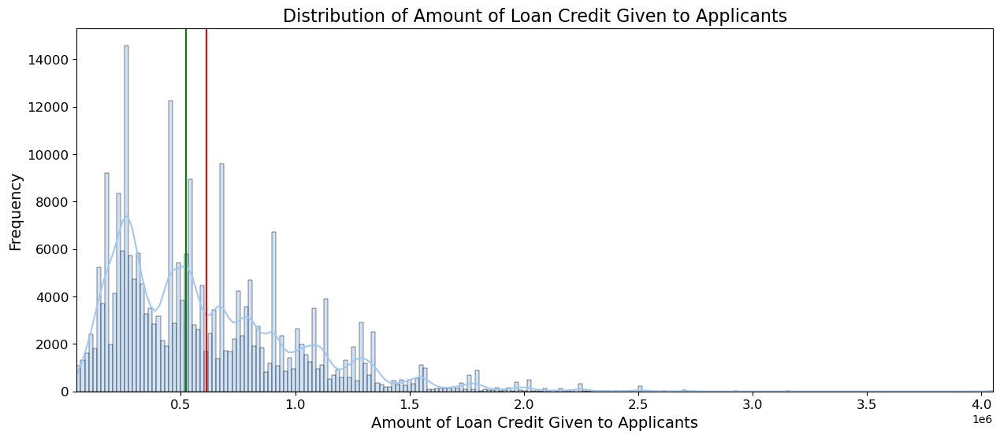

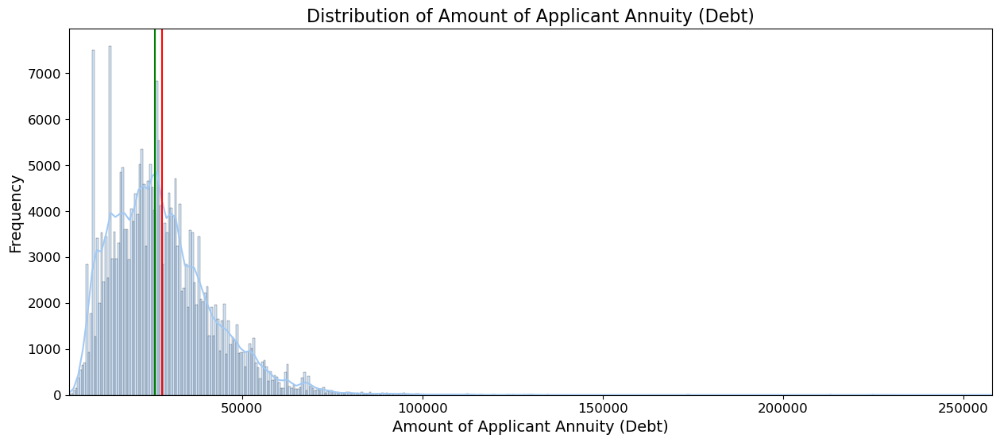

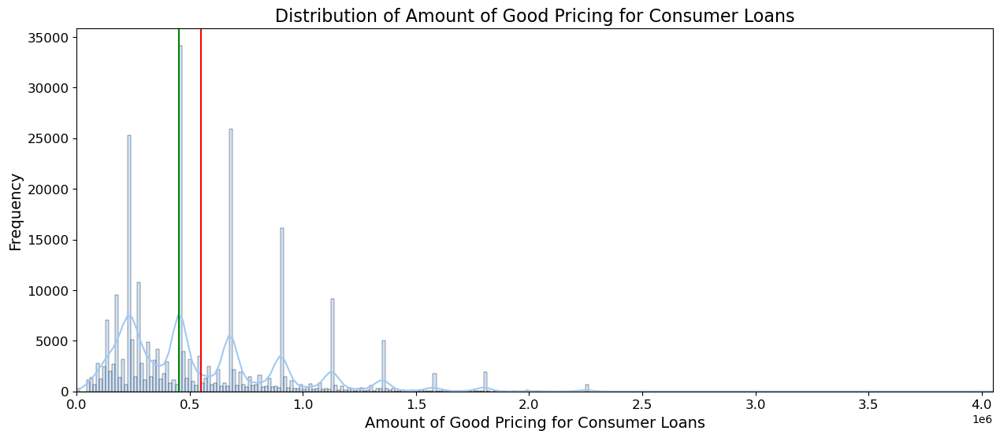

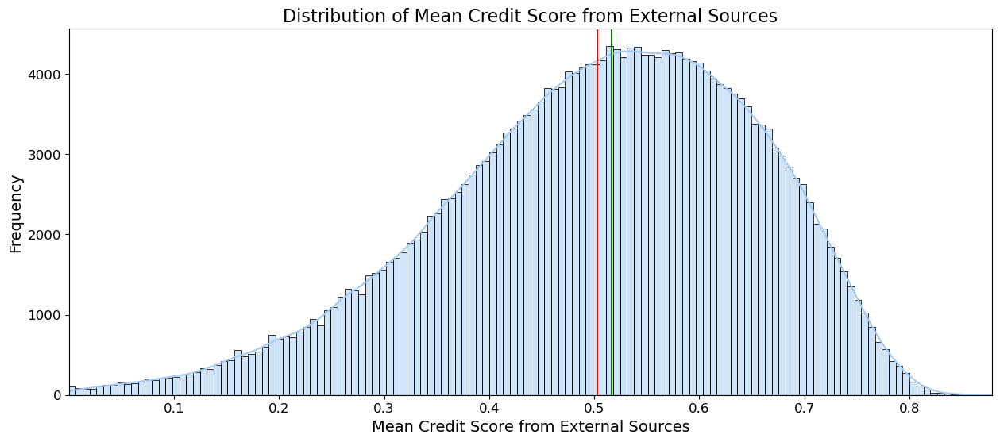

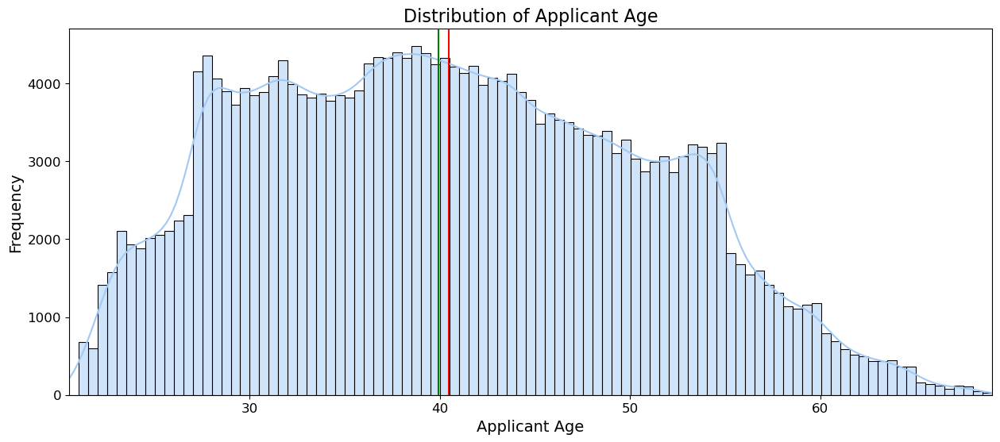

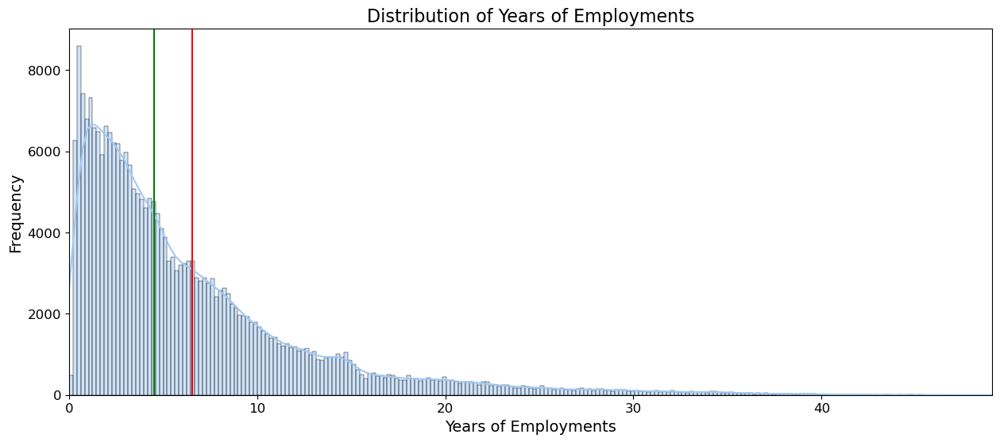

In [295]:
# NUMERICAL DATA - UNIVARIABLE - HISTOGRAM
fhist(df_app,df_app_cat_num_not)

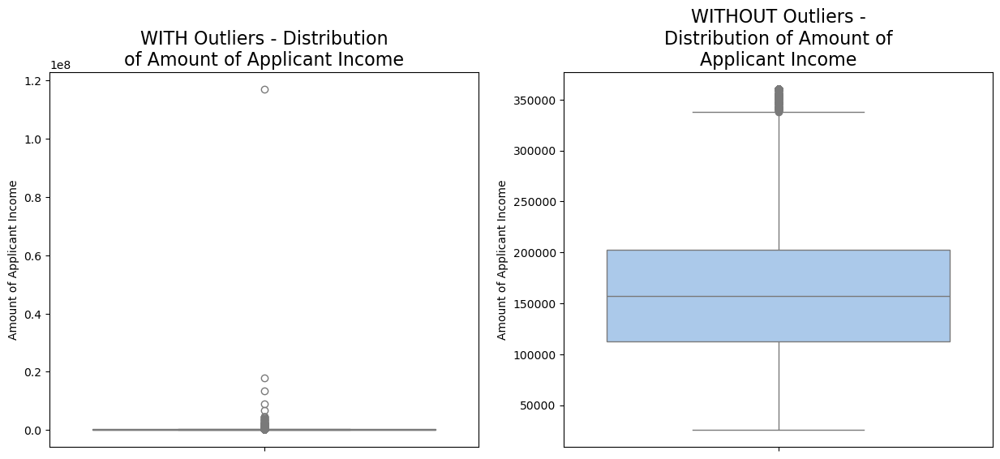

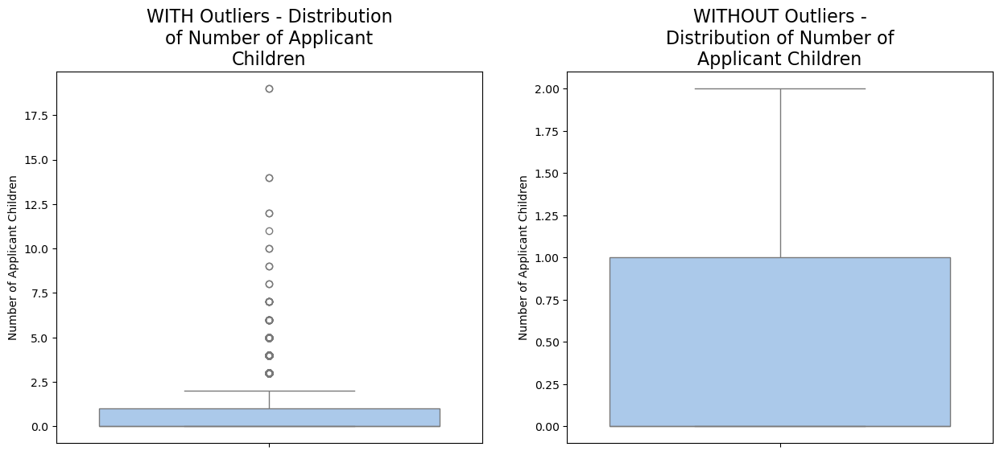

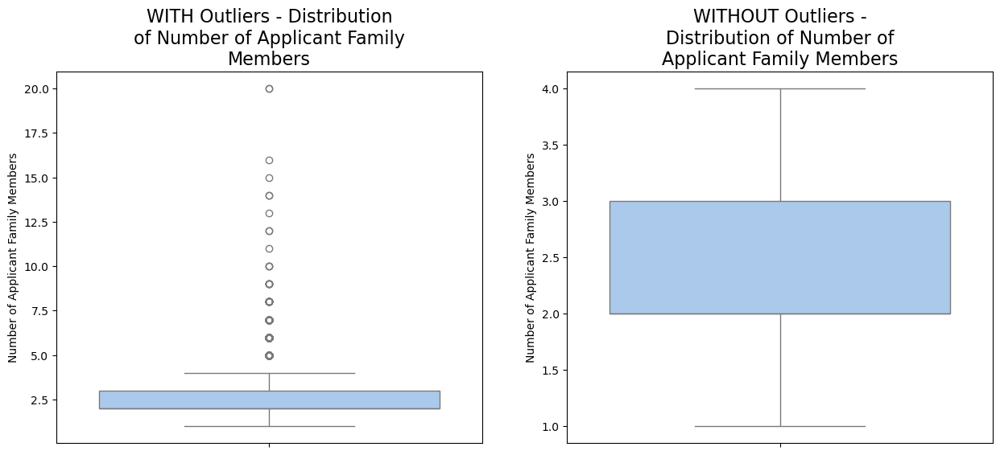

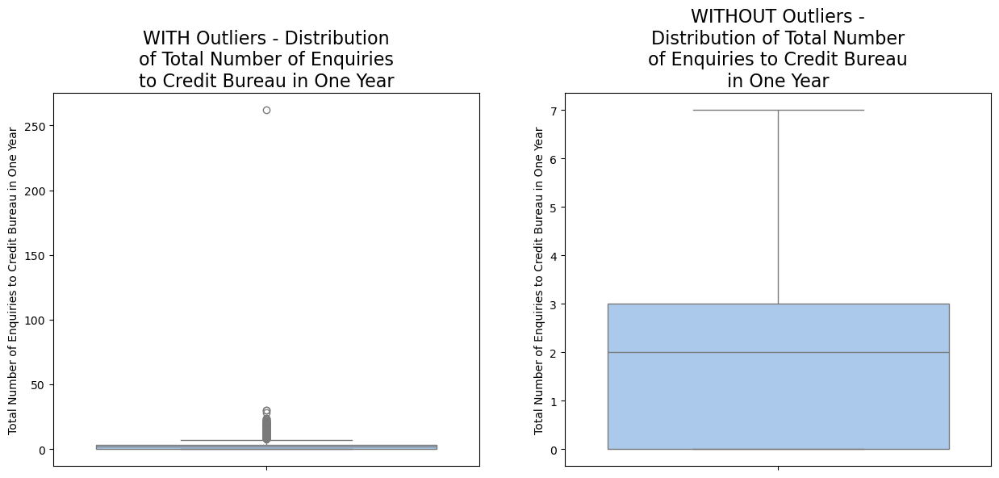

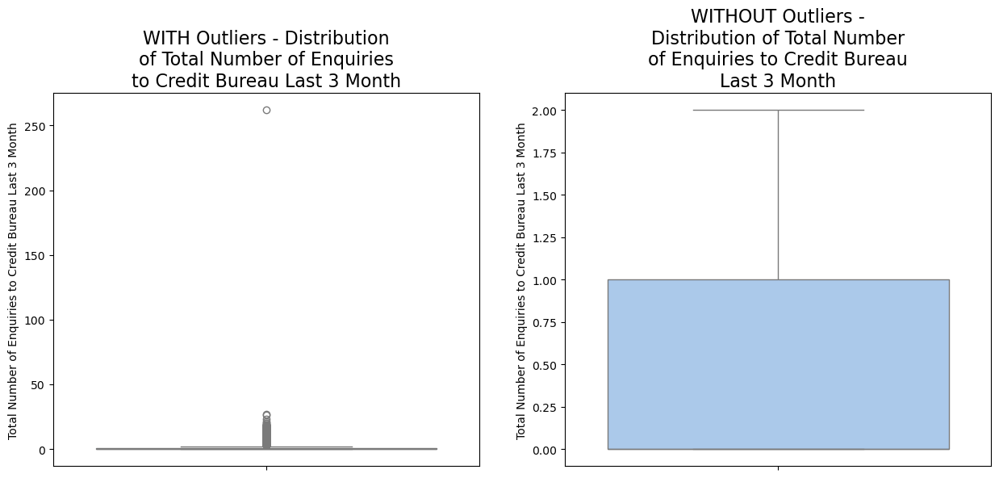

...

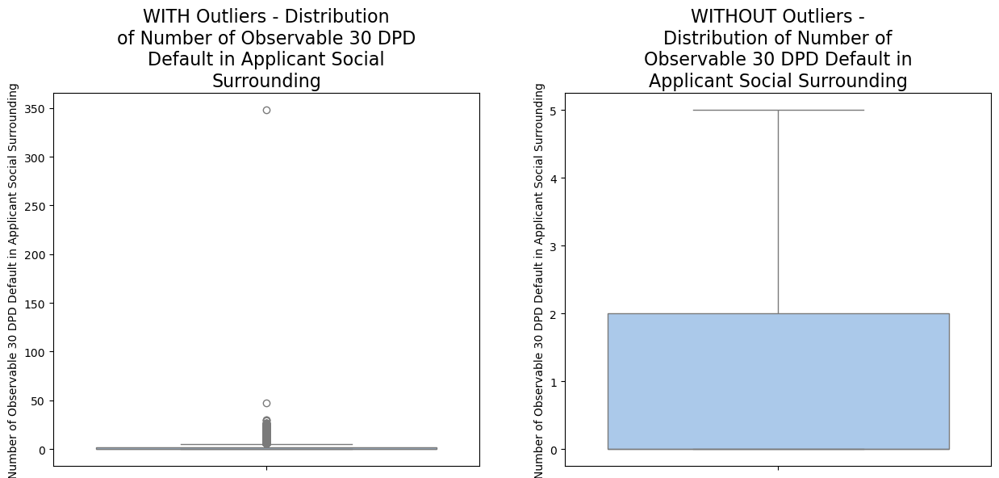

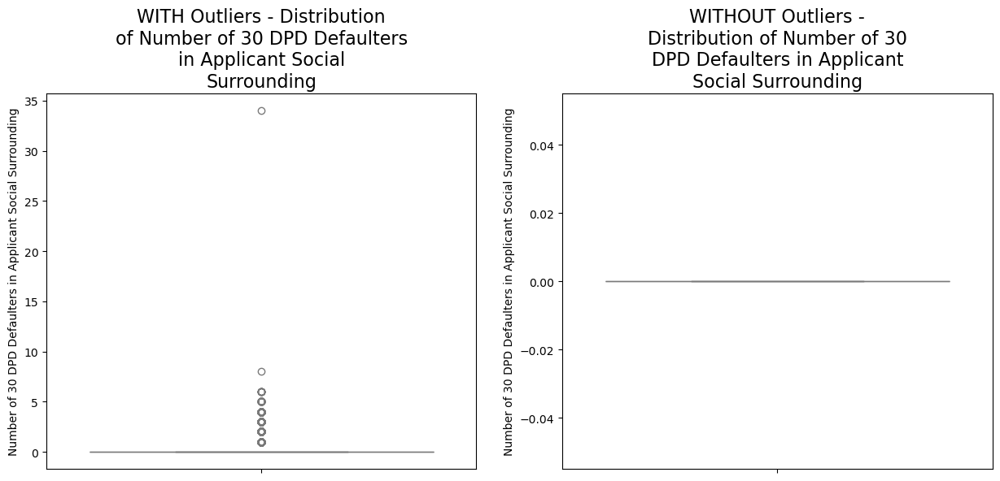

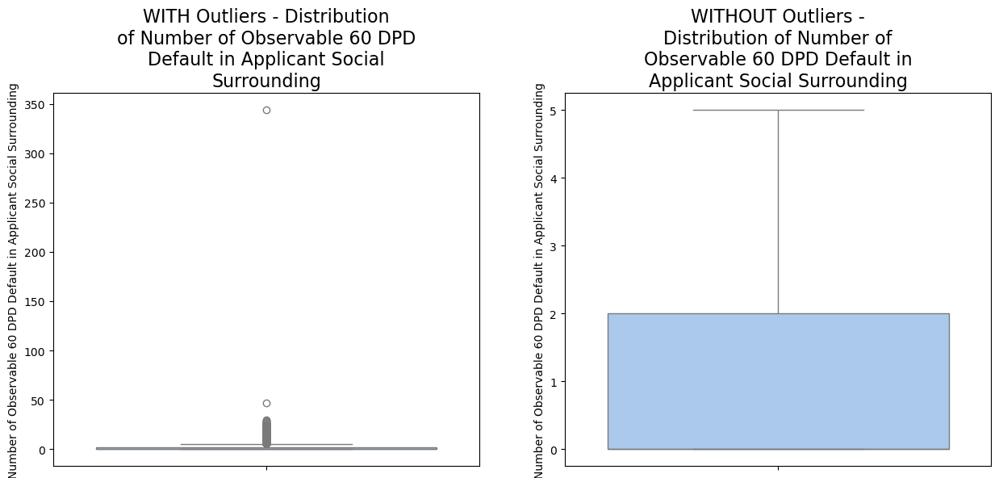

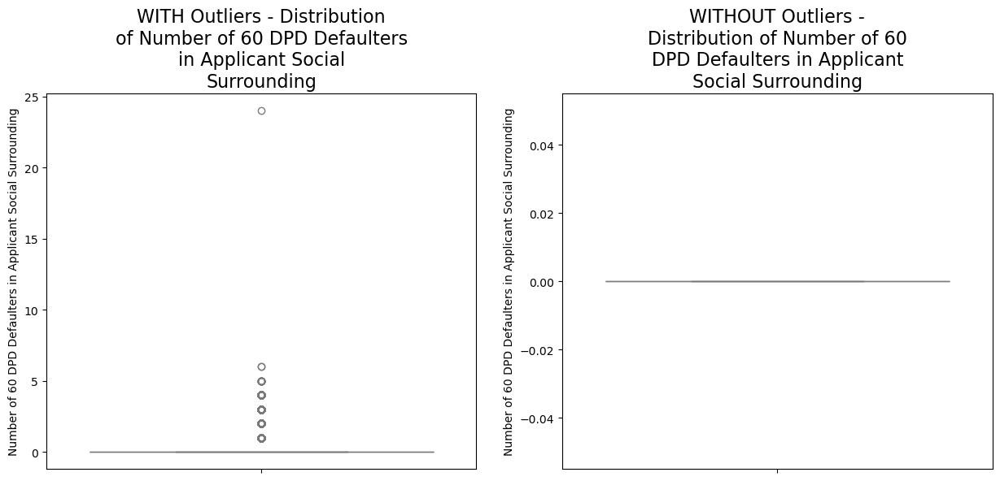

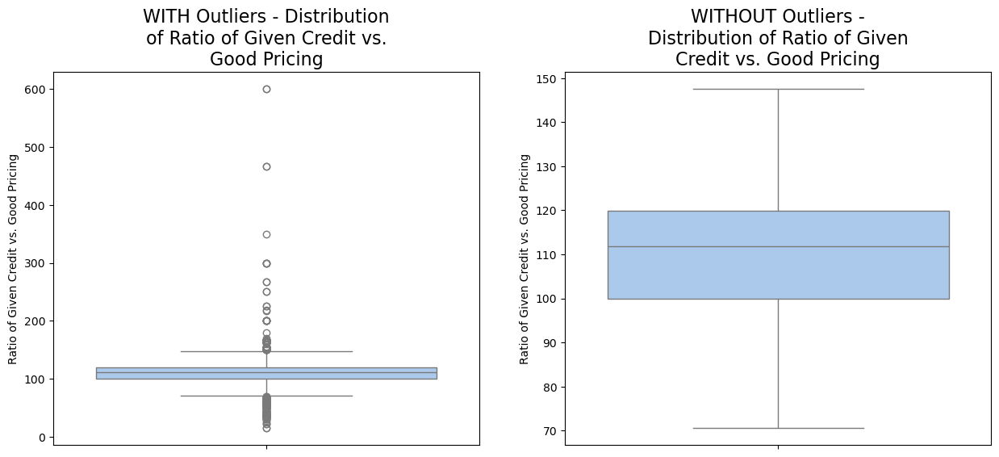

In [301]:
# NUMERICAL DATA - UNIVARIABLE - BOXPLOT FOR OUTLIERS (INCOME)
fbox(df_app,df_app_cat_num_out)

### **2. THE DEFAULTER vs. NON-DEFAULTER? (Segmented Univariable analysis)**

#### **Check data imbalance**

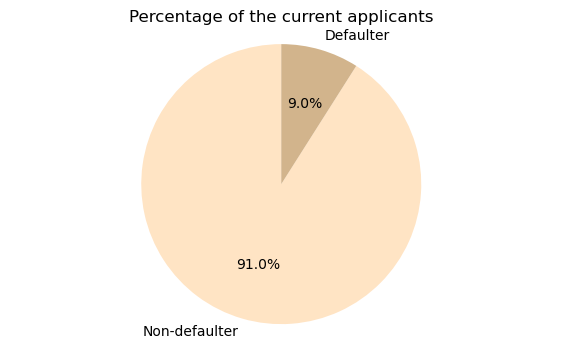

In [321]:
# Calculate the target variable normalized to get the percentage of target variable
pie_target=df_app.TARGET.value_counts(normalize=True).round(2)
# Create the pie chart with titles, labels
value_names={0:'Non-defaulter',1:'Defaulter'}
labels = pie_target.index.map(value_names)
plt.figure(figsize=(7, 4))
plt.pie(pie_target, labels=labels, autopct='%1.1f%%', startangle=90, colors=['bisque','tan'])
plt.axis('equal')
plt.title('Percentage of the current applicants')
plt.draw()
plt.savefig(f'/Users/macbook/Desktop/SUVC/POST-GRAD/Assignment/defaulting.png')
plt.show()
plt.close()

In [323]:
# 91% of current applicants is considered as not having payment difficulties. The number of non-defaulters is significantly dominant

#### **Defaulter vs non-defaulter profiles - catergorical data**

In [326]:
# Profiling comparison
    ## Who are probable to default or defaulter - typical to payment difficulties? (clients who had late payment more than X days on at least one of the first Y installments of the loan in our sample, df_app.TARGET=1)
    ## Who are potential for loan approval - not having payment difficulties)? (df_app.TARGET=0)
# Chart types: stacked bar chart, stacked line chart, adjacent boxplot 

#### **Function to make multiple chart**

In [329]:
df_app.TARGET.value_counts().index

Index([0, 1], dtype='int64', name='TARGET')

In [331]:
# COUNTPLOT WITH A VARIABLE - Function to loop plotting countplot
def fcount_variable(df,df_list,variable):    
    for i in range(len(df_list)):
        # Create a figure size
        num_categories = df[df_list[i]['key']].nunique()
        fig_height=max(3,num_categories)
        fig = plt.figure(figsize=[15, fig_height])
        
        # Fix the order of hue variable
        hue_order = df[variable].value_counts().index.tolist()
        
        # Creating countplot 
        palette=sns.color_palette('pastel',n_colors=2)
        ax = sns.countplot(y=df_list[i]['key'],hue=variable, hue_order=hue_order, data=df, stat='percent', legend='full', 
                           order=df[df_list[i]['key']].value_counts().index, palette=palette)     
        # Adding details to the chart
        plt.yticks(size=12)
        plt.xticks(size=12)
        plt.xlabel(xlabel='Counts', size=14)
        plt.ylabel(ylabel=df_list[i]['value'], size=14)
        plt.title(label=f'Counts of {df_list[i]['value']}', size=16)
        plt.legend(labels=df[variable].value_counts().index, loc='lower right', fontsize=10)
        for container in ax.containers:
            ax.bar_label(container,fmt='%.2f%%')
        # Save fig
        plt.draw()
        plt.savefig(f'/Users/macbook/Desktop/SUVC/POST-GRAD/Assignment/{df_list[i]['key']}.png')
        plt.show()
        plt.close()

In [333]:
# BOXPLOT WITH A VARIABLE - Function to loop plotting countplot
def fbox_variable(df,df_list,variable):   
    for i in range(len(df_list)):
        # Create a figure size
        plt.figure(figsize=[15, 6])
        # **Creating subplot to plot 2 boxplots with and without outliers** 

        # Fix the order of hue variable
        hue_order = df[variable].value_counts().index.tolist()
        
        # Plotting the one with outliers
        plt.subplot(1,2,1)
        sns.boxplot(data=df, x=variable,y=df[df_list[i]['key']],color=sns.color_palette('pastel')[0])
        plt.title(textwrap.fill(f'WITH Outliers - Distribution of {df_list[i]['value']}', width=30), size=16)
        plt.xticks(ticks=[0,1], labels=hue_order)
        plt.ylabel(ylabel=df_list[i]['value'], size=10)
        
        # Plotting the one without outliers
        Q1 = df[df_list[i]['key']].quantile(0.25)
        Q3 = df[df_list[i]['key']].quantile(0.75)
        IQR = Q3 - Q1
        lower=Q1 - 1.5 * IQR
        upper=Q3 + 1.5 * IQR
        df_no_outliers = df[(df[df_list[i]['key']]>=lower)&(df[df_list[i]['key']]<=upper)]
        plt.subplot(1,2,2)
        sns.boxplot(data=df, x=variable,y=df_no_outliers[df_list[i]['key']], color=sns.color_palette('pastel')[0])
        plt.title(textwrap.fill(f'WITHOUT Outliers - Distribution of {df_list[i]['value']}', width=30), size=16)
        plt.xticks(ticks=[0,1], labels=hue_order)
        plt.ylabel(ylabel=df_list[i]['value'], size=10)
        # Save fig
        plt.draw()
        plt.savefig(f'/Users/macbook/Desktop/SUVC/POST-GRAD/Assignment/{df_list[i]['key']}.png')
        plt.show()
        plt.close()

#### **Chart Plotting**

In [336]:
df_app['TARGET LABEL']=df_app['TARGET'].replace({0:'Non-defaulters', 1:'Defaulters'})

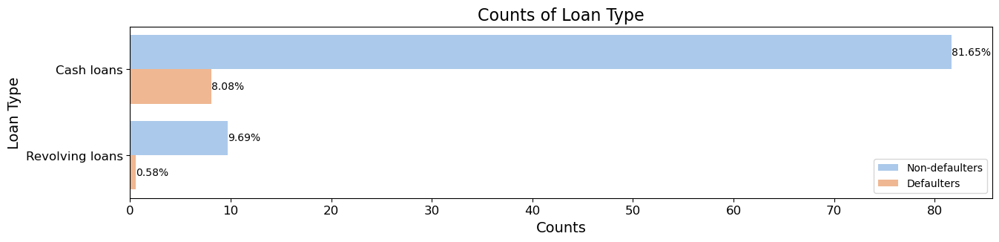

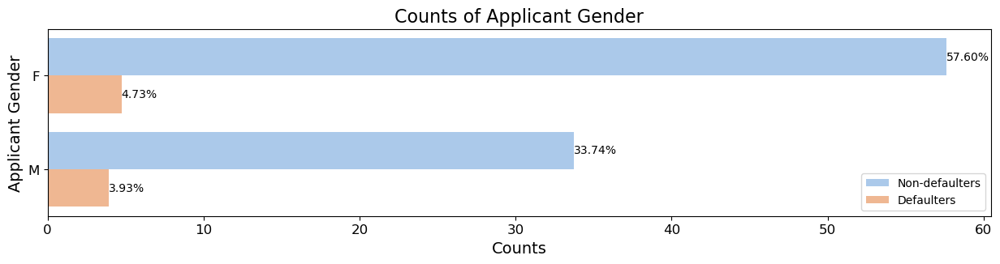

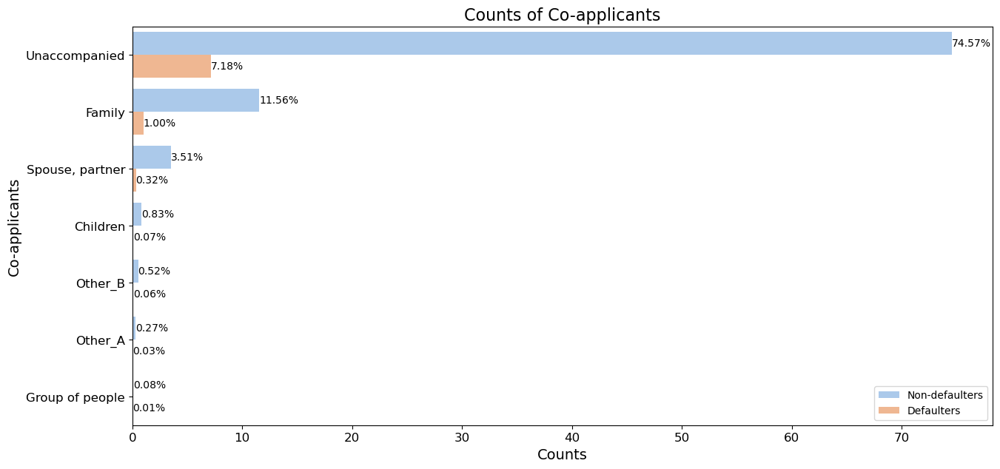

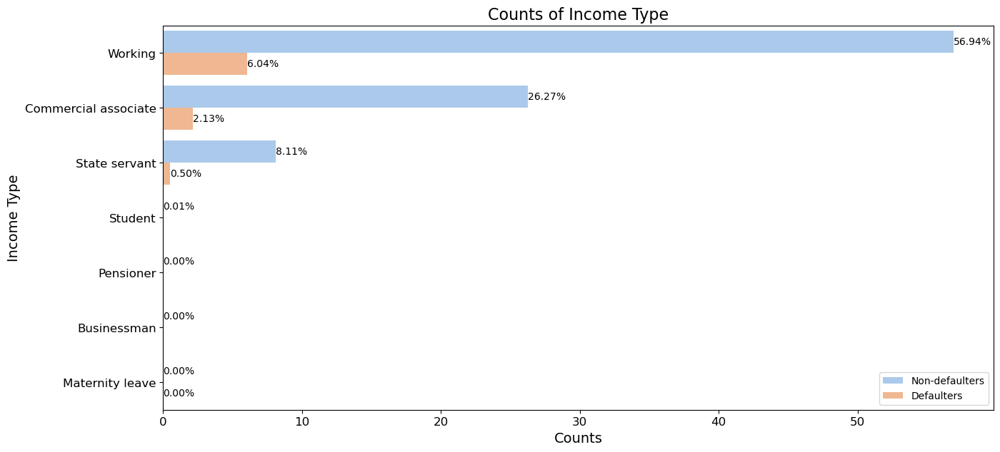

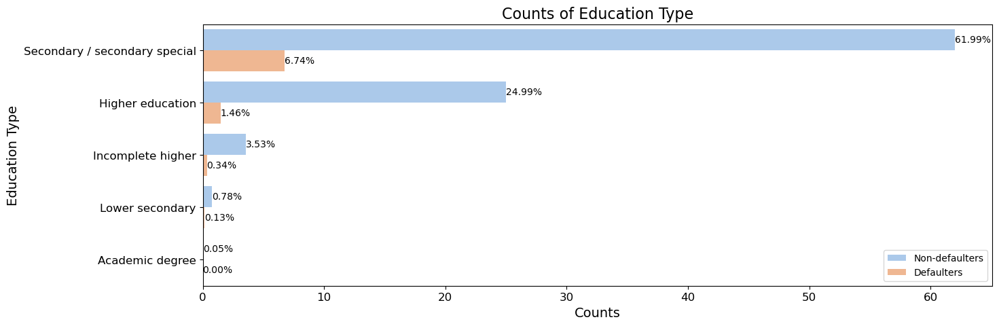

...

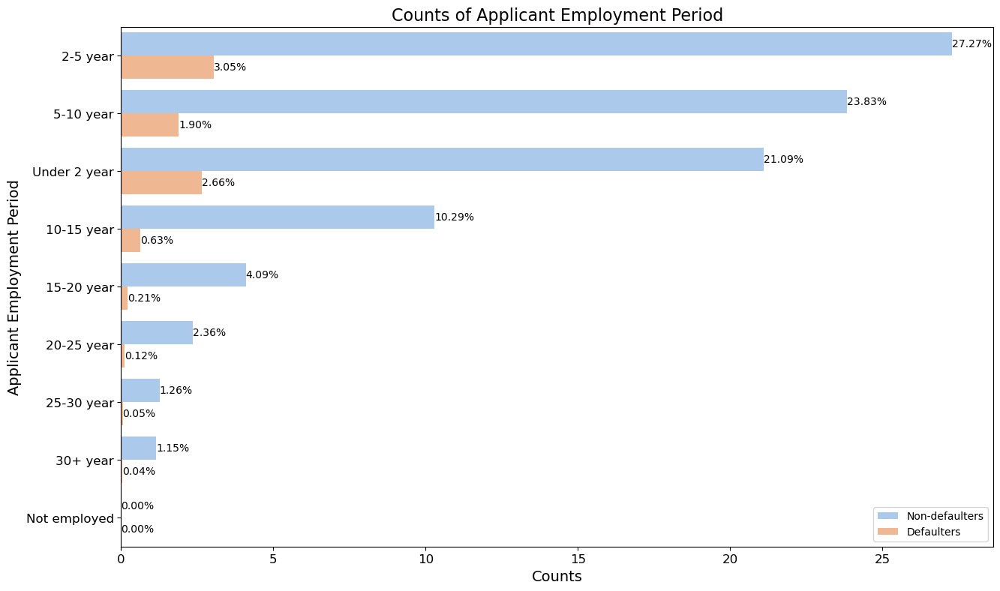

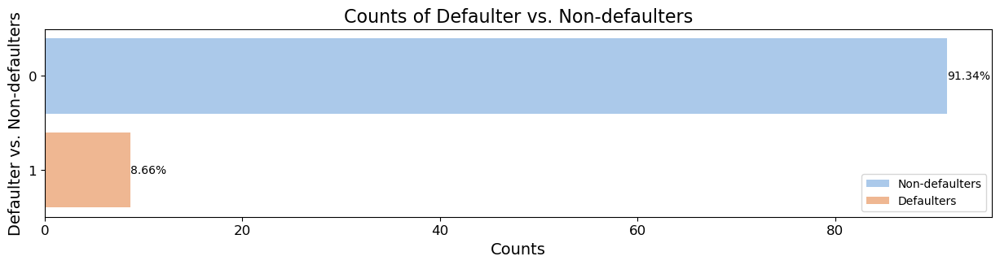

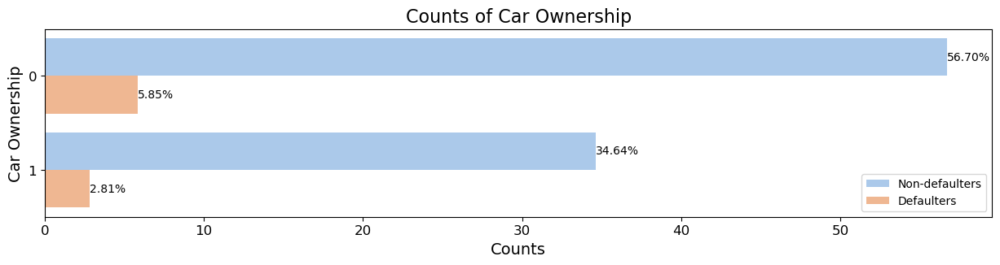

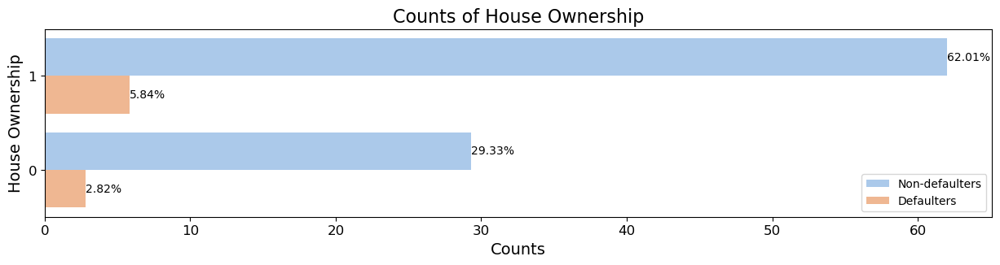

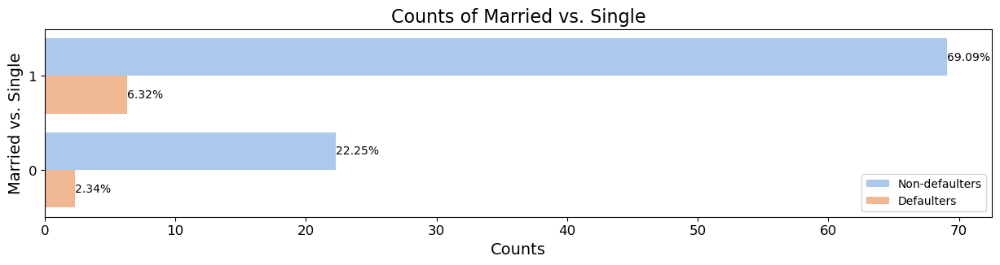

In [338]:
# CATEGORIAL DATA - UNIVARIABLE
fcount_variable(df_app,df_app_cat,'TARGET LABEL')

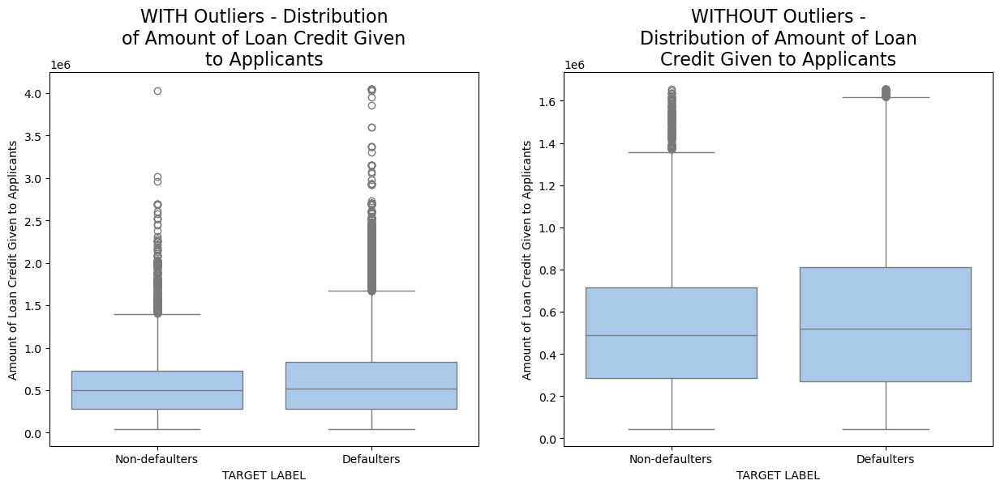

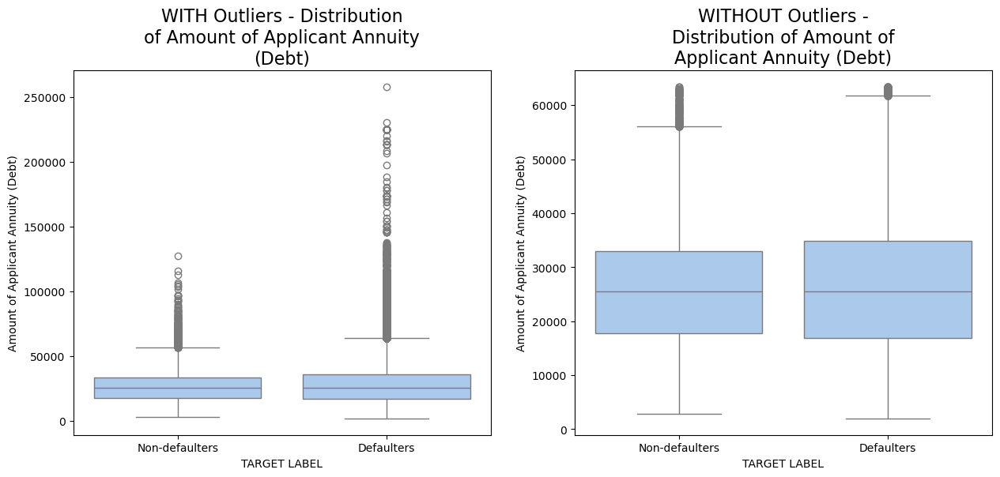

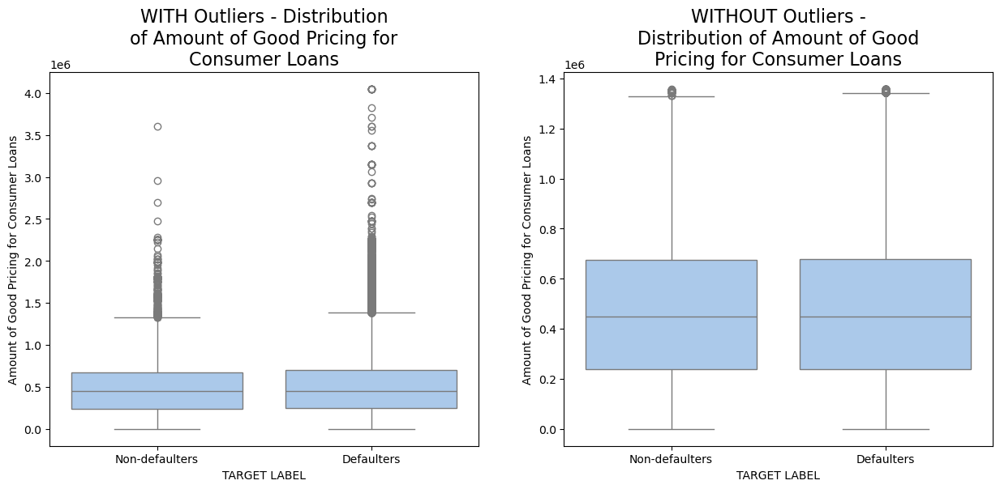

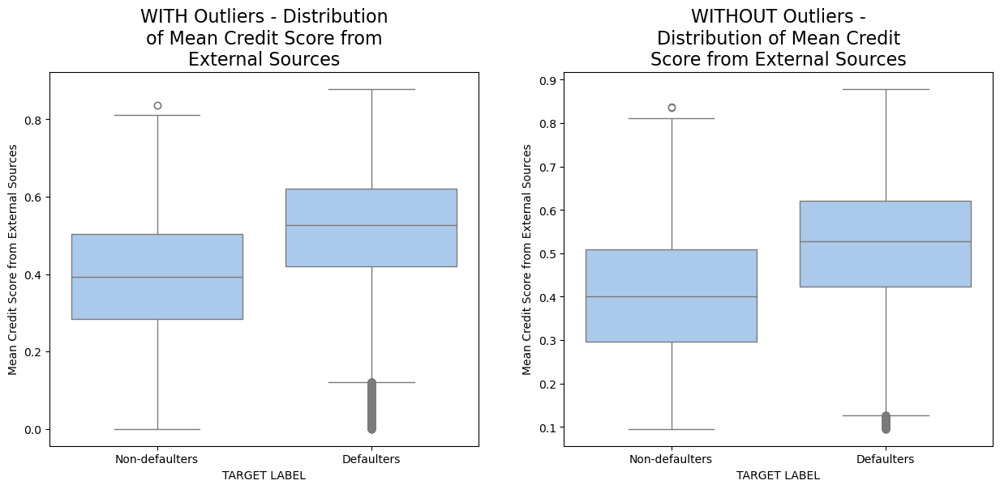

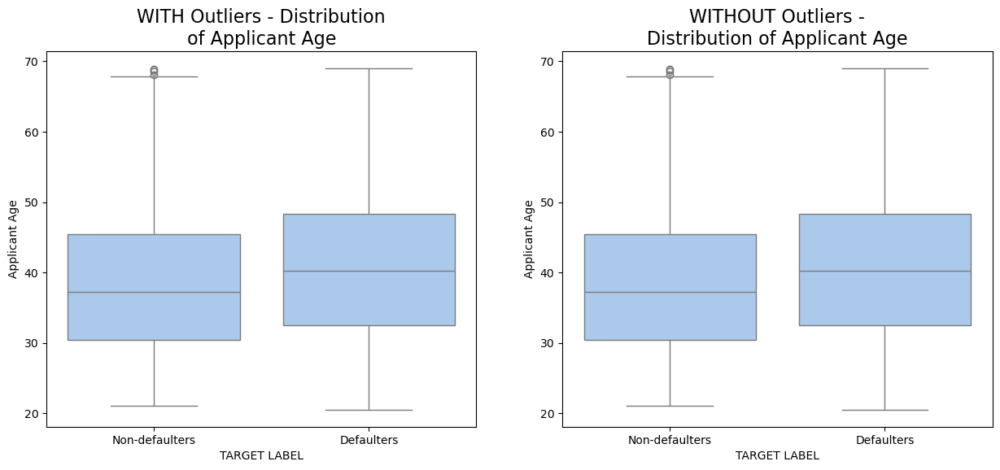

...

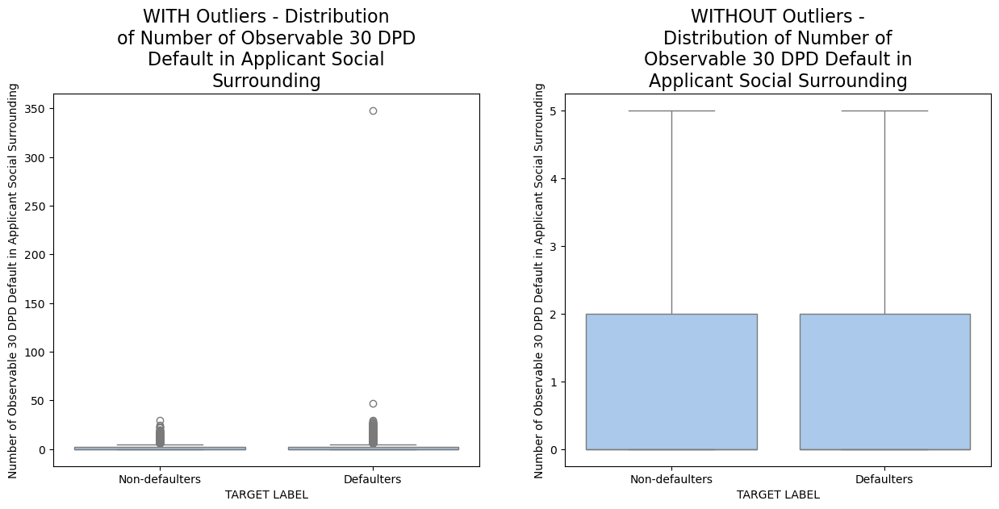

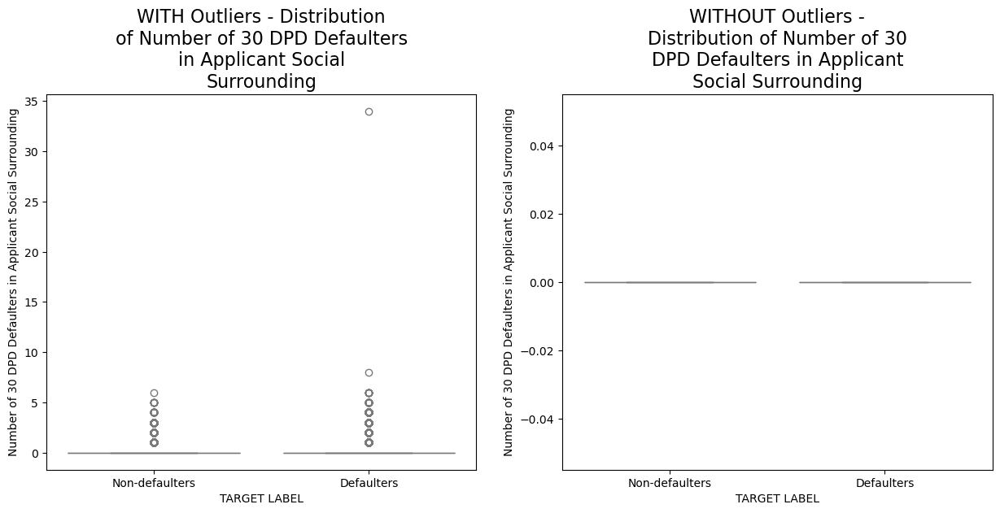

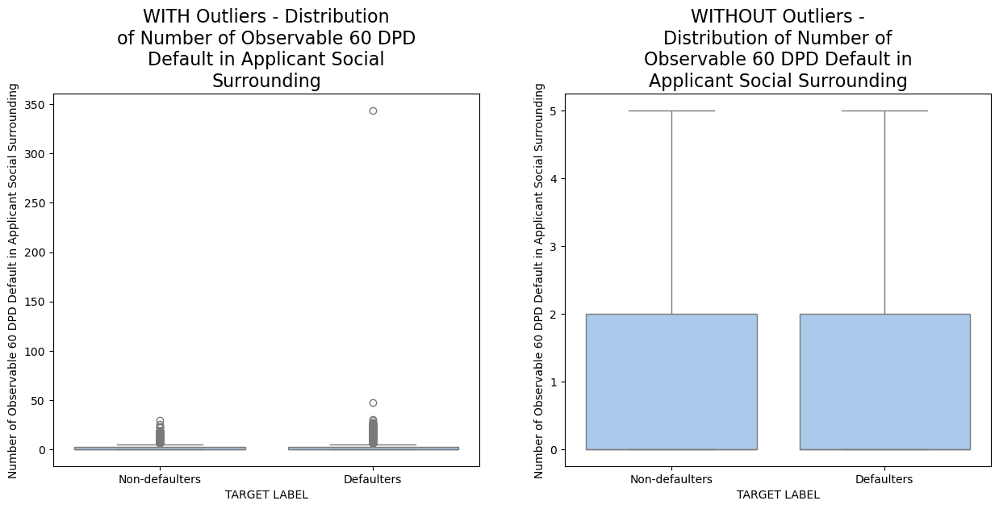

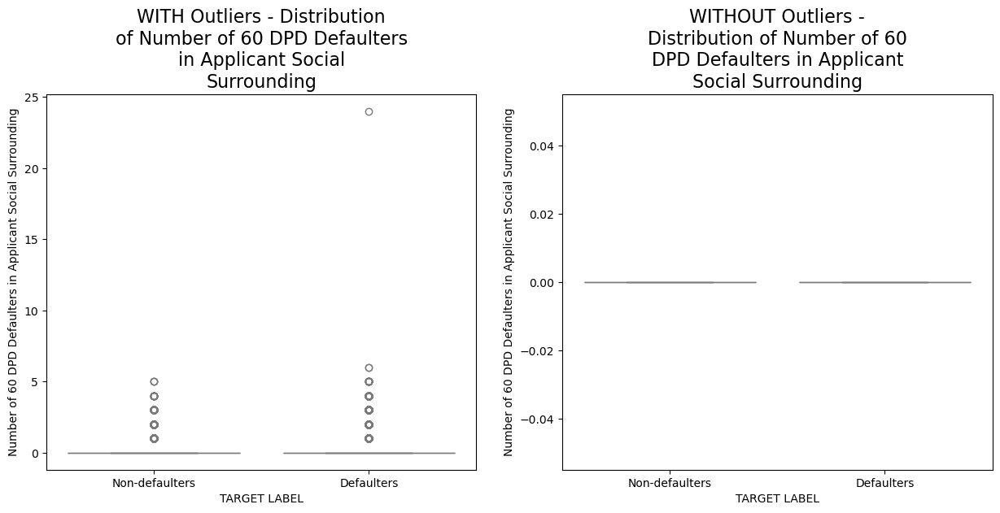

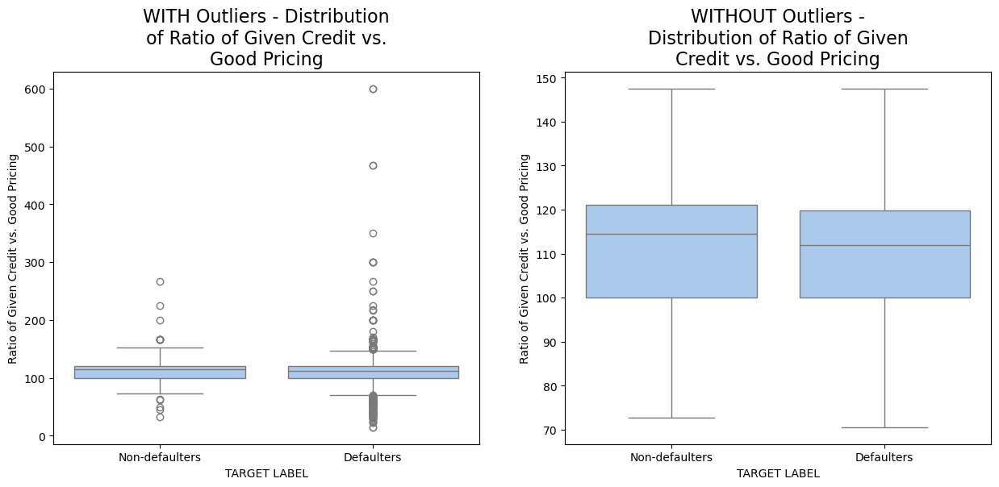

In [421]:
# NUMERICAL DATA - UNIVARIABLE - BOXPLOT
fbox_variable(df_app,df_app_num,'TARGET LABEL')

### **3. KEY VARIABLES CROSS ANALYSIS - CURRENT APPLICATION (Bivariate analysis)**

#### **Function to plot multiple scatter chart**

In [342]:
# SCATTER PLOT OF 2 SET NUMERICAL DATA - Function to loop plotting scatterplot
def fscatter_variable(df,df_list, variable, hue):    
    for i in range(len(df_list)):
        # Create a figure size
        plt.figure(figsize=[15, 6])
        sns.scatterplot(data=df, y=variable, x=df_list[i]['key'], hue=hue, color=sns.color_palette('pastel')[0])
        plt.title(f'Correllation of {df_list[i]['value']} and {variable}')
        plt.xlabel(xlabel=df_list[i]['key'], size=10)
        plt.ylabel(ylabel=variable, size=10)
        # Save fig
        plt.draw()
        plt.savefig(f'/Users/macbook/Desktop/SUVC/POST-GRAD/Assignment/{df_list[i]['key']}.png')
        plt.show()
        plt.close()

#### **Chart Plotting**

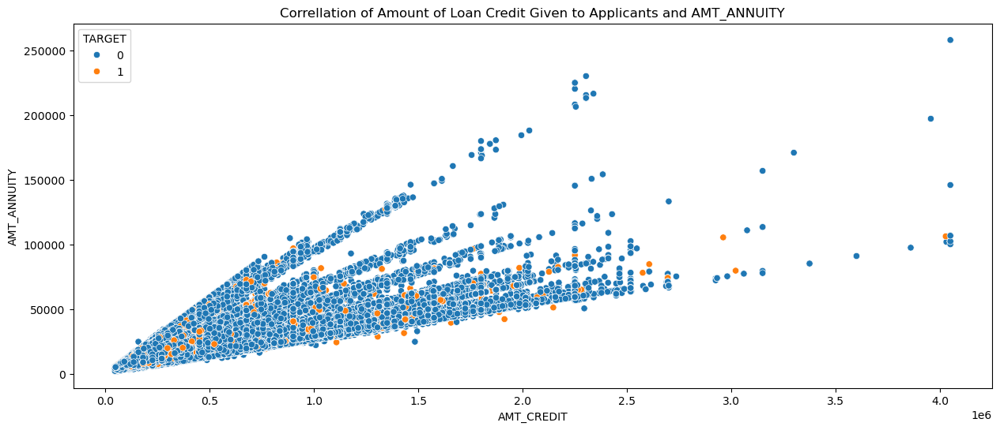

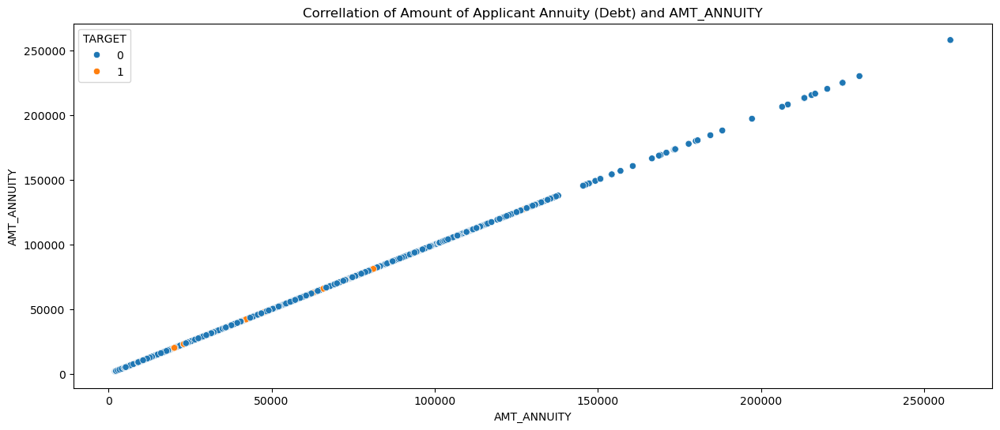

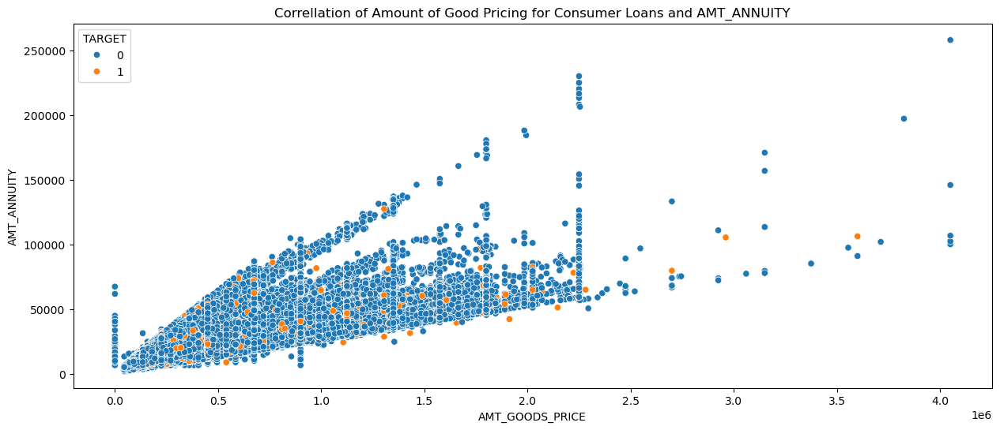

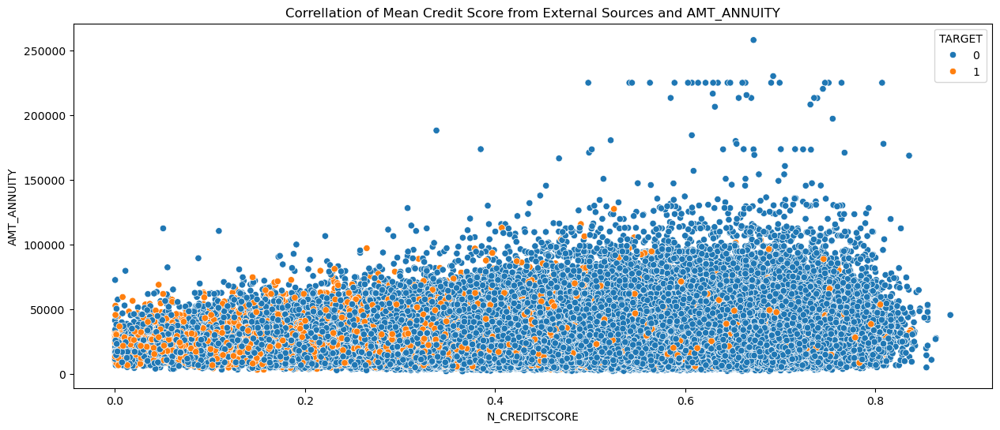

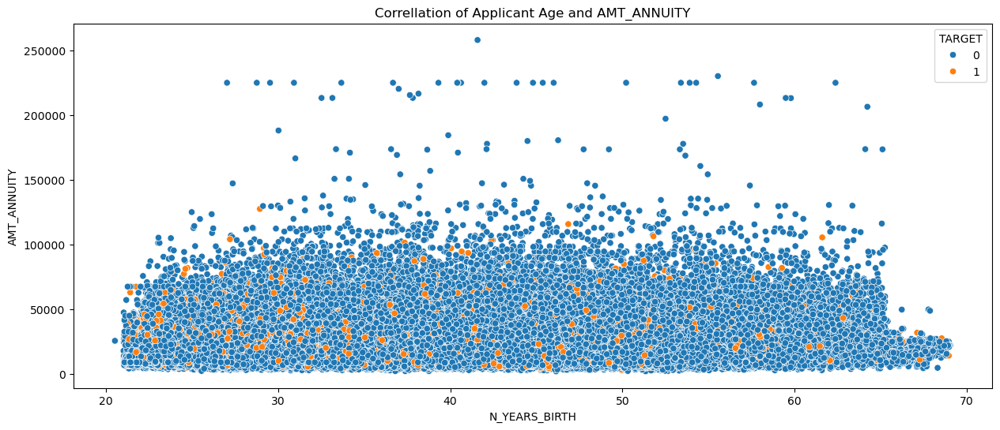

...

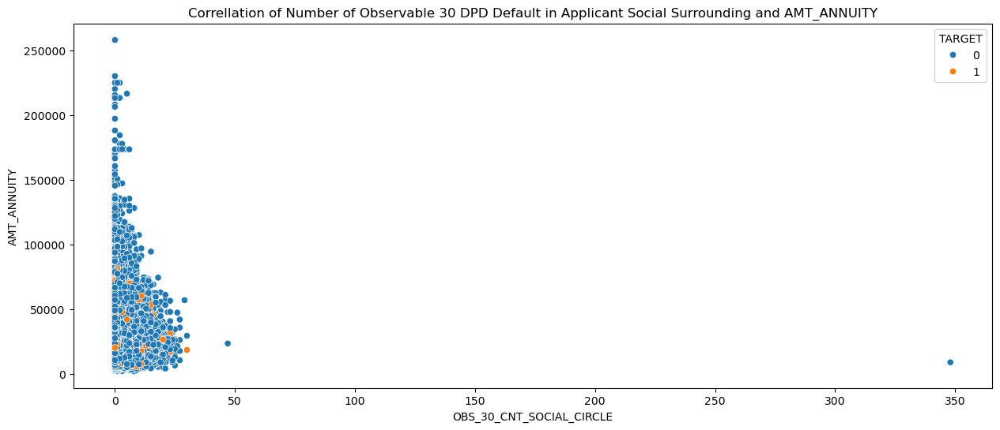

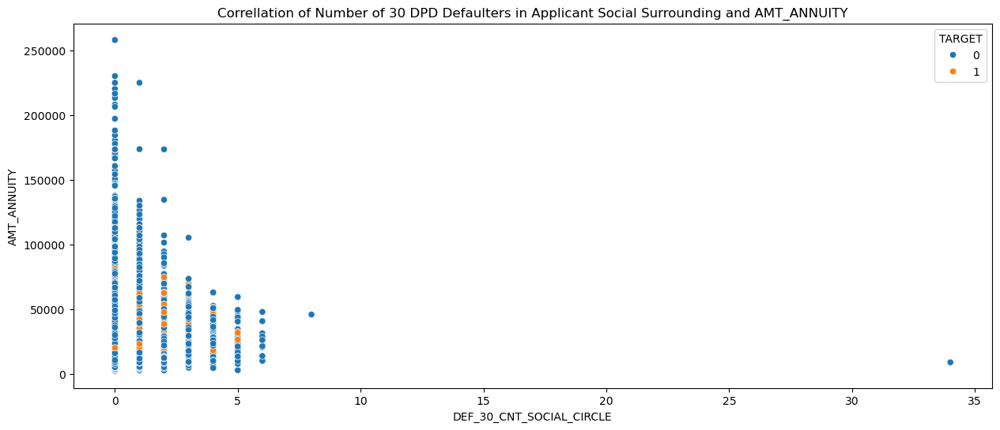

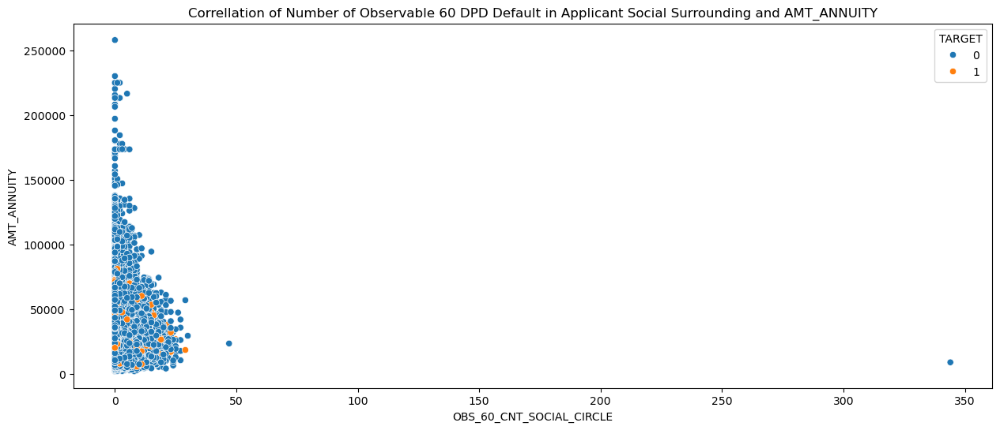

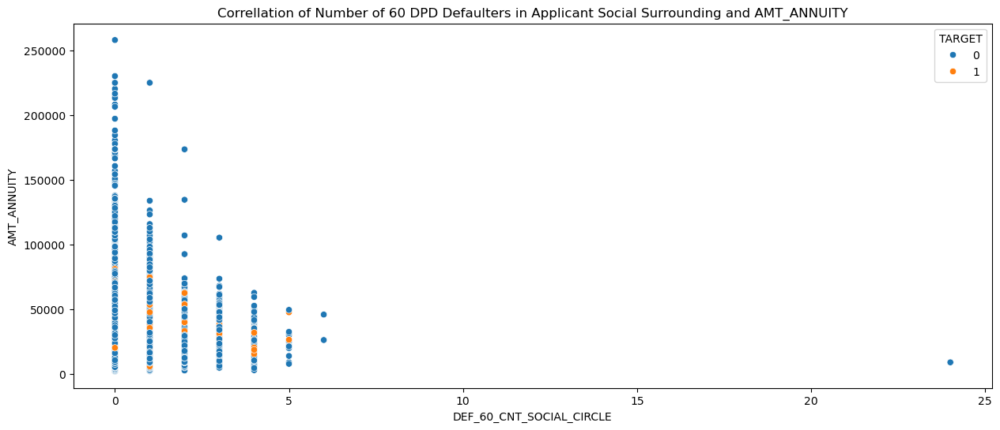

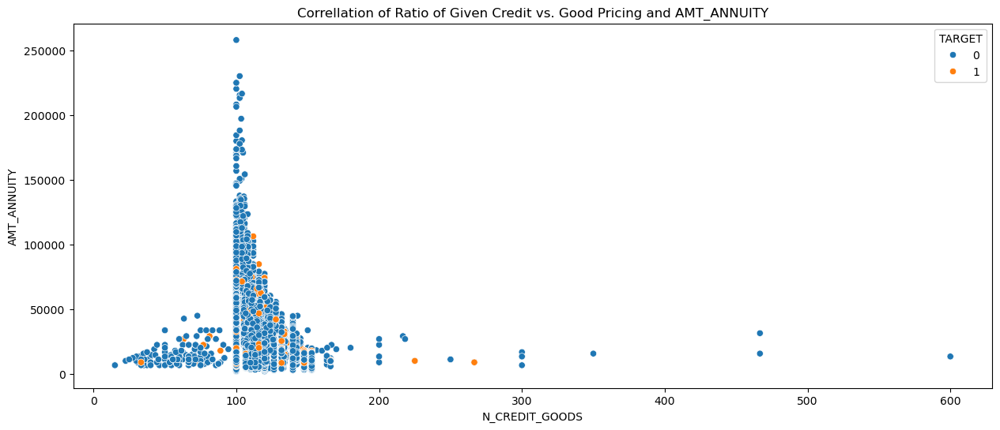

In [344]:
## NUMERICAL vs. NUMERICAL - 'AMT_ANNUITY'
fscatter_variable(df_app,df_app_num,'AMT_ANNUITY','TARGET')

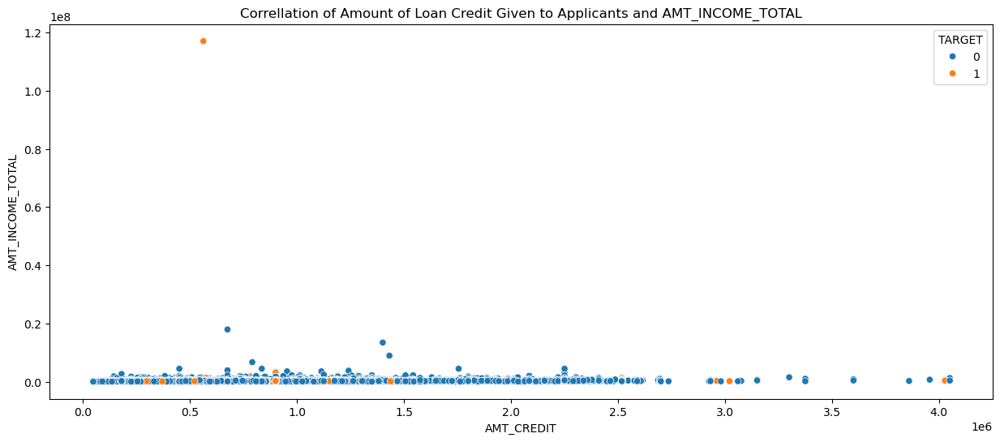

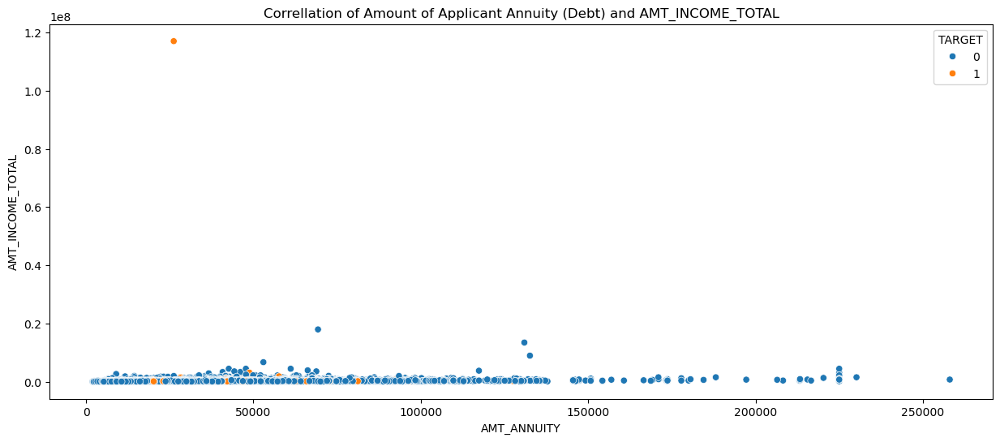

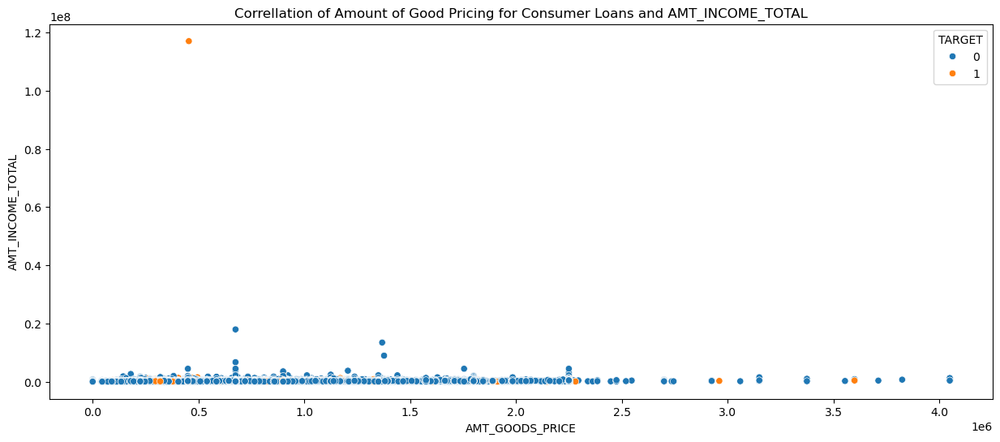

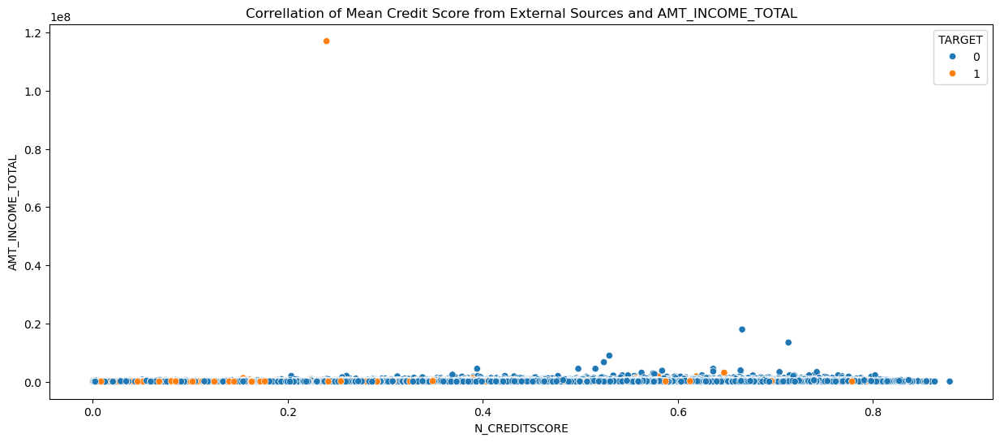

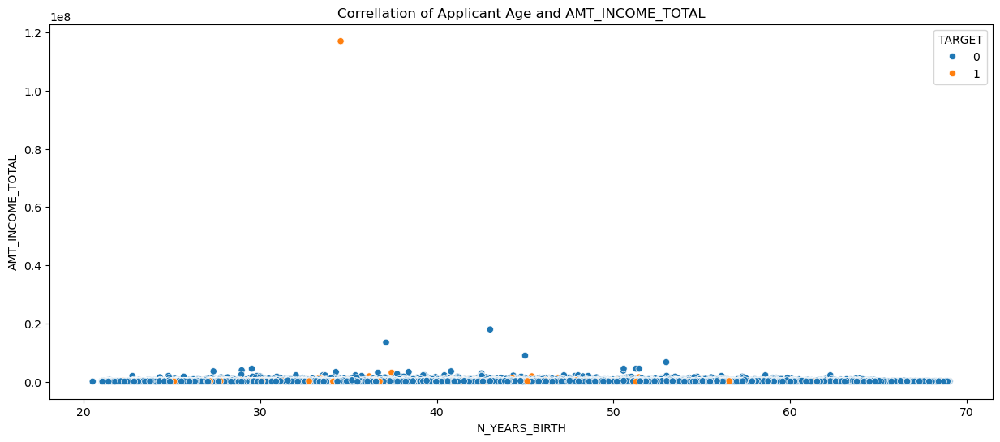

...

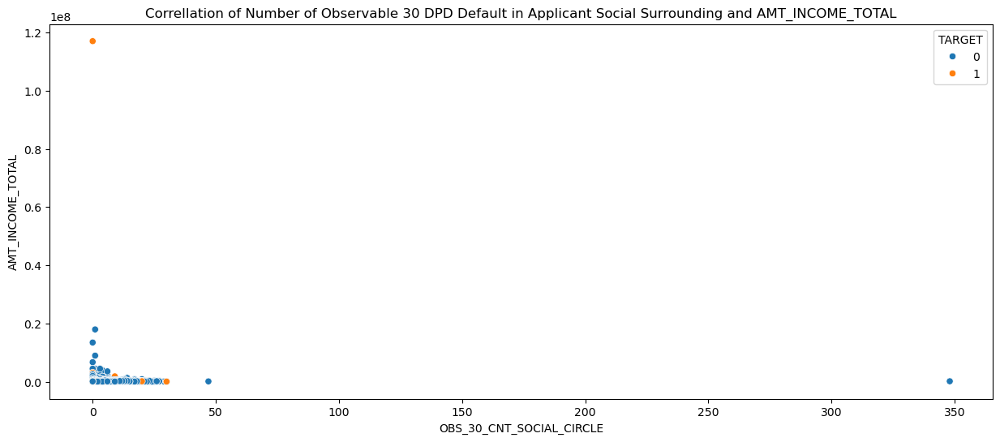

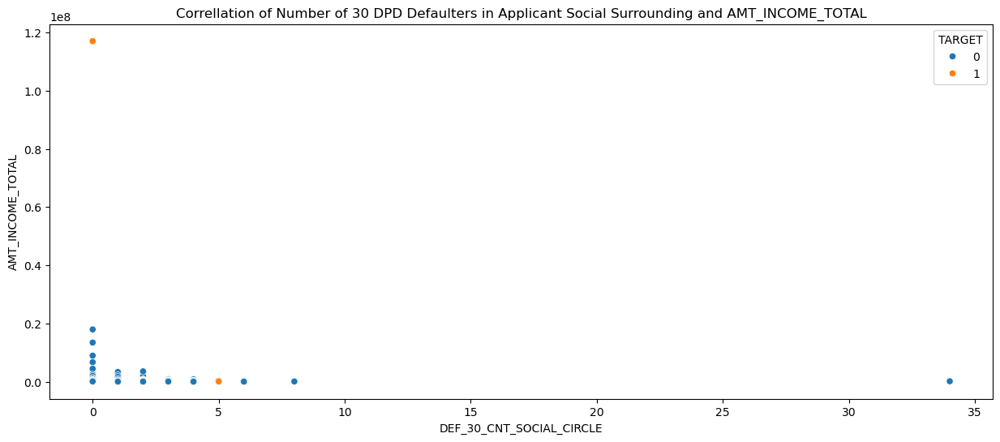

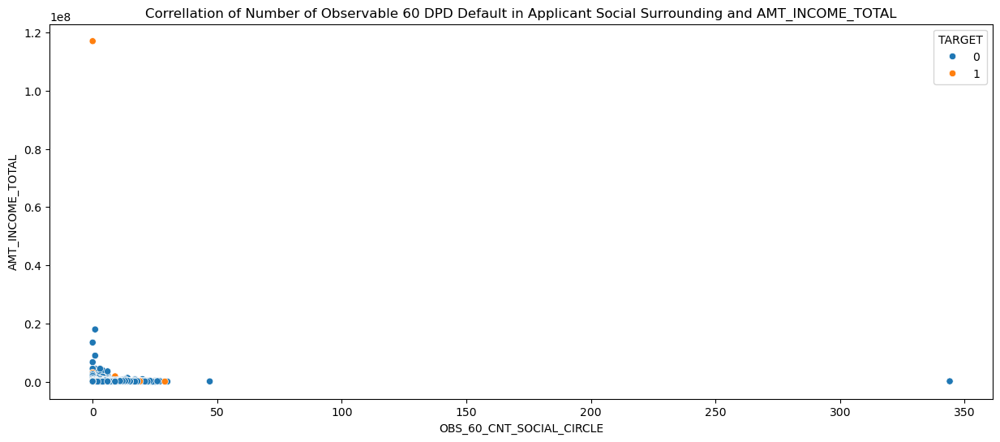

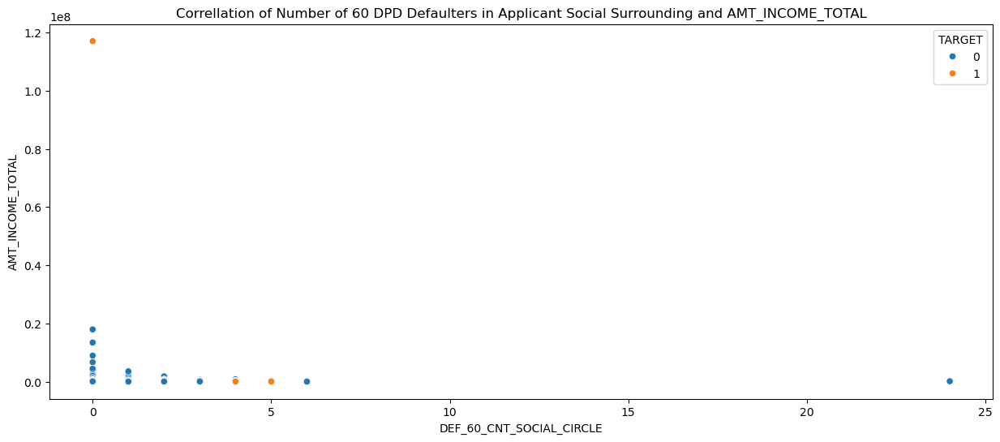

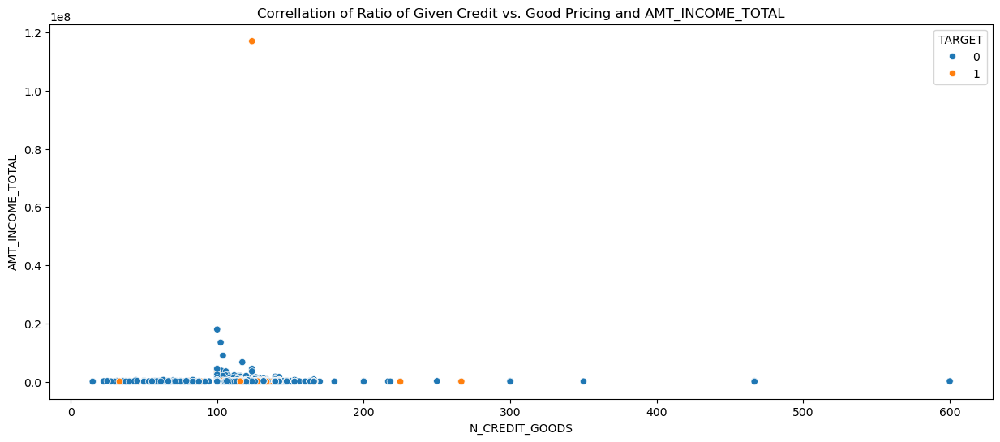

In [346]:
## NUMERICAL vs. NUMERICAL - 'AMT_INCOME_TOTAL'
fscatter_variable(df_app,df_app_num,'AMT_INCOME_TOTAL','TARGET')

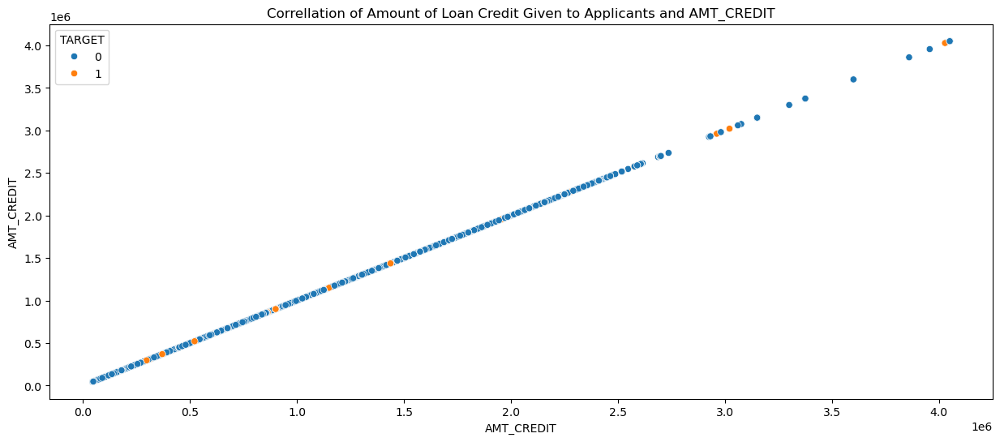

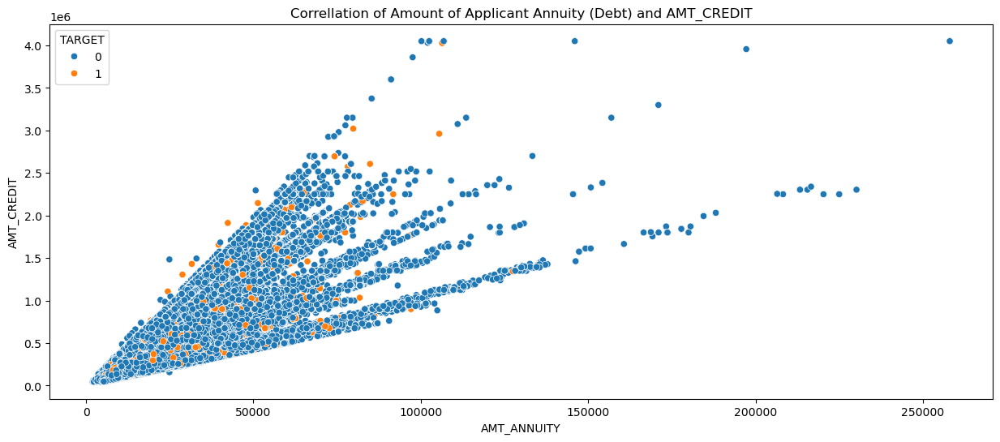

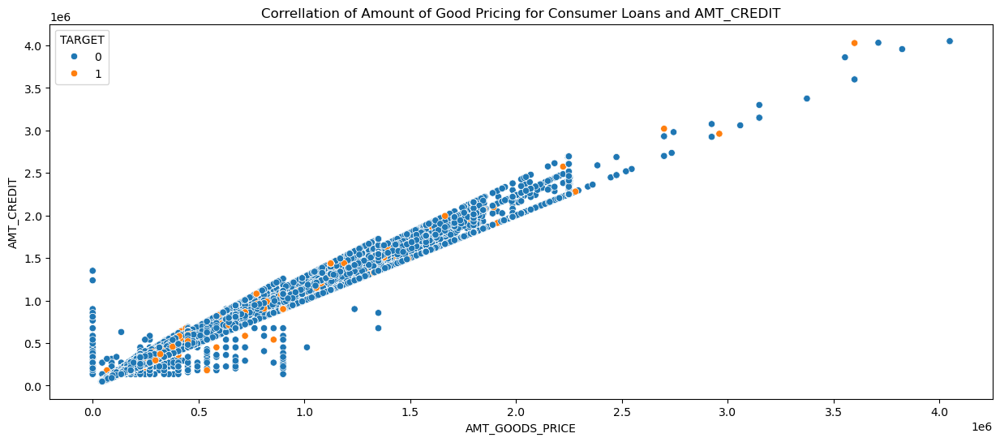

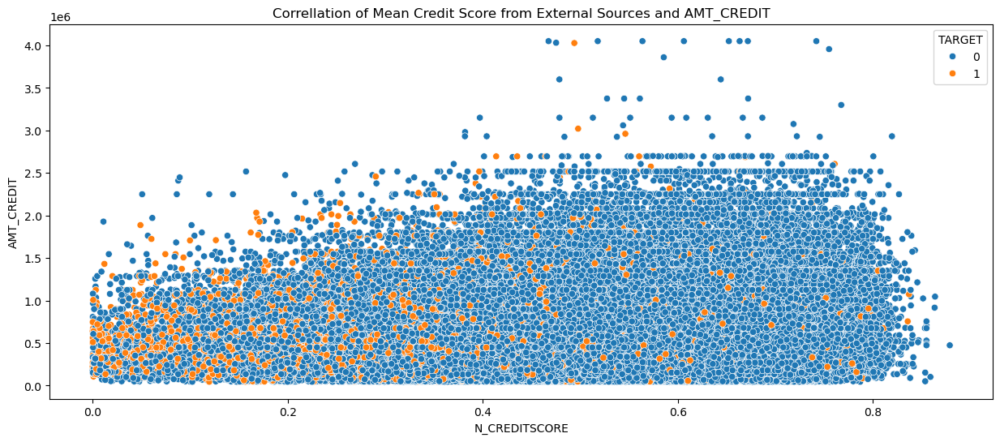

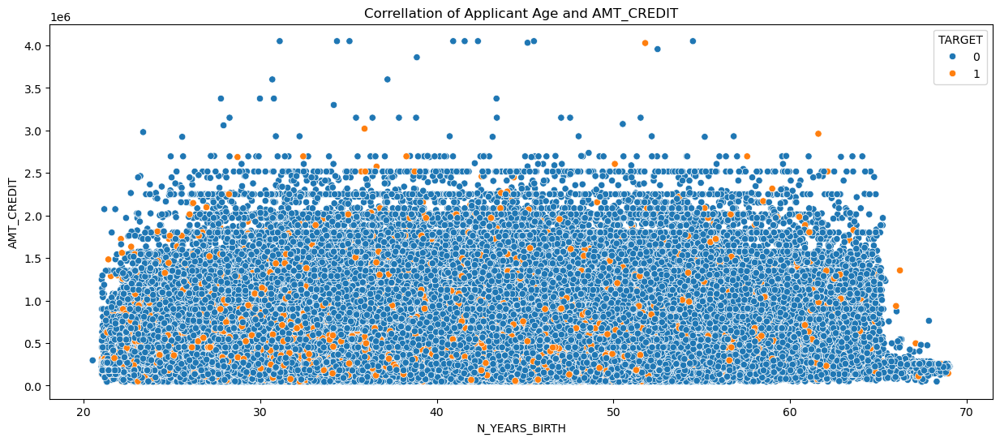

...

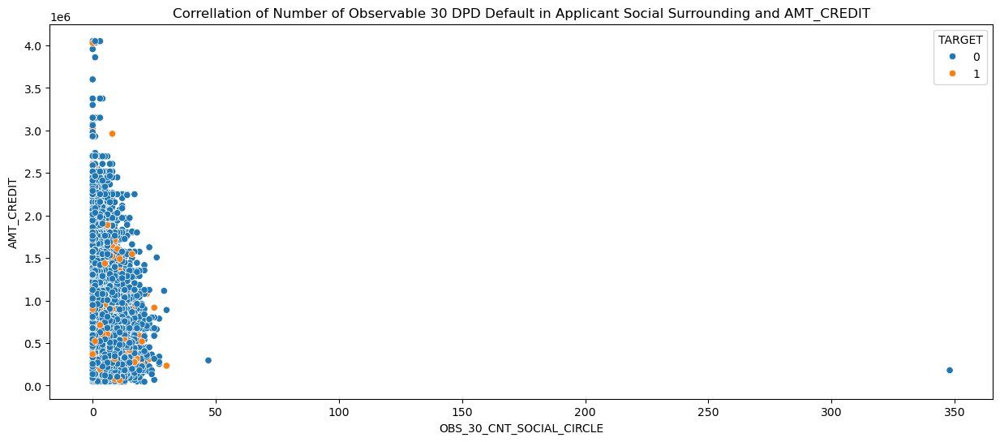

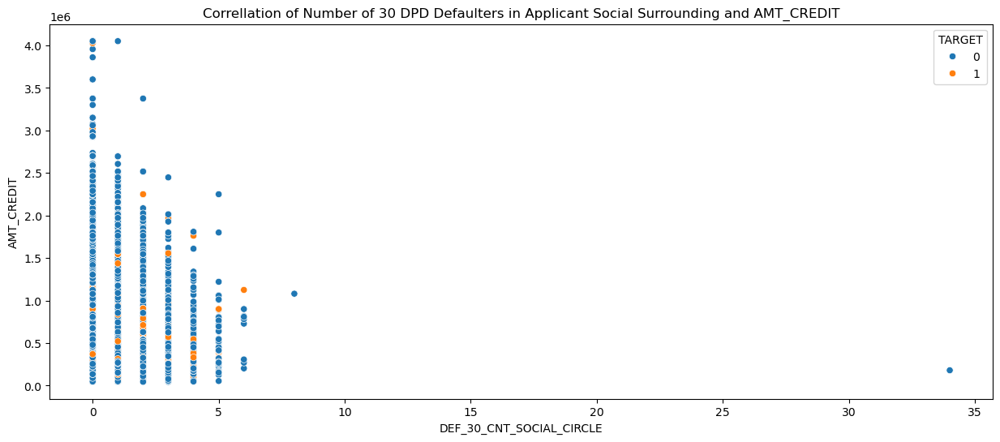

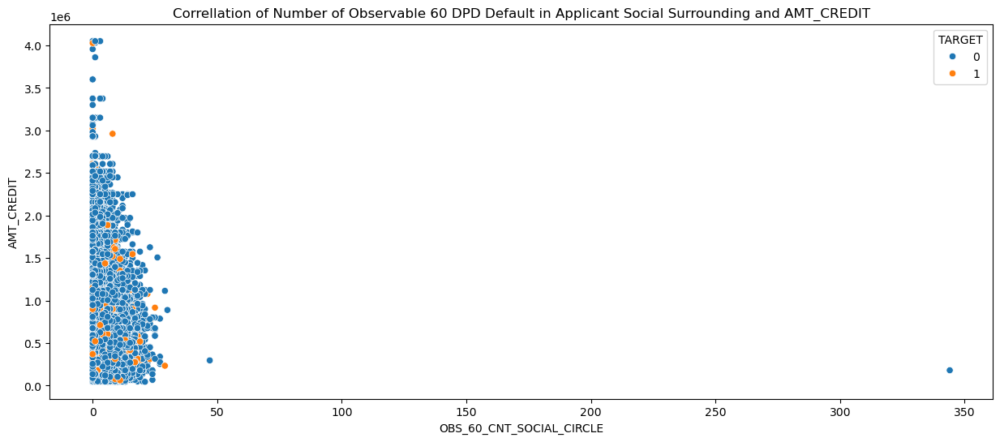

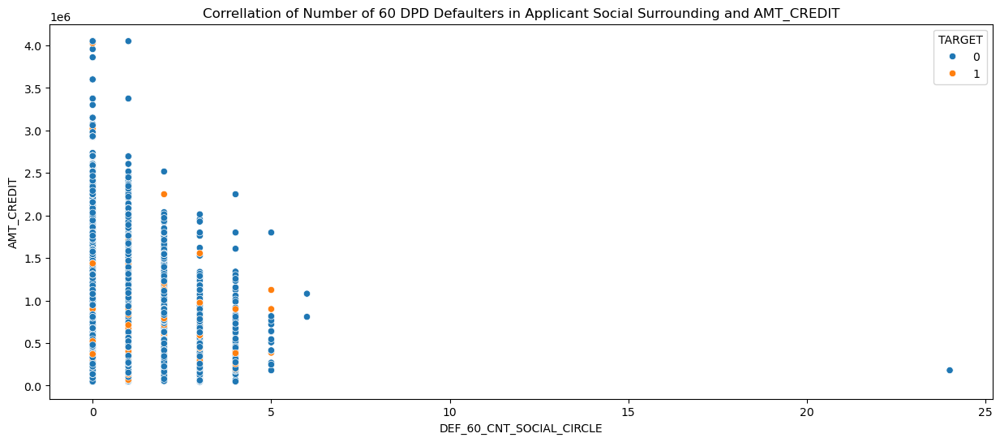

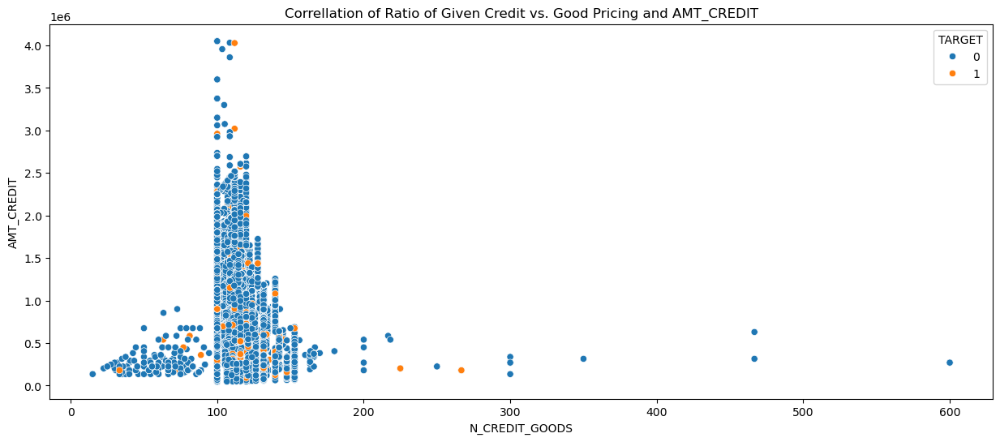

In [348]:
## NUMERICAL vs. NUMERICAL - 'AMT_CREDIT'
fscatter_variable(df_app,df_app_num,'AMT_CREDIT','TARGET')

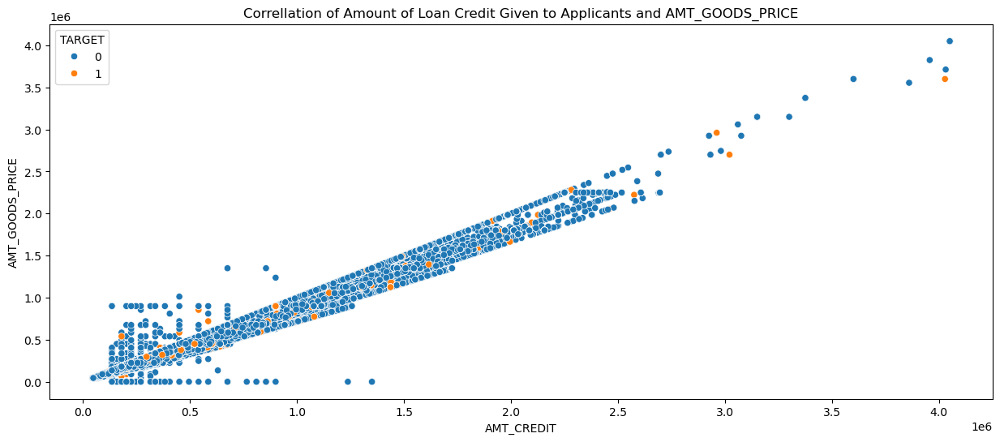

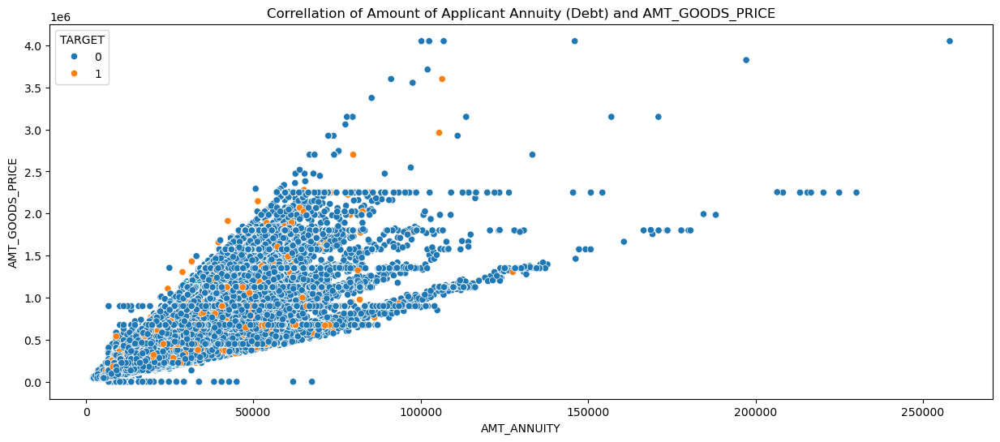

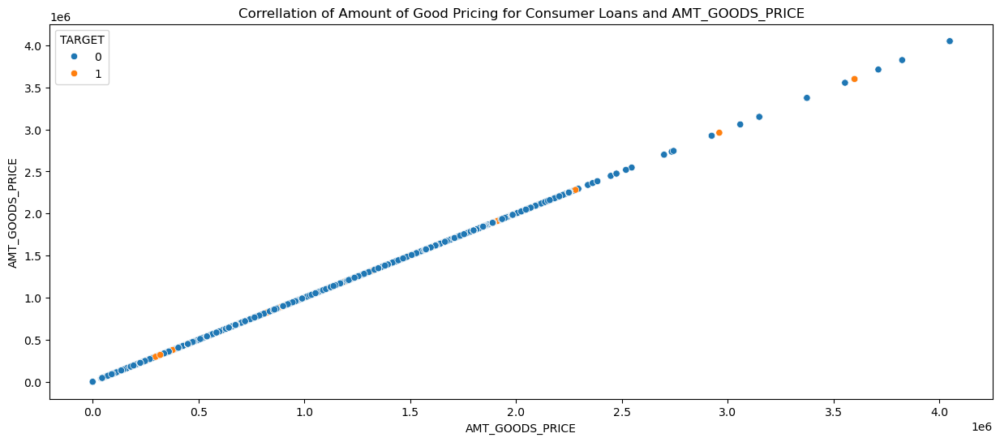

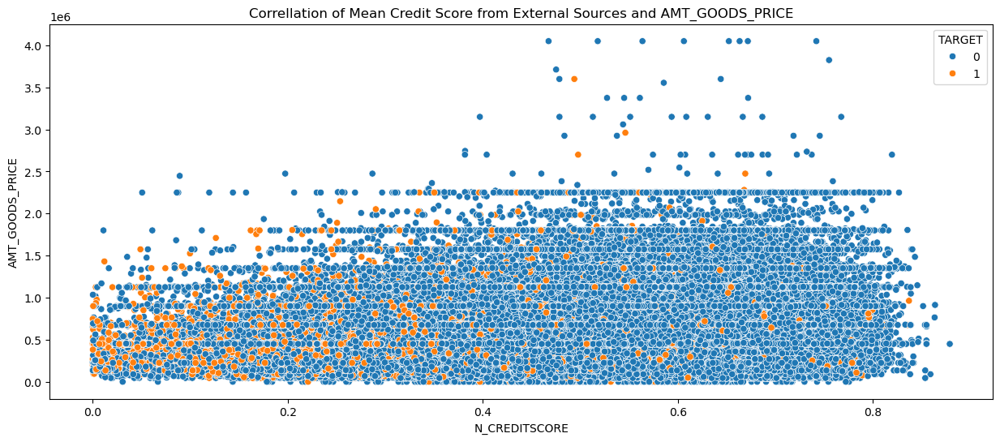

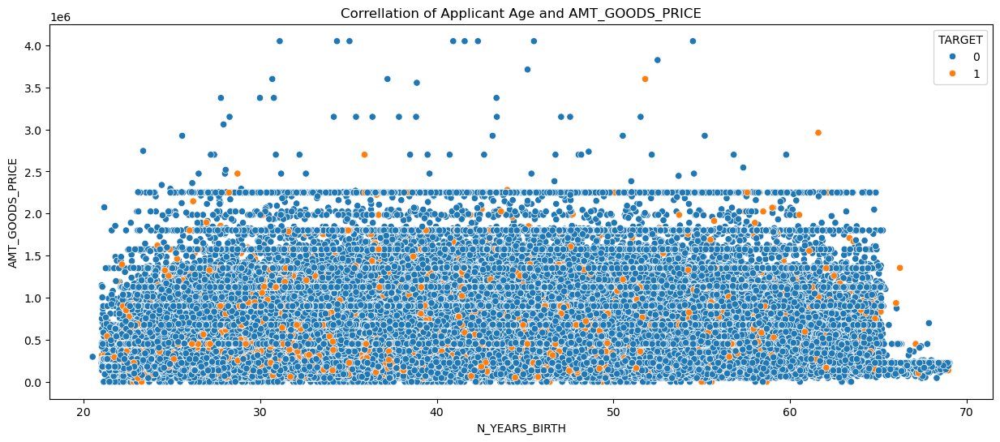

...

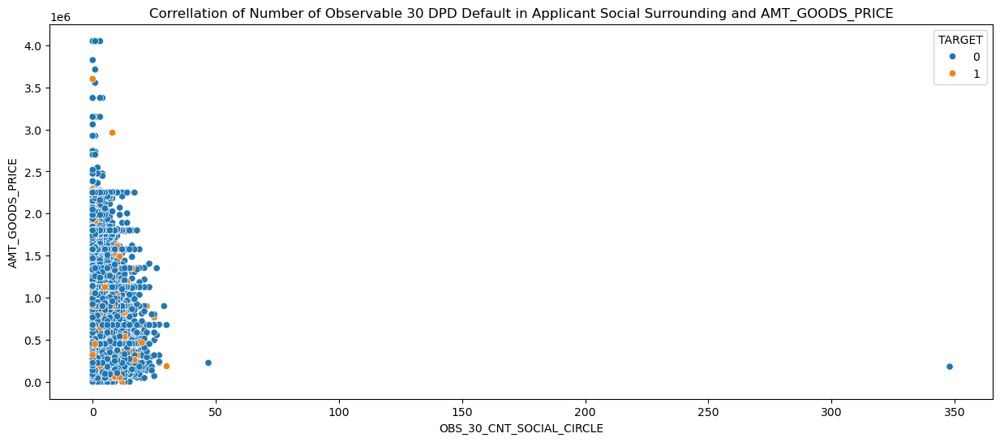

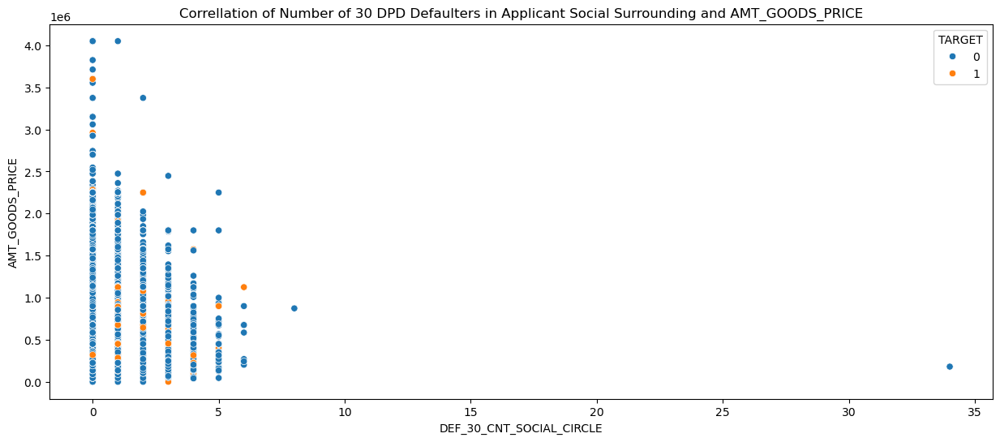

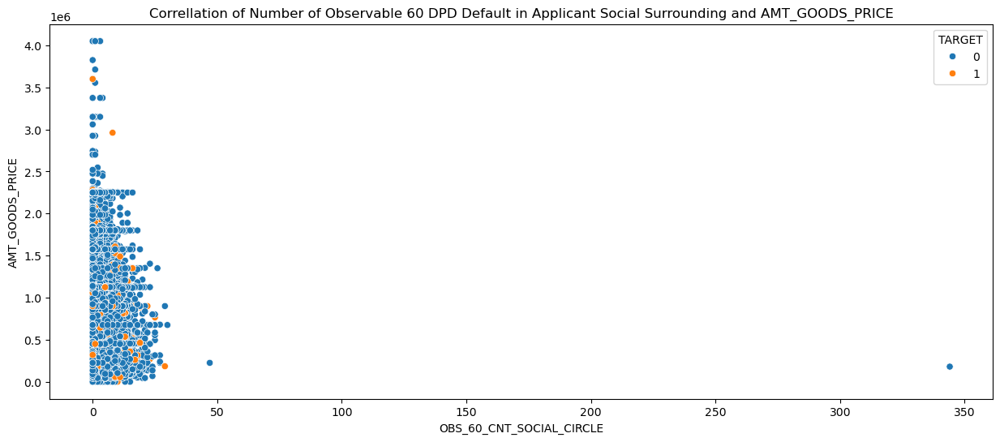

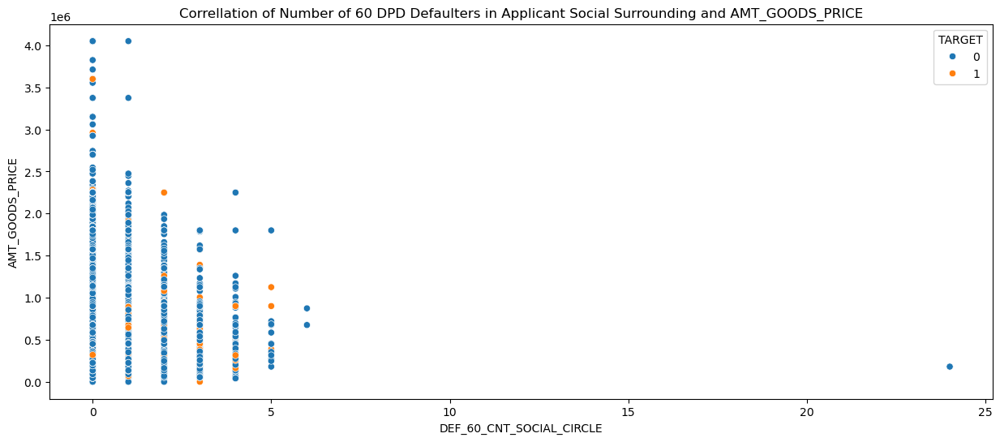

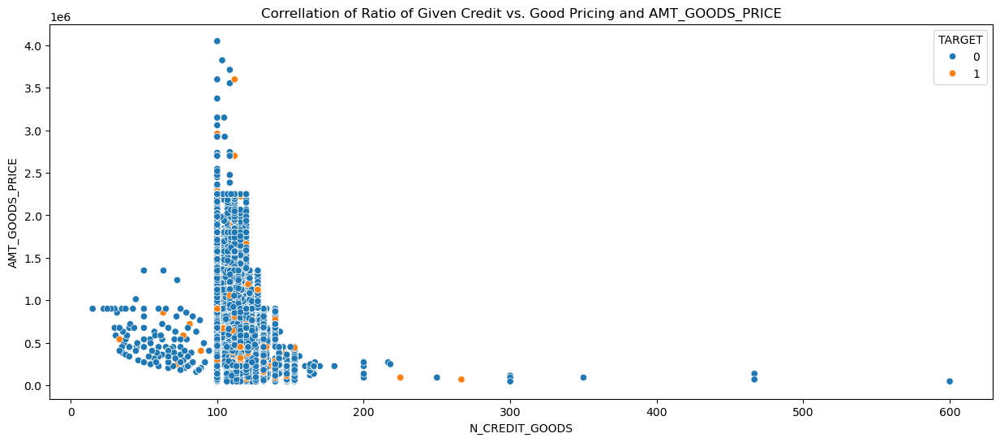

In [350]:
## NUMERICAL vs. NUMERICAL - 'AMT_GOODS_PRICE'
fscatter_variable(df_app,df_app_num,'AMT_GOODS_PRICE','TARGET')

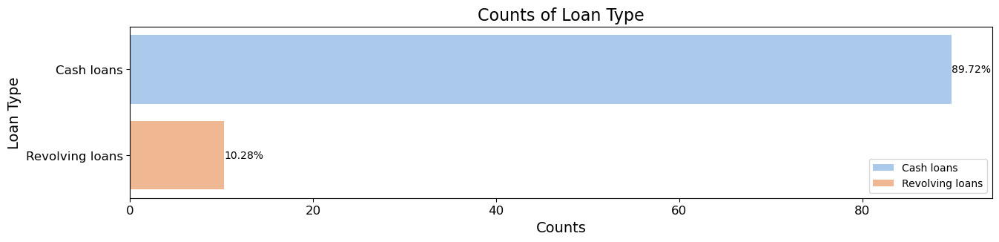

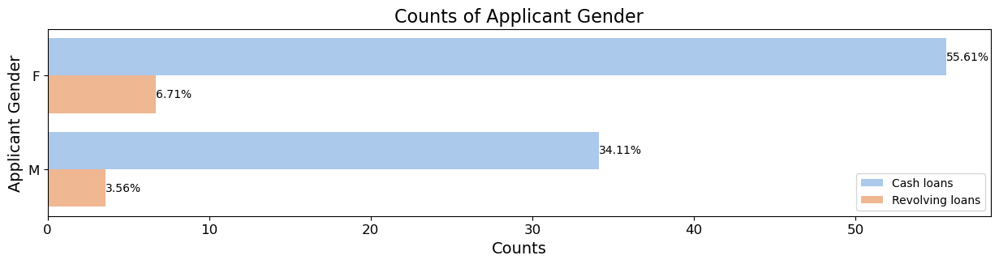

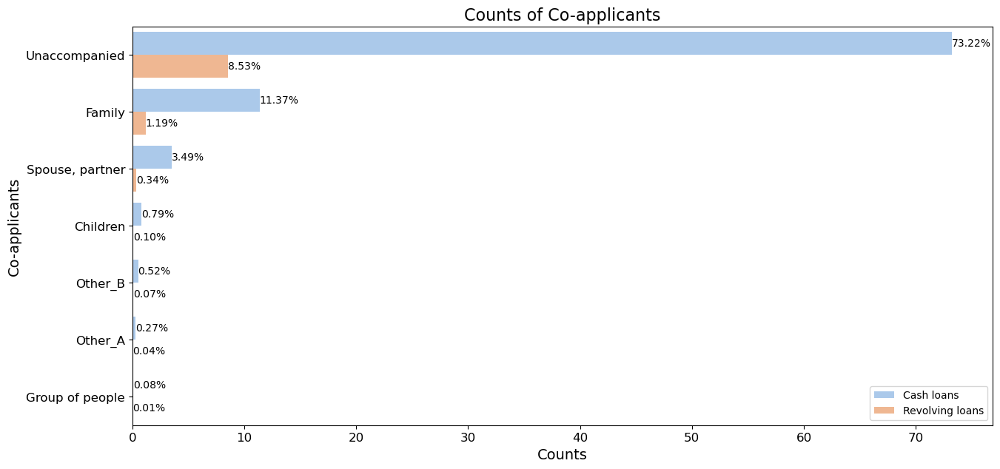

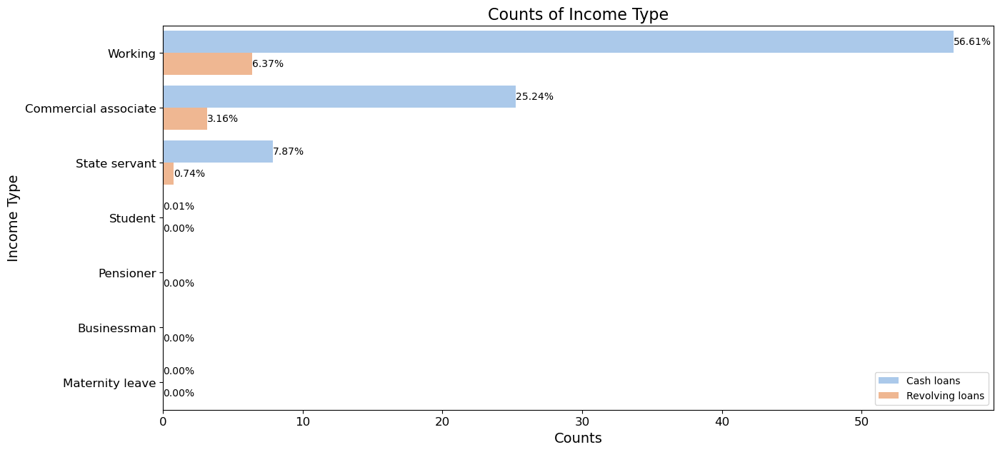

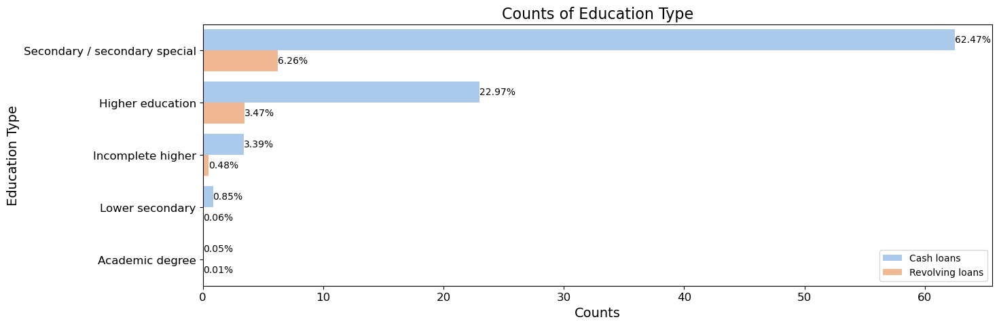

...

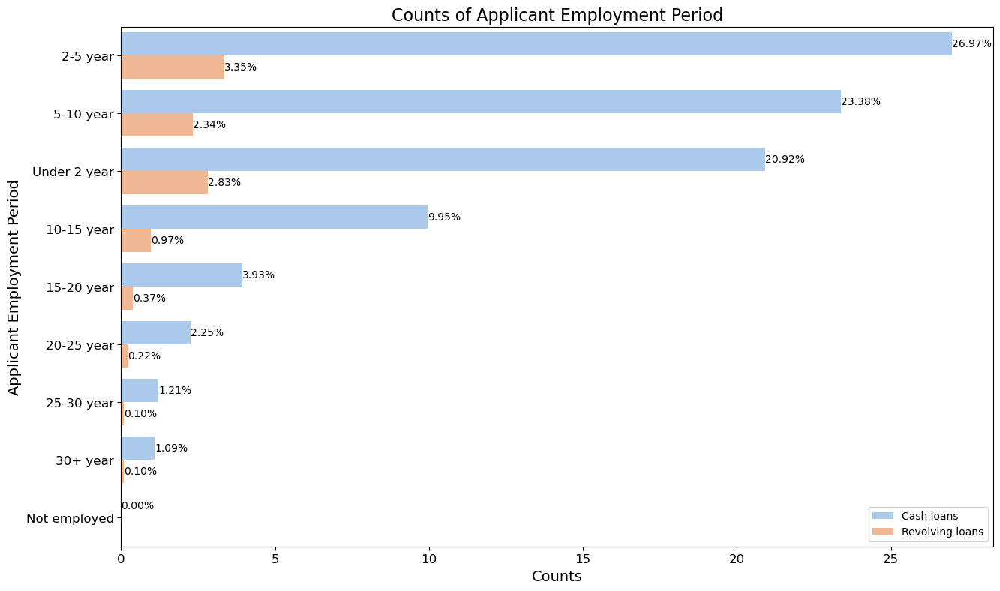

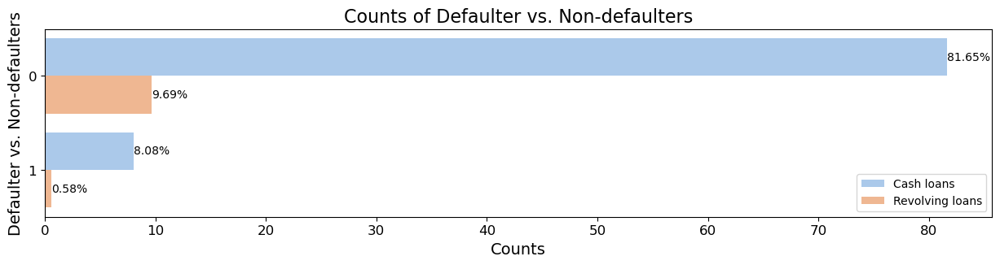

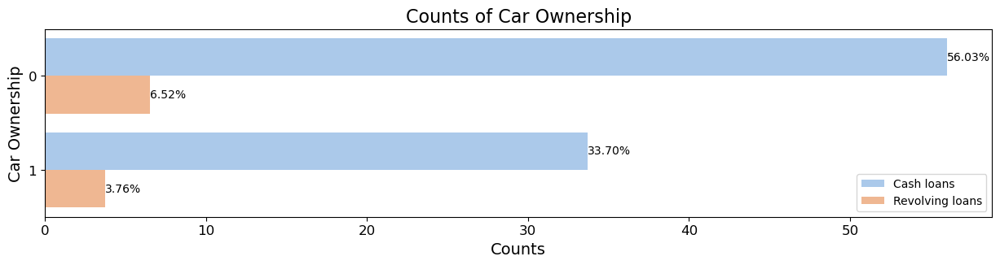

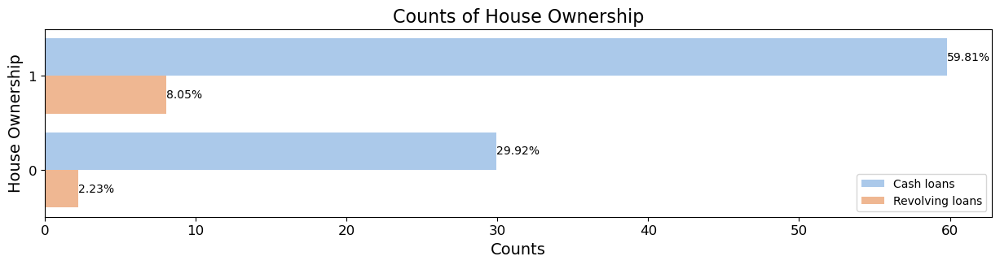

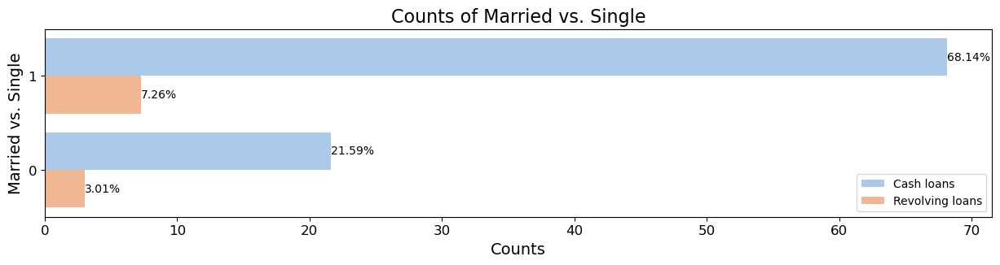

In [352]:
## CATEGORIAL vs. CATEGORIAL 
fcount_variable(df_app,df_app_cat,'NAME_CONTRACT_TYPE')

### **4. KEY VARIABLES CROSS ANALYSIS - PREVIOUS APPLICATION (Bivariate analysis)**

In [354]:
df_prev.columns

Index(['SK_ID_PREV', 'SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'AMT_ANNUITY',
       'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_GOODS_PRICE',
       'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START',
       'FLAG_LAST_APPL_PER_CONTRACT', 'NFLAG_LAST_APPL_IN_DAY',
       'NAME_CASH_LOAN_PURPOSE', 'NAME_CONTRACT_STATUS', 'DAYS_DECISION',
       'NAME_PAYMENT_TYPE', 'CODE_REJECT_REASON', 'NAME_CLIENT_TYPE',
       'NAME_GOODS_CATEGORY', 'NAME_PORTFOLIO', 'NAME_PRODUCT_TYPE',
       'CHANNEL_TYPE', 'SELLERPLACE_AREA', 'NAME_SELLER_INDUSTRY',
       'CNT_PAYMENT', 'NAME_YIELD_GROUP', 'PRODUCT_COMBINATION',
       'N_CREDIT_GOODS', 'N_CREDIT_APPLICATION', 'N_MONTH_DECISION',
       'N_CREDIT_RANGE', 'N_ANNUITY_RANGE', 'N_GOOD_PRICE_RANGE',
       'N_APPLICATION_RANGE', 'N_DECISION_RANGE'],
      dtype='object')

In [358]:
df_prev.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,N_CREDIT_GOODS,N_CREDIT_APPLICATION,N_MONTH_DECISION,N_CREDIT_RANGE,N_ANNUITY_RANGE,N_GOOD_PRICE_RANGE,N_APPLICATION_RANGE,N_DECISION_RANGE
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,17145.0,SATURDAY,15,1,1,XAP,Approved,-73,Cash through the bank,XAP,Repeater,Mobile,POS,Not Specified,Country-wide,35,Connectivity,Under 12m,middle,POS mobile with interest,100.000,100.000,2.43,0-200K,0-5k,Under 150K,Under 30K,1-3 month
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,607500.0,THURSDAY,11,1,1,Not Specified,Approved,-164,Not Specified,XAP,Repeater,Not Specified,Cash,x-sell,Contact center,-1,Not Specified,24-36m,low_action,Cash X-Sell: low,111.880,111.880,5.47,600-800K,25-35K,600-750K,180K+,3-6 month
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,112500.0,TUESDAY,11,1,1,Not Specified,Approved,-301,Cash through the bank,XAP,Repeater,Not Specified,Cash,x-sell,Credit and cash offices,-1,Not Specified,Under 12m,high,Cash X-Sell: high,121.284,121.284,10.03,0-200K,15-25K,Under 150K,90-120K,9-12 month
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,450000.0,MONDAY,7,1,1,Not Specified,Approved,-512,Cash through the bank,XAP,Repeater,Not Specified,Cash,x-sell,Credit and cash offices,-1,Not Specified,Under 12m,middle,Cash X-Sell: middle,104.620,104.620,17.07,400-600K,45K+,300-450K,180K+,1-2 year
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,337500.0,THURSDAY,9,1,1,Repairs,Refused,-781,Cash through the bank,HC,Repeater,Not Specified,Cash,walk-in,Credit and cash offices,-1,Not Specified,12-24m,high,Cash Street: high,119.720,119.720,26.03,400-600K,25-35K,300-450K,180K+,2-3 year


In [26]:
# Create a list of category data
df_prev_cat=[{'key': 'NAME_CONTRACT_TYPE', 'value': 'Loan Type'},
            {'key': 'NAME_CASH_LOAN_PURPOSE', 'value': 'Purpose of Cash Loan'},
            {'key': 'NAME_CONTRACT_STATUS', 'value': 'Contract Status'},
            {'key': 'NAME_PAYMENT_TYPE', 'value': 'Payment Type'},
            {'key': 'NAME_CLIENT_TYPE', 'value': 'Client Type'},
            {'key': 'NAME_GOODS_CATEGORY', 'value': 'Goods Category'},
            {'key': 'NAME_PORTFOLIO', 'value': 'Porfolio'},
            {'key': 'NAME_PRODUCT_TYPE', 'value': 'Marketing Product Type'},
            {'key': 'CHANNEL_TYPE', 'value': 'Marketing Channel Type'},
            {'key': 'NAME_YIELD_GROUP', 'value': 'Interest Rate Group'},
            {'key': 'N_PRODUCT_COMBINATION', 'value': 'Marketing Product Combination'},
            {'key': 'N_CREDIT_RANGE', 'value': 'Range of Given Credit'},
            {'key': 'N_ANNUITY_RANGE', 'value': 'Range of Annuity (Debts)'},
            {'key': 'N_GOOD_PRICE_RANGE', 'value': 'Range of Good Pricing'},
            {'key': 'N_APPLICATION_RANGE', 'value': 'Range of Applied Amount'},
            {'key': 'N_DECISION_RANGE', 'value': 'Range of Decision Periods'},
            ]

In [28]:
# Create a list of numberical data
df_prev_num=[{'key': 'AMT_ANNUITY', 'value': 'Amount of Annuity (Debt)'},
             {'key': 'AMT_APPLICATION', 'value': 'Amount of Applied Credit'},
             {'key': 'AMT_CREDIT', 'value': 'Amount of Given Credit'},
             {'key': 'AMT_GOODS_PRICE', 'value': 'Amount of Good Pricing'},
             {'key': 'N_CREDIT_GOODS', 'value': 'Ratio of Given Credit over Good Pricing'},
             {'key': 'N_CREDIT_APPLICATION', 'value': 'Ratio of Given Credit over Applied Amount'},
             {'key': 'N_MONTH_DECISION', 'value': 'Number of Previous Decision Months'},
            ]

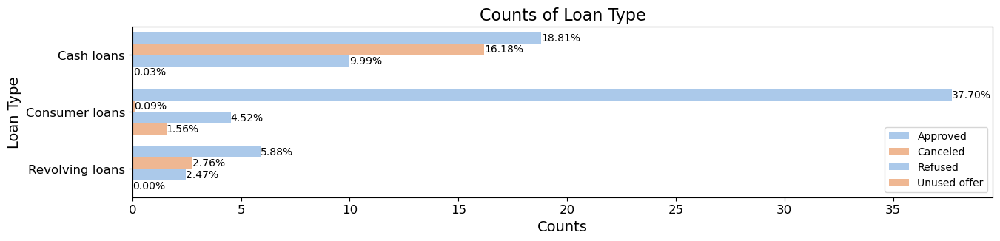

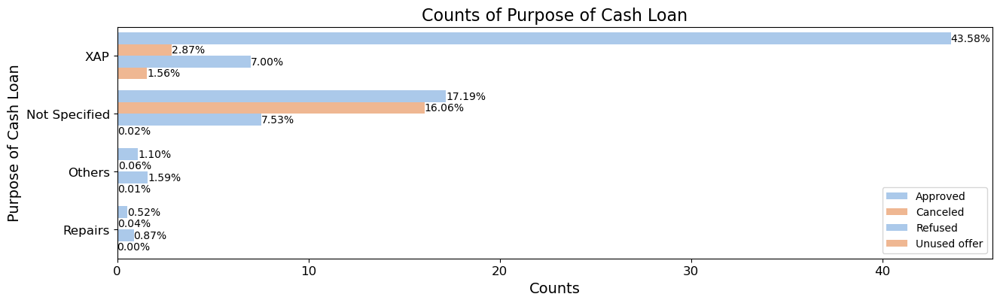

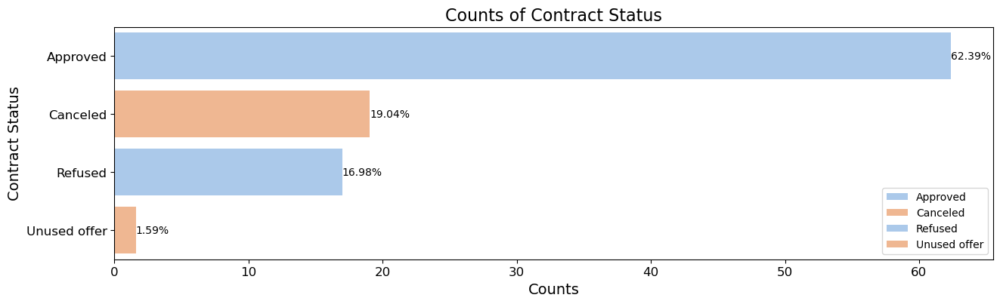

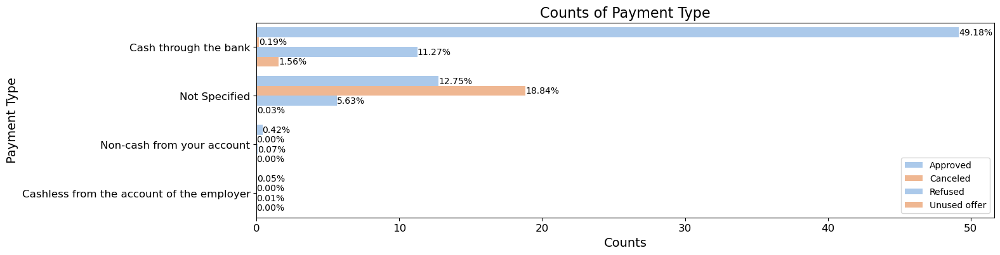

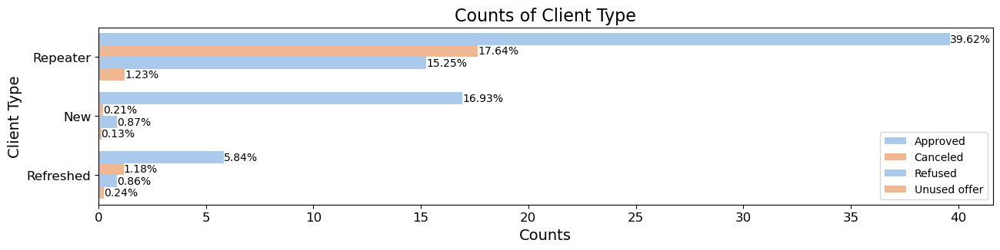

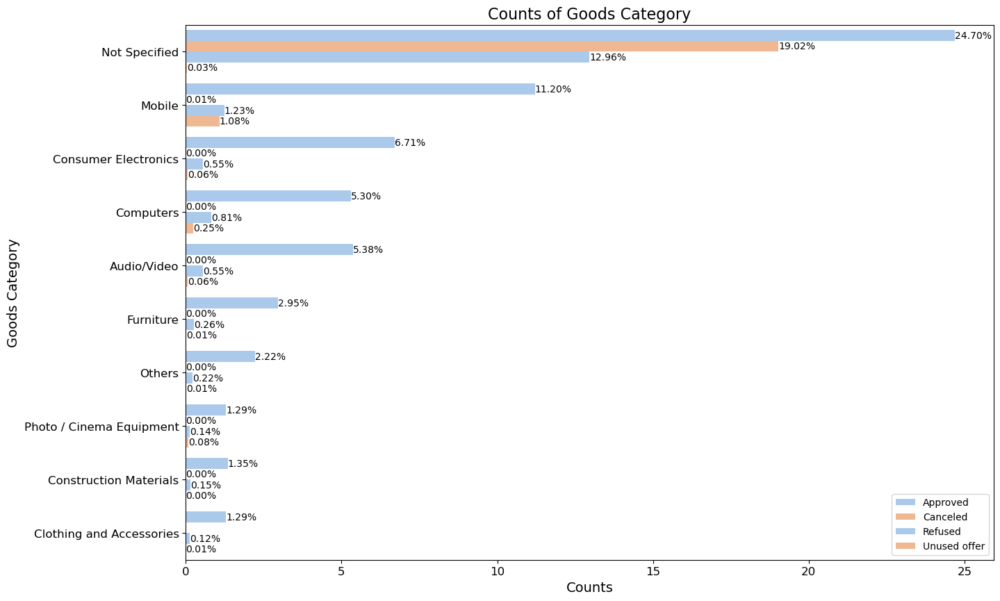

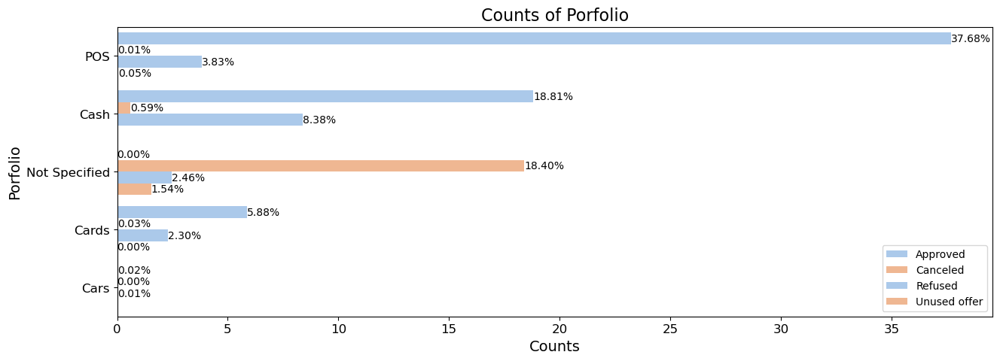

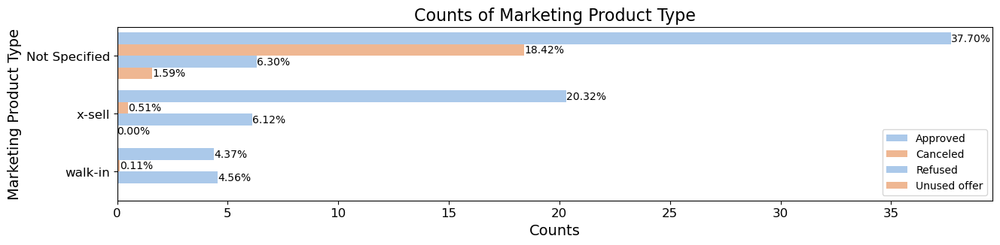

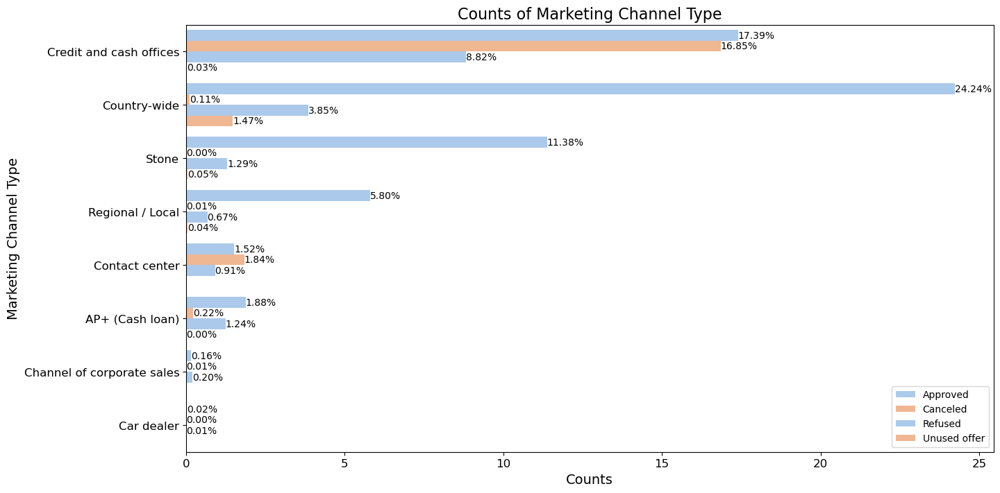

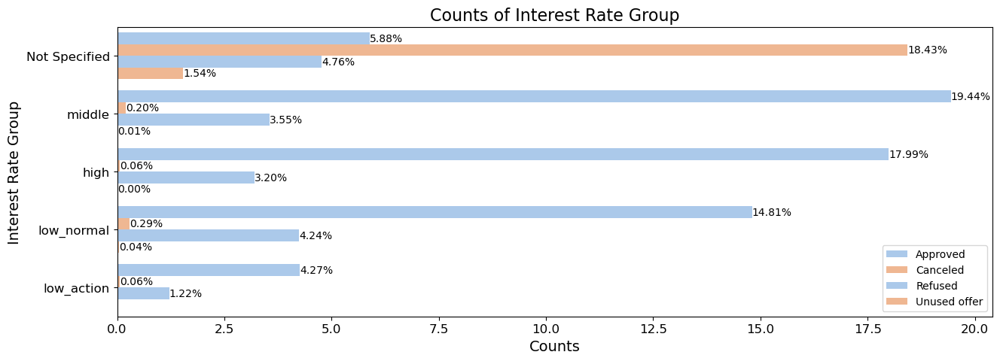

KeyError: 'N_PRODUCT_COMBINATION'

In [366]:
## CATEGORIAL vs. CATEGORIAL 
fcount_variable(df_prev,df_prev_cat,'NAME_CONTRACT_STATUS')

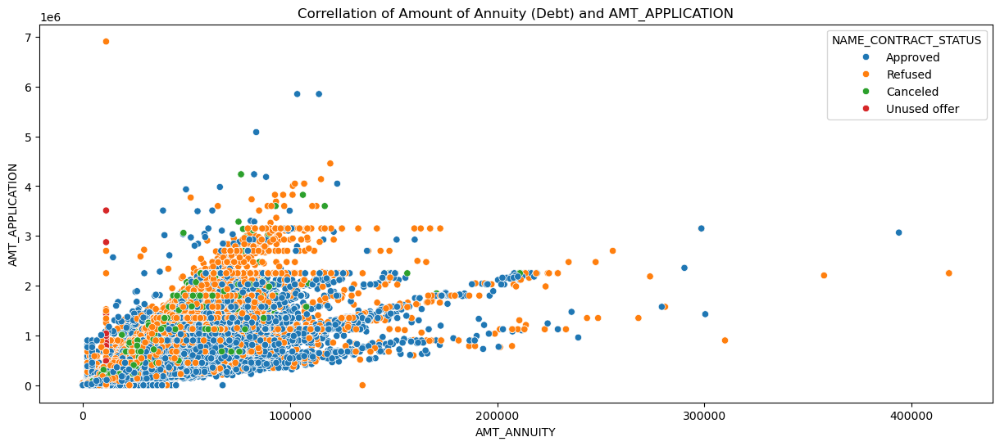

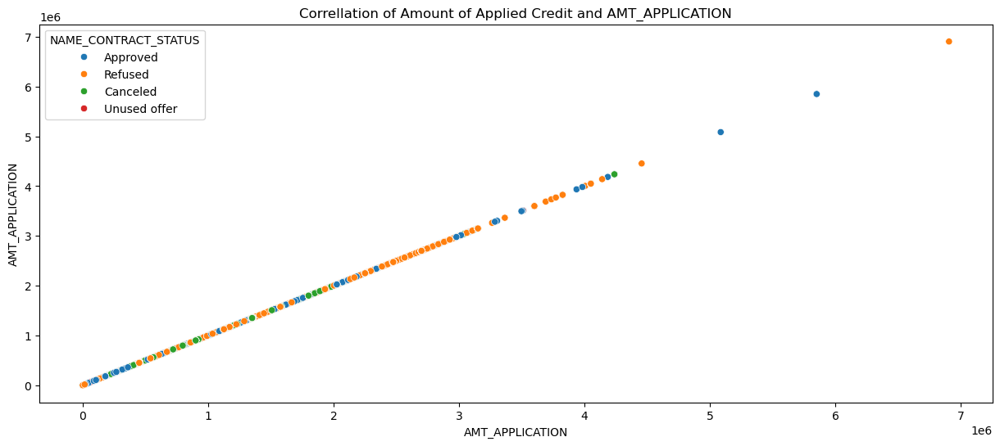

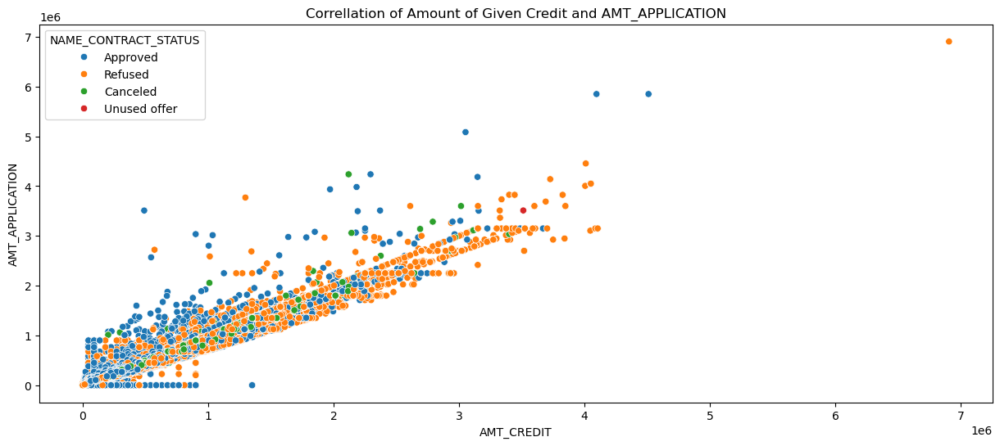

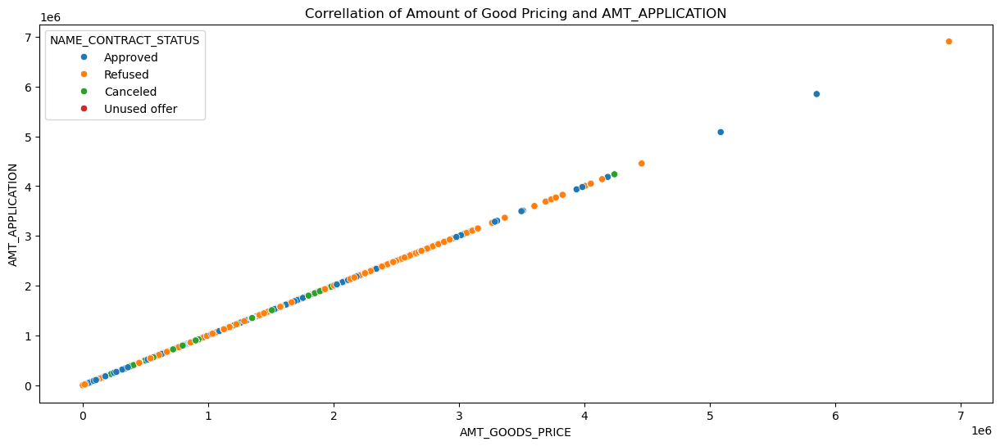

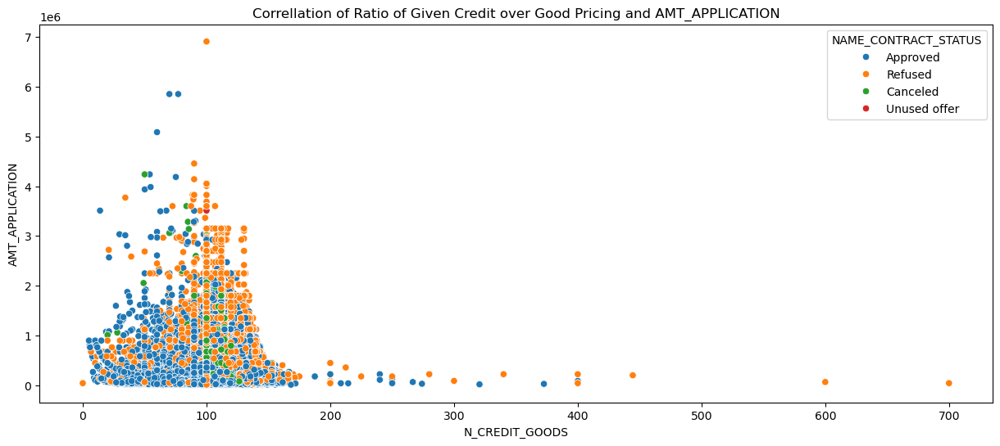

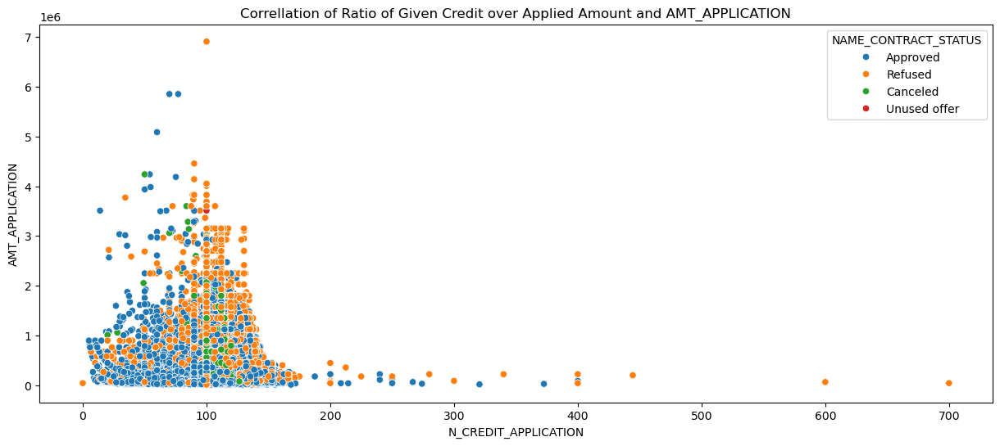

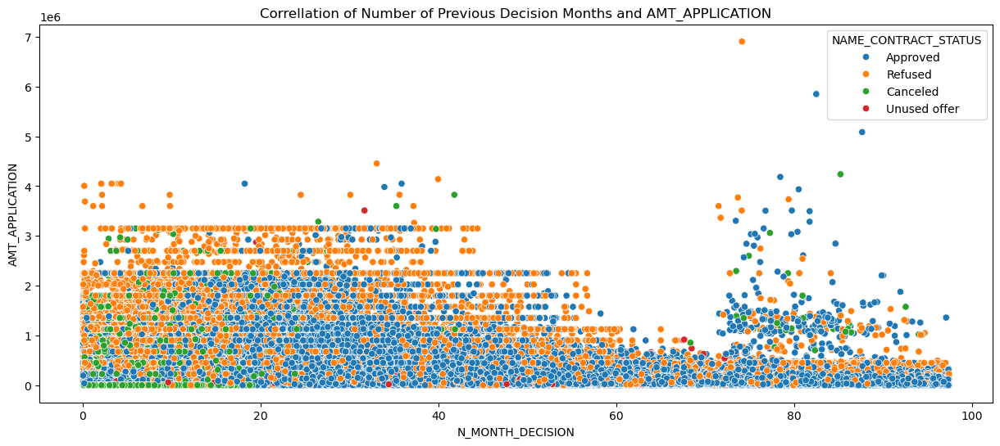

In [370]:
## NUMERICAL vs. NUMERICAL - 'AMT_APPLICATION'
fscatter_variable(df_prev,df_prev_num,'AMT_APPLICATION','NAME_CONTRACT_STATUS')

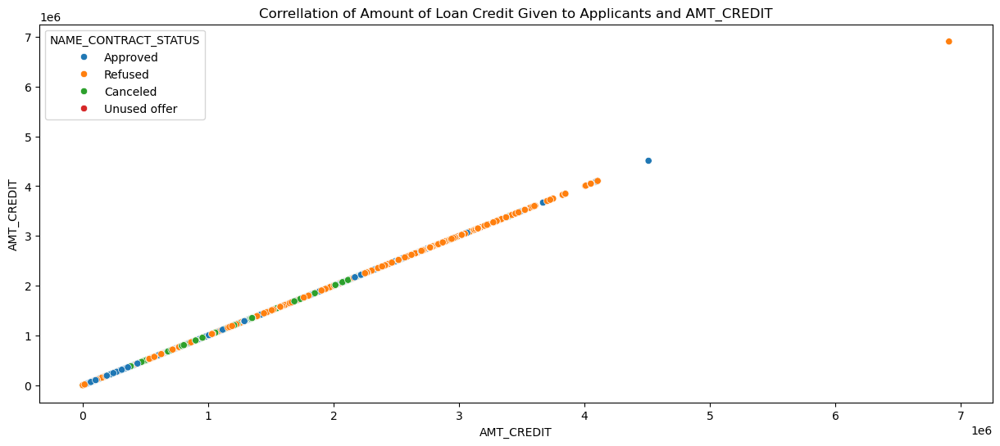

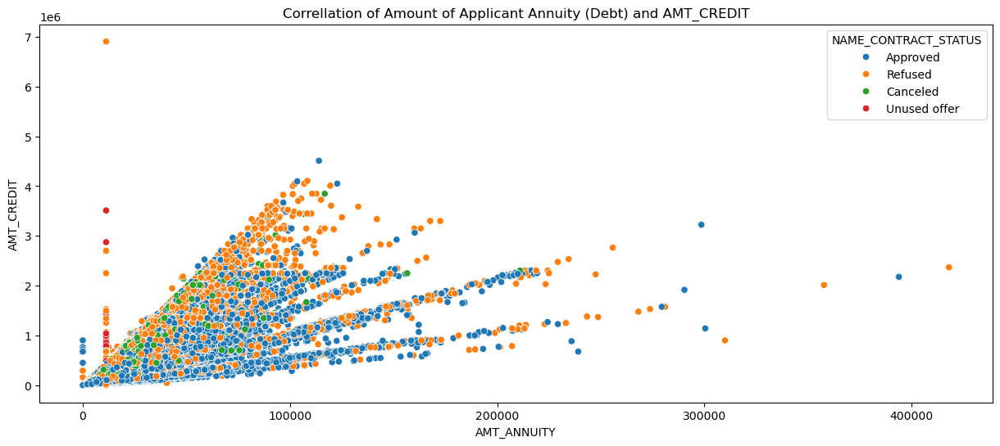

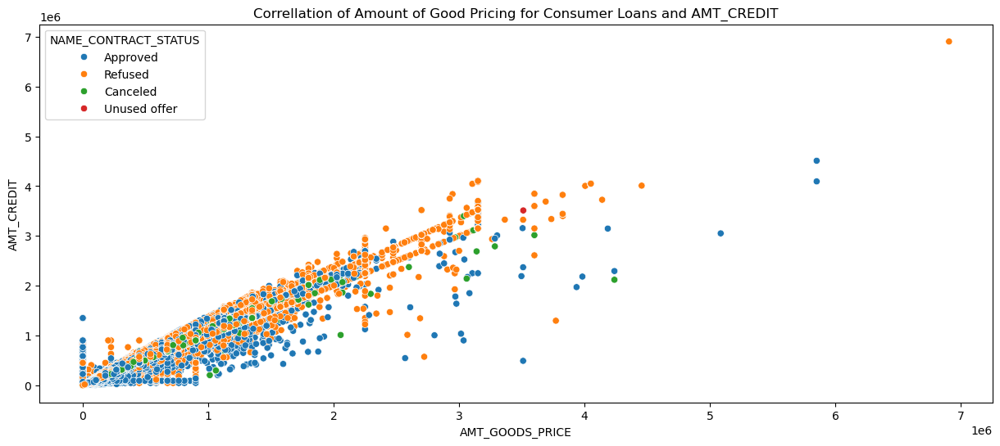

ValueError: Could not interpret value `N_CREDITSCORE` for `x`. An entry with this name does not appear in `data`.

<Figure size 1500x600 with 0 Axes>

In [544]:
## NUMERICAL vs. NUMERICAL - 'AMT_CREDIT'
fscatter_variable(prev,df_prev_num,'AMT_CREDIT','NAME_CONTRACT_STATUS')

In [ ]:
## NUMERICAL vs. NUMERICAL - 'AMT_GOODS_PRICE'
fscatter_variable(prev,df_prev_num,'AMT_GOODS_PRICE','NAME_CONTRACT_STATUS')

### **5. CORRELLATION WITH TARGET VARIABLE (Multivariate analysis)**

In [ ]:
# Correlation with TARGET VARIABLE from current application: 
# Correlation with CONTRACT STATUS from previsou application: 
# Chart types: heatmap 

#### **Function to plot multiple chart**

In [2]:
# HEATMAP OF Multiple Numerical DATA - Function to loop plotting heatmap
def fheatmap_variable(df,df_list, variable, hue):    
    for i in range(len(df_list)):
        # Create a figure size
        plt.figure(figsize=[15, 6])
        # Calculate the pivot table
        pivot_table=df.pivot_table(values=hue, index=df[df_list[i]['key']], columns=variable, aggfunc='mean')
        # Create the heatmap
        sns.heatmap(pivot_table, annot=True, cmap='coolwarm', fmt='.1f', 
                    cbar_kws={'label':variable})
        # Adding details to the map
        plt.title(f'Heatmap of {variable} by {df_list[i]['value']} and {hue}')
        plt.xlabel(hue, size=10)
        plt.ylabel(df_list[i]['value'], size=10)
        # Save fig
        plt.draw()
        plt.savefig(f'/Users/macbook/Desktop/SUVC/POST-GRAD/Assignment/{df_list[i]['key']}.png')
        plt.show()
        plt.close()

#### **Chart Plotting - Current Application**

In [386]:
df_app.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,CNT_FAM_MEMBERS,ORGANIZATION_TYPE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,N_CREDITSCORE,N_TOTAL_CREDIT_BUREAU,N_3M_CREDIT_BUREAU,N_MARRIED,N_DEPENDENT,N_CREDIT_GOODS,N_YEARS_BIRTH,N_YEARS_EMPLOYED,N_INCOME_RANGE,N_CREDIT_RANGE,N_ANNUITY_RANGE,N_GOOD_PRICE_RANGE,N_AGE_RANGE,N_EMPLOYMENT_RANGE,TARGET LABEL
0,100002,1,Cash loans,M,0,1,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,-9461,-637,1,Business Entity,2,2,2,2,0.161787,1,0,0,0,115.839744,25.92,1.75,200-250K,400-600K,15-25K,300-450K,21-30,Under 2 year,Defaulters
1,100003,0,Cash loans,F,0,0,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,-16765,-1188,2,School,1,0,1,0,0.466757,0,0,1,1,114.519920,45.93,3.25,250K+,1000K+,35-45K,750K+,40-50,2-5 year,Non-defaulters
2,100004,0,Revolving loans,M,1,1,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,-19046,-225,1,Government,0,0,0,0,0.642739,0,0,0,0,100.000000,52.18,0.62,50-100K,0-200K,5-15K,Under 150K,50-60,Under 2 year,Non-defaulters
3,100006,0,Cash loans,F,0,1,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,-19005,-3039,2,Business Entity,2,0,2,0,0.650442,0,0,1,1,105.280303,52.07,8.33,100-150K,200-400K,25-35K,150-300K,50-60,5-10 year,Non-defaulters
4,100007,0,Cash loans,M,0,1,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,-19932,-3038,1,Others,0,0,0,0,0.322738,0,0,0,0,100.000000,54.61,8.32,100-150K,400-600K,15-25K,450-600K,50-60,5-10 year,Non-defaulters


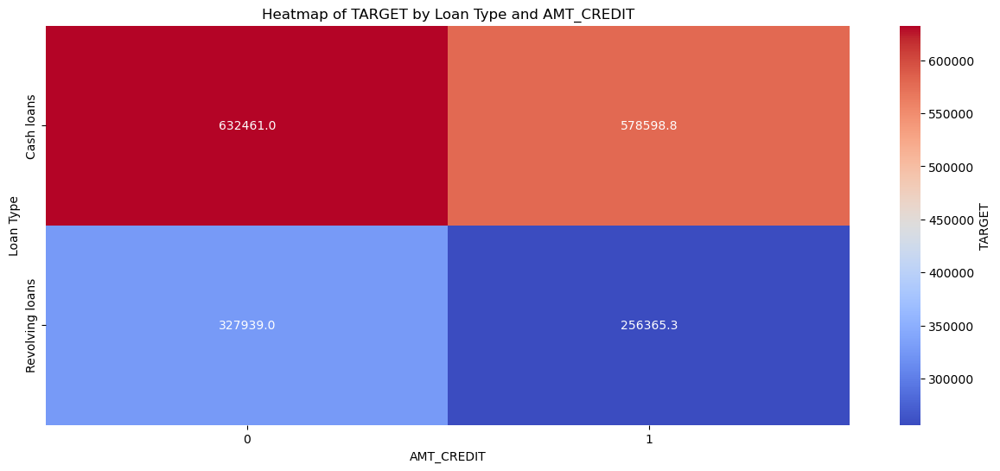

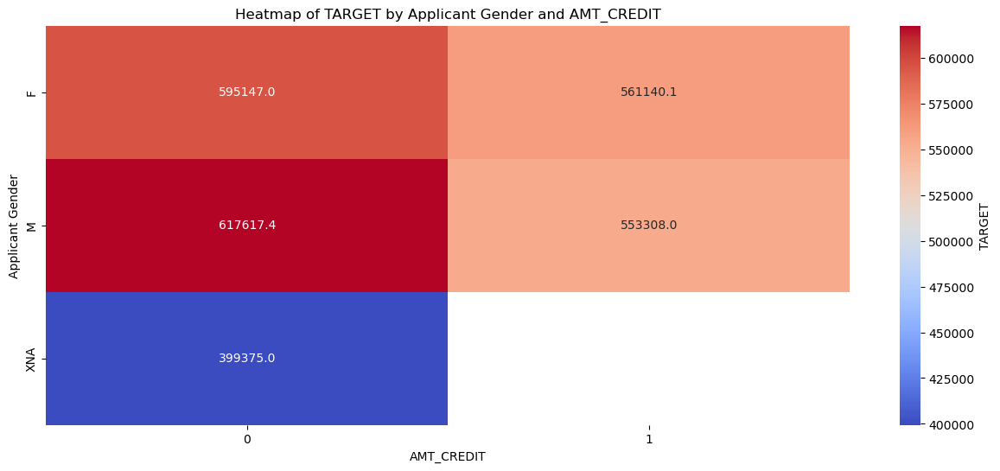

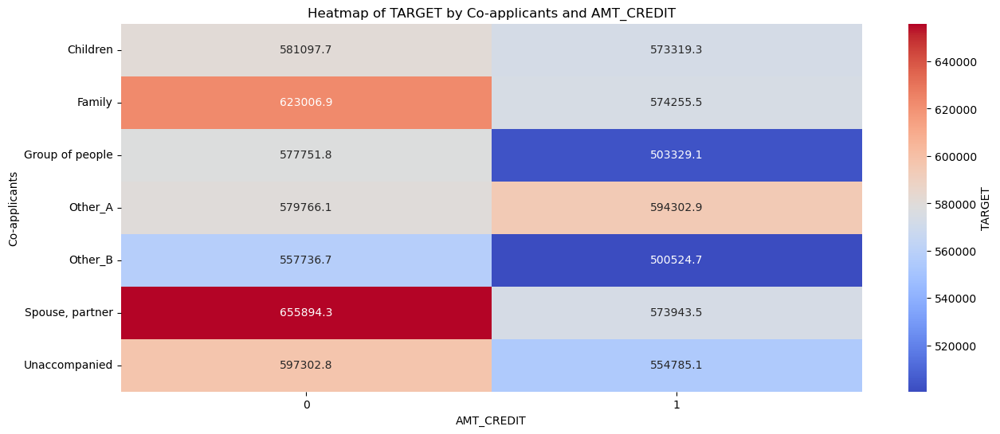

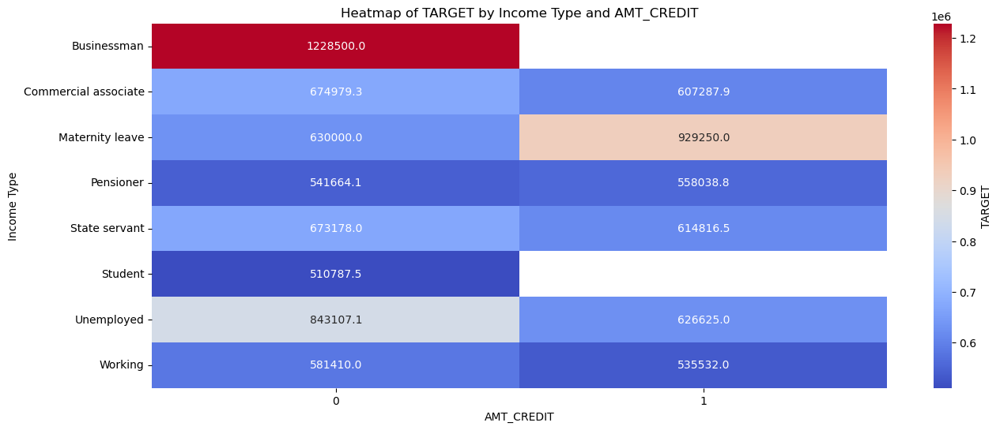

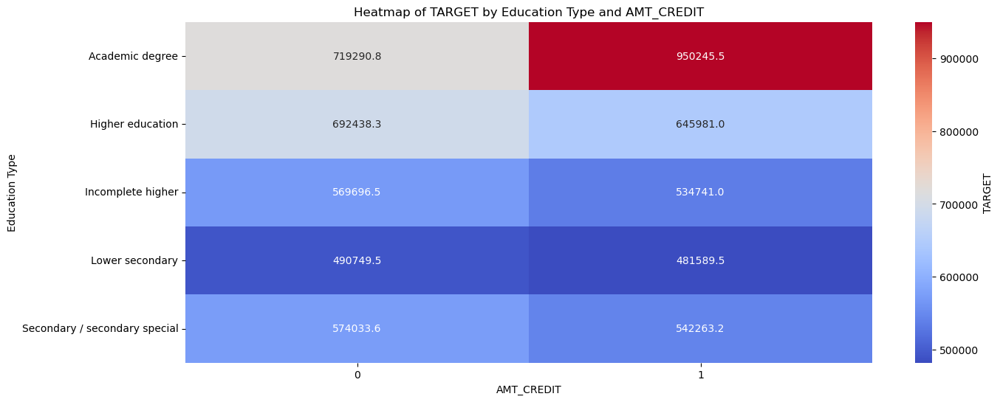

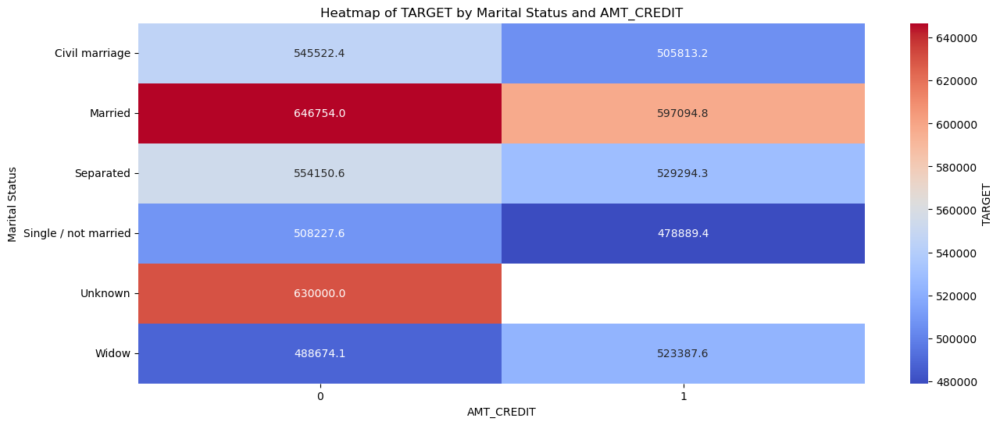

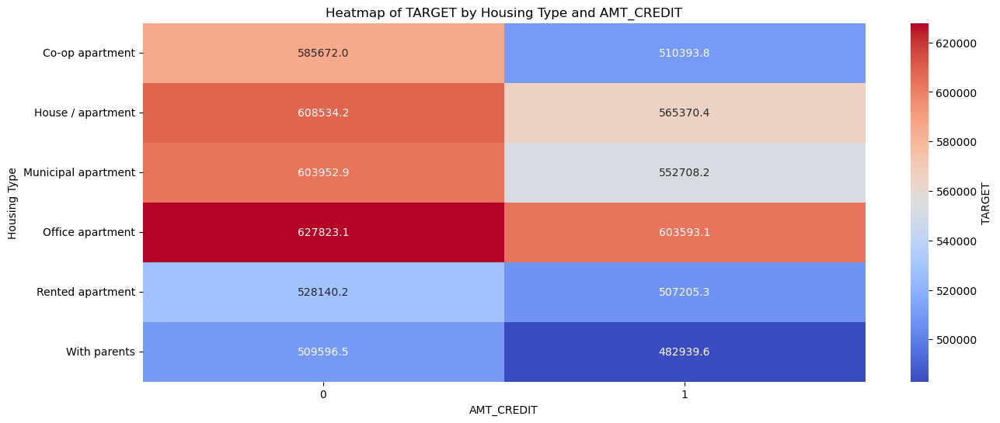

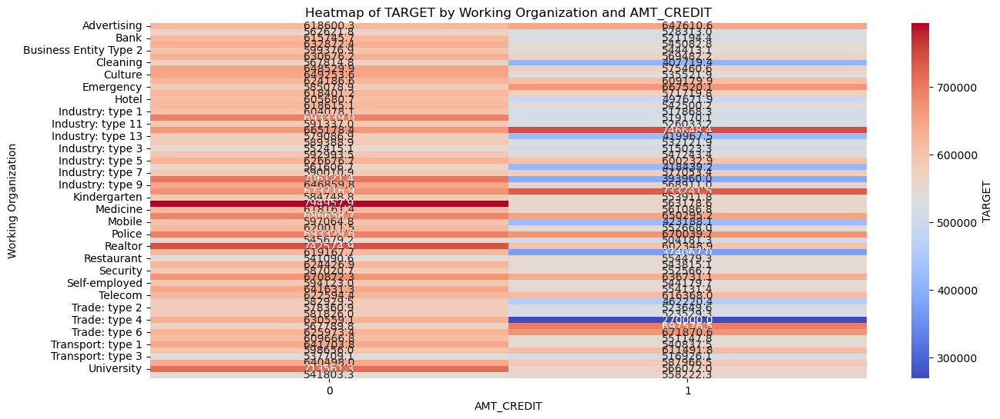

KeyError: 'N_INCOME_RANGE'

<Figure size 1500x600 with 0 Axes>

In [20]:
## NUMERICAL vs. NUMERICAL - ''
fheatmap_variable(df_app,df_app_cat,'TARGET','AMT_CREDIT')

#### **Chart Plotting - Previous Application**

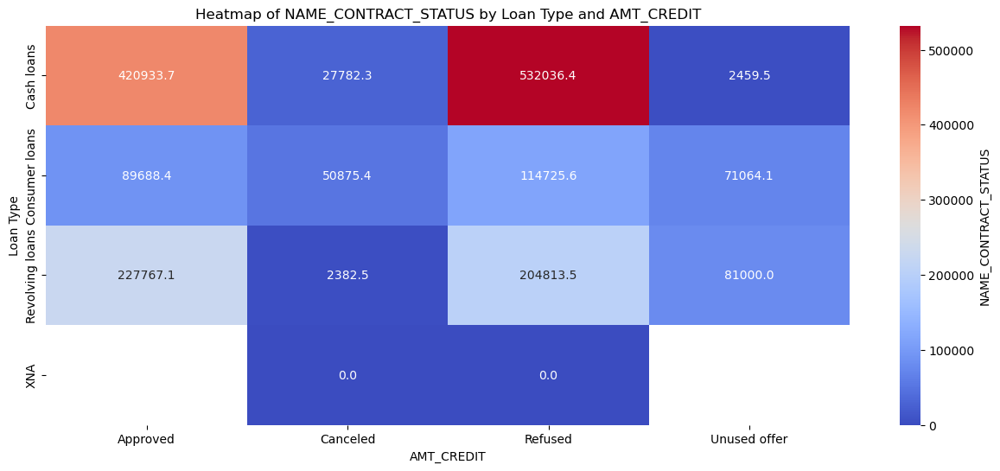

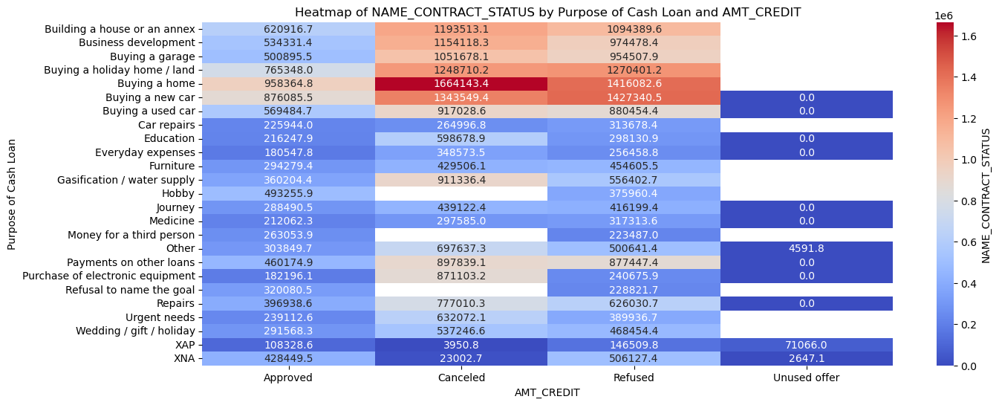

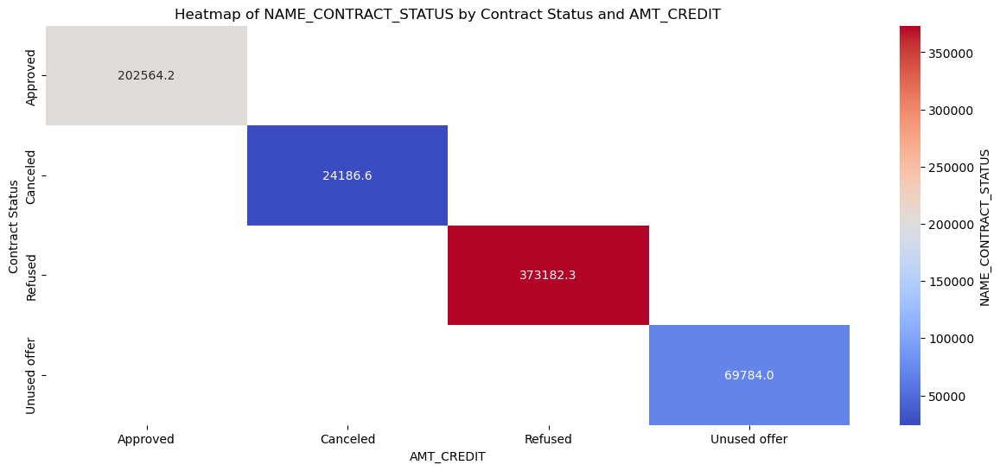

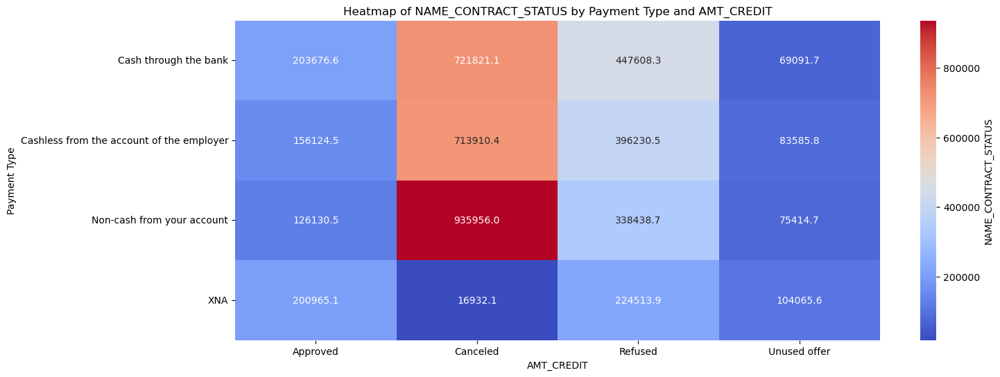

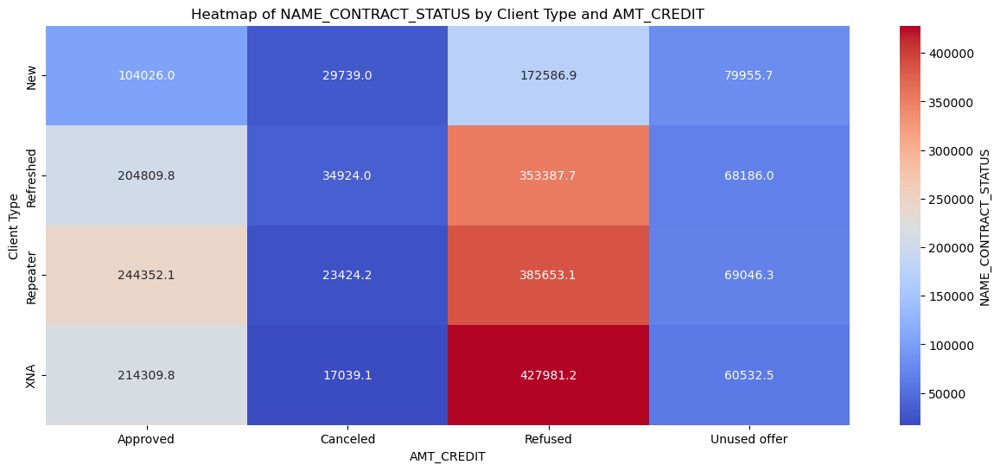

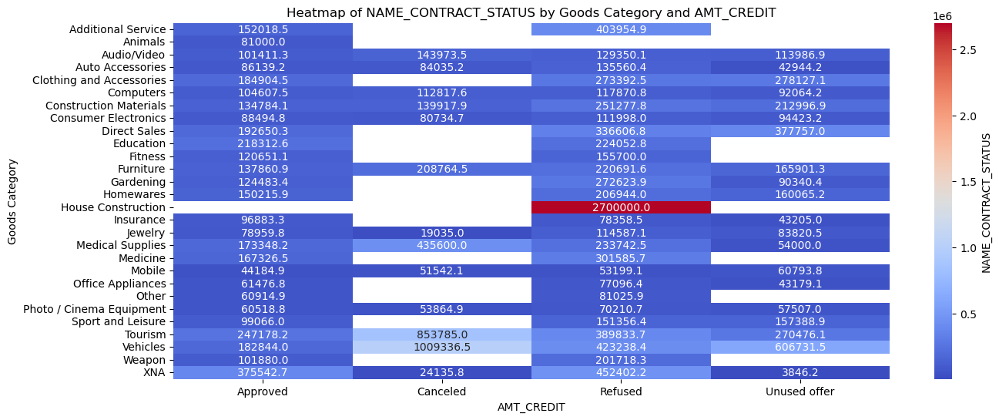

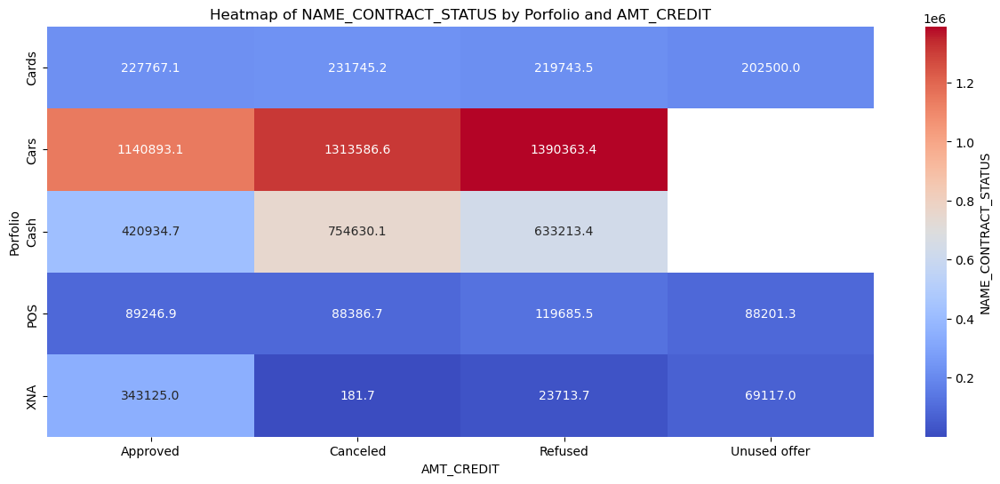

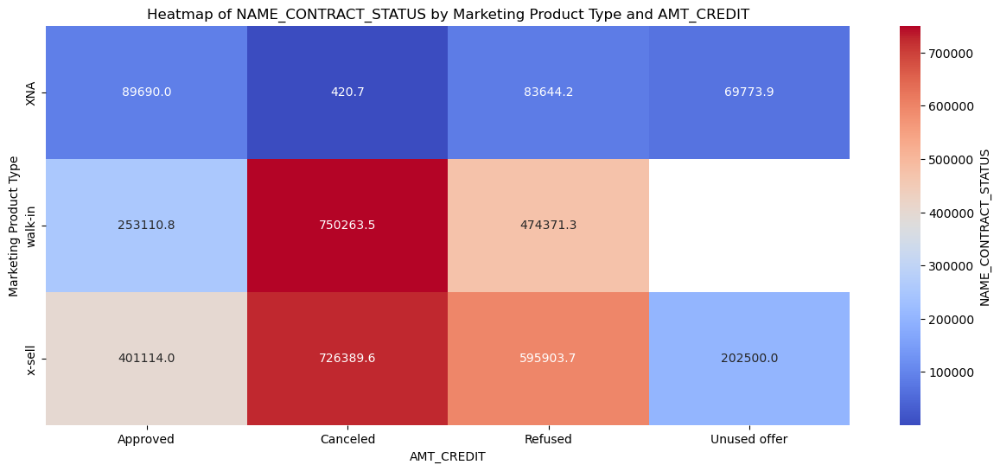

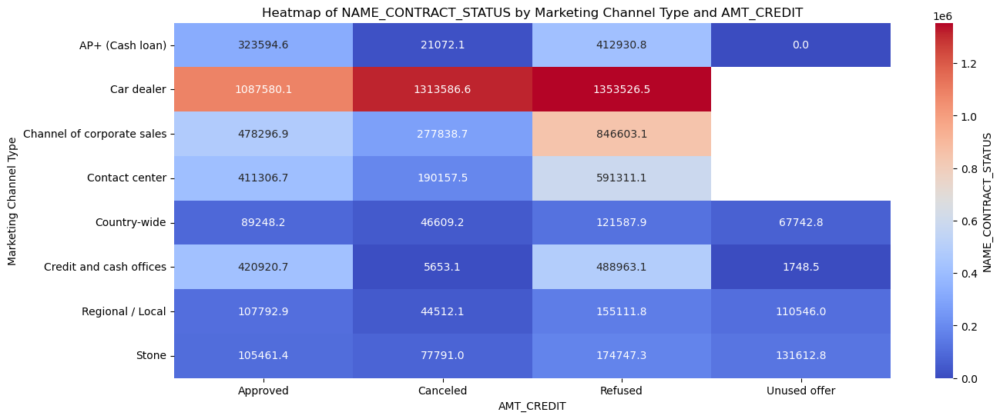

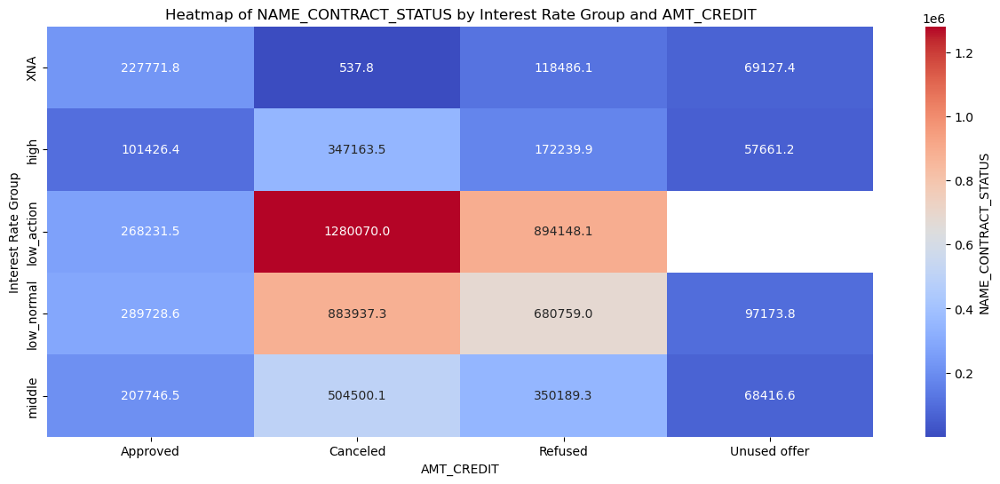

KeyError: 'N_PRODUCT_COMBINATION'

<Figure size 1500x600 with 0 Axes>

In [30]:
## NUMERICAL vs. NUMERICAL - 'AMT_ANNUITY'
fheatmap_variable(df_prev,df_prev_cat,'NAME_CONTRACT_STATUS','AMT_CREDIT')